In [1]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)


In [2]:
import os
import cv2
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from tensorflow import keras
from tensorflow.keras import layers
from xml.etree import ElementTree as ET
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV

In [3]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  0


In [4]:
# Define paths
data_dir = "./colorful_fashion_dataset_for_object_detection"
annotations_dir = os.path.join(data_dir, "Annotations")
images_dir = os.path.join(data_dir, "JPEGImages")

# Function to draw bounding boxes and labels for a single object
def draw_bbox_and_label(image, label, bbox):
    cv2.rectangle(image, (bbox[0], bbox[1]), (bbox[2], bbox[3]), (255, 0, 0), 1)  # Red color
    cv2.putText(image, label, (bbox[0], bbox[1] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0, 255, 0), 1)  # Red color

# Function to draw bounding boxes and labels for multiple objects
def draw_bboxes_and_labels(image, annotations, resize_factor_x, resize_factor_y):
    for annotation in annotations:
        label = annotation.find("name").text
        bbox = [
            int(float(annotation.find("bndbox").find("xmin").text) * resize_factor_x),
            int(float(annotation.find("bndbox").find("ymin").text) * resize_factor_y),
            int(float(annotation.find("bndbox").find("xmax").text) * resize_factor_x),
            int(float(annotation.find("bndbox").find("ymax").text) * resize_factor_y),
        ]
        draw_bbox_and_label(image, label, bbox)

# Initialize lists to store images and annotations
images = []
annotations = []

# Load annotations and corresponding images
for filename in os.listdir(images_dir):
    if filename.endswith(".jpg"):
        image_path = os.path.join(images_dir, filename)

        # Parse image filename to get the image number
        image_number = os.path.splitext(filename)[0]

        # Find the corresponding XML file for the image
        xml_file = f"{image_number}.xml"
        xml_path = os.path.join(annotations_dir, xml_file)

        if os.path.exists(xml_path):
            # Parse XML annotations
            tree = ET.parse(xml_path)
            root = tree.getroot()
            annotations_for_image = root.findall("object")

            # Load image as a numpy array
            img = cv2.imread(image_path)

            # Check if the image is loaded successfully
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # OpenCV uses BGR by default
                images.append(img)
                annotations.append(annotations_for_image)
            else:
                print(f"Error loading image: {image_path}")
        else:
            print(f"XML file not found for image: {image_number}")

# Print the counts and names of loaded and failed images
print(f"Number of successfully loaded images: {len(images)}")
print(f"Number of failed images: {len(os.listdir(images_dir)) - len(images)}")

Number of successfully loaded images: 2682
Number of failed images: 0


In [5]:
# Convert to NumPy array
X = np.array(images)

# Resize images to a consistent size
image_size = (224, 224)
images_resized = [cv2.resize(img, image_size) for img in images]

# Convert class labels to one-hot encoding
unique_classes = sorted(list(set(label.find("name").text for sublist in annotations for label in sublist)))
class_to_index = {cls: i for i, cls in enumerate(unique_classes)}

def convert_to_one_hot(labels, class_to_index):
    num_classes = len(class_to_index)
    one_hot_labels = np.zeros((len(labels), num_classes), dtype=np.float32)
    for i, class_label in enumerate(labels):
        for cls in class_label:
            one_hot_labels[i, class_to_index[cls.find("name").text]] = 1
    return one_hot_labels

# Split the data into training and testing sets
annotations_train, annotations_test, images_train, images_test = train_test_split(
    annotations, images_resized, test_size=0.2, random_state=42
)

# Convert training and testing labels to one-hot encoding
y_train_one_hot = convert_to_one_hot(annotations_train, class_to_index)
y_test_one_hot = convert_to_one_hot(annotations_test, class_to_index)


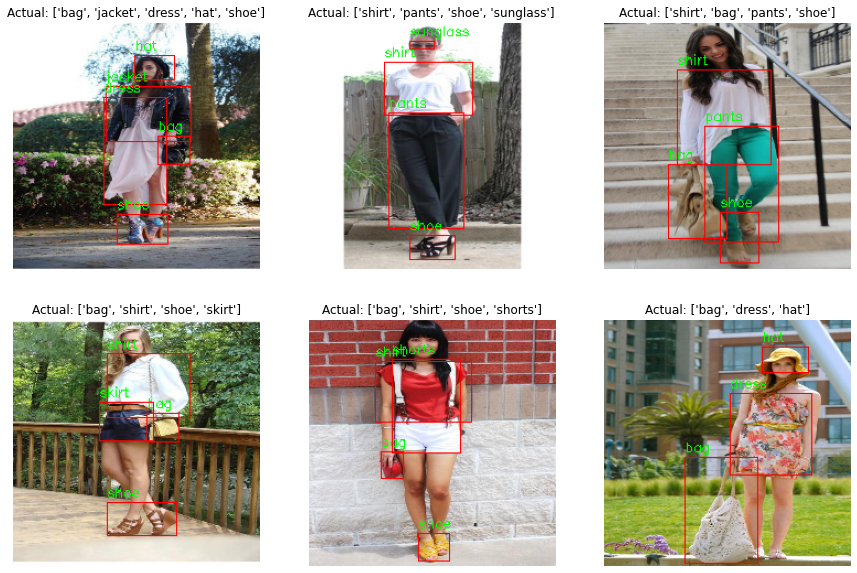

In [6]:
# Resize images to a consistent size
original_image_size = (400, 600)  # replace with the original size of your images
image_size = (224, 224)
images_resized = [cv2.resize(img, image_size) for img in images]

# Visualize random images with bounding boxes and labels
num_samples_to_visualize = 6
random_indices = np.random.choice(len(images_test), num_samples_to_visualize, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(random_indices, 1):
    img = images_test[idx].copy()
    annotations_for_image = annotations_test[idx]

    # Calculate resize factors
    resize_factor_x = image_size[0] / original_image_size[0]
    resize_factor_y = image_size[1] / original_image_size[1]

    # Draw bounding boxes and labels for multiple objects
    draw_bboxes_and_labels(img, annotations_for_image, resize_factor_x, resize_factor_y)

    plt.subplot(2, 3, i)
    plt.imshow(img)
    plt.title(f"Actual: {[annotation.find('name').text for annotation in annotations_for_image]}")
    plt.axis("off")

plt.show()

In [7]:
# Set the number of classes
num_classes = len(unique_classes)

In [8]:
# Convert to NumPy array
X_train = np.array(images_train)
X_test = np.array(images_test)

In [9]:
# Optimized model architecture
def create_model():
    model = keras.Sequential([
        layers.Conv2D(64, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(256, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.Dense(num_classes, activation='softmax')
    ])
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model


In [10]:
# Compile the model
model = create_model()  # Use the optimal parameters found in grid search
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [11]:
# Train the model
history = model.fit(X_train, y_train_one_hot, epochs=50, batch_size=64, validation_data=(X_test, y_test_one_hot))

Epoch 1/50
34/34 [==============================] - 83s 2s/step - loss: 197522000.0000 - accuracy: 0.1249 - val_loss: 1295841536.0000 - val_accuracy: 0.1415
Epoch 2/50
34/34 [==============================] - 95s 3s/step - loss: 7674045440.0000 - accuracy: 0.1580 - val_loss: 27546687488.0000 - val_accuracy: 0.0931
Epoch 3/50
34/34 [==============================] - 98s 3s/step - loss: 127843409920.0000 - accuracy: 0.1063 - val_loss: 316356362240.0000 - val_accuracy: 0.5587
Epoch 4/50
34/34 [==============================] - 98s 3s/step - loss: 669798825984.0000 - accuracy: 0.1217 - val_loss: 1790357012480.0000 - val_accuracy: 0.0000e+00
Epoch 5/50
34/34 [==============================] - 97s 3s/step - loss: 4221617569792.0000 - accuracy: 0.1063 - val_loss: 6028112953344.0000 - val_accuracy: 0.5587
Epoch 6/50
34/34 [==============================] - 101s 3s/step - loss: 9620582039552.0000 - accuracy: 0.1189 - val_loss: 22456421056512.0000 - val_accuracy: 0.0000e+00
Epoch 7/50
34/34 [===

#### Object detection base model training observations : 

Loss and Accuracy Metrics: The training loss (loss) and accuracy (accuracy) show considerable instability and high values. This explains that the model is struggling to converge or learn meaningful patterns.
The validation loss (val_loss) and accuracy (val_accuracy) also exhibit instability and are not improving over epochs.

Data Imbalance: There seems to be a significant class imbalance issue, especially evident in the validation accuracy. The accuracy for classifying the minority class (or classes) is low.
Scale of Loss:

The scale of the loss values is extremely high, reaching trillions. This could indicate issues with the learning rate or the choice of loss function.

Learning Rate: The learning rate could be too high or too low. Experimenting with different learning rates may help stabilize the training.

Evaluation of Recommendations: the model is not making meaningful predictions.

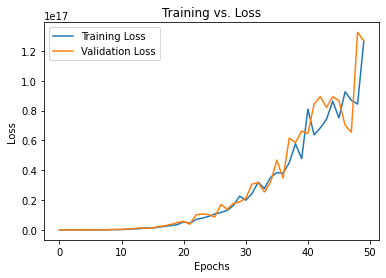

In [12]:
# Plot training vs. loss graph
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training vs. Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [13]:
# Evaluate the model on the test set
loss, accuracy = model.evaluate(X_test, y_test_one_hot)
print(f"Optimized Model Test Loss: {loss:.4f}")
print(f"Optimized Model Test Accuracy: {accuracy * 100:.2f}%")


17/17 [==============================] - 6s 330ms/step - loss: 126817980385329152.0000 - accuracy: 0.0019
Optimized Model Test Loss: 126817980385329152.0000
Optimized Model Test Accuracy: 0.19%


In [14]:
# Make predictions on the test set
predictions = model.predict(X_test)

17/17 [==============================] - 6s 325ms/step


In [15]:
# Function to draw bounding boxes and labels for multiple objects
def draw_bboxes_and_labels(image, annotations, resize_factor_x, resize_factor_y):
    for annotation in annotations:
        label = annotation.find("name").text
        bbox = [
            int(float(annotation.find("bndbox").find("xmin").text) * resize_factor_x),
            int(float(annotation.find("bndbox").find("ymin").text) * resize_factor_y),
            int(float(annotation.find("bndbox").find("xmax").text) * resize_factor_x),
            int(float(annotation.find("bndbox").find("ymax").text) * resize_factor_y),
        ]
        draw_bbox_and_label(image, label, bbox, (0, 255, 255))  # Use yellow color (0, 255, 255)




In [16]:
# Function to draw bounding boxes and labels for a single object
def draw_bbox_and_label(image, label, bbox, color):
    cv2.rectangle(image, (bbox[0], bbox[1]), (bbox[2], bbox[3]), color, 1)
    cv2.putText(image, label, (bbox[0], bbox[1] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.4, color, 1)

# Extract class names from unique_classes
class_list = [cls for cls in unique_classes]

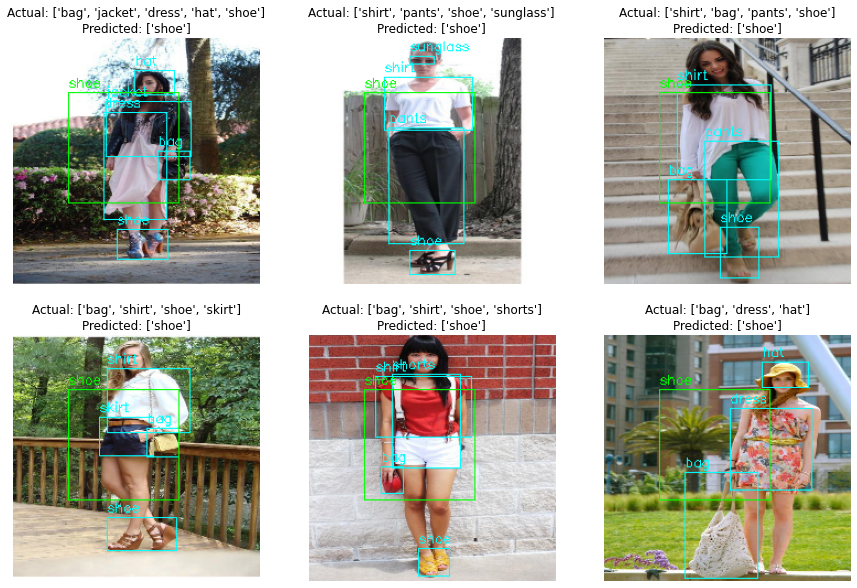

In [17]:
   
# Visualize random images with both actual and predicted bounding boxes
plt.figure(figsize=(15, 10))
for i, idx in enumerate(random_indices, 1):
    img = images_test[idx].copy()
    annotations_for_image = annotations_test[idx]
    predicted_labels = [class_list[i] for i in range(num_classes) if predictions[idx][i] > 0.5]

    # Calculate resize factors
    resize_factor_x = image_size[0] / original_image_size[0]
    resize_factor_y = image_size[1] / original_image_size[1]

    # Draw actual bounding boxes and labels in green
    draw_bboxes_and_labels(img, annotations_for_image, resize_factor_x, resize_factor_y)

    # Draw predicted bounding boxes and labels in green
    for label in predicted_labels:
        bbox = [50, 50, 150, 150]  # Replace with the predicted bounding box coordinates
        draw_bbox_and_label(img, label, bbox, (0, 255, 0))  # Use green color (0, 255, 0)

    plt.subplot(2, 3, i)
    plt.imshow(img)
    plt.title(f"Actual: {[annotation.find('name').text for annotation in annotations_for_image]}\n"
              f"Predicted: {predicted_labels}")
    plt.axis("off")

plt.show()


### Data Augmentation

In [18]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay


In [19]:
# Data Augmentation
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

In [20]:
def create_augmented_model(num_classes):
    model = keras.Sequential([
        layers.Conv2D(64, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(256, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.Dense(num_classes, activation='softmax')
    ])
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model


In [21]:
# Apply data augmentation to training set
augmented_images = []
augmented_annotations = []
for img, labels in zip(X_train, y_train_one_hot):
    img = np.expand_dims(img, 0)
    for batch in datagen.flow(img, batch_size=1):
        augmented_images.append(batch[0])
        augmented_annotations.append(labels)
        break


In [22]:
def convert_to_one_hot(labels, class_to_index):
    if isinstance(labels[0], np.ndarray):  # Check if the input is a NumPy array
        num_classes = len(class_to_index)
        one_hot_labels = np.zeros((len(labels), num_classes), dtype=np.float32)
        for i, class_label in enumerate(labels):
            for cls_idx in class_label.nonzero()[0]:
                one_hot_labels[i, cls_idx] = 1
        return one_hot_labels
    else:  # If it's a list of labels
        num_classes = len(class_to_index)
        one_hot_labels = np.zeros((len(labels), num_classes), dtype=np.float32)
        for i, class_label in enumerate(labels):
            one_hot_labels[i, class_to_index[class_label.find("name").text]] = 1
        return one_hot_labels



In [23]:
# Concatenate original and augmented data
X_train_augmented = np.concatenate((X_train, np.array(augmented_images)))
y_train_augmented = np.vstack((y_train_one_hot, np.array(augmented_annotations)))

# Convert augmented training labels to one-hot encoding
y_train_augmented_one_hot = convert_to_one_hot(y_train_augmented, class_to_index)


In [24]:
# Normalize input data
X_train_augmented_normalized = X_train_augmented / 255.0
X_test_normalized = X_test / 255.0

# Compile the model with augmented data
model_augmented = create_augmented_model(num_classes)  # Use the optimal parameters found in grid search
model_augmented.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])



In [25]:
tf.keras.backend.clear_session()

In [26]:
# Train the model with augmented data
history_augmented = model_augmented.fit(
    X_train_augmented_normalized, y_train_augmented_one_hot, epochs=100, batch_size=64, validation_data=(X_test_normalized, y_test_one_hot)
)

Epoch 1/100
68/68 [==============================] - 188s 3s/step - loss: 13628245.0000 - accuracy: 0.1303 - val_loss: 84545608.0000 - val_accuracy: 0.5587
Epoch 2/100
68/68 [==============================] - 189s 3s/step - loss: 2258515968.0000 - accuracy: 0.1280 - val_loss: 10063865856.0000 - val_accuracy: 0.1415
Epoch 3/100
68/68 [==============================] - 188s 3s/step - loss: 33134802944.0000 - accuracy: 0.1159 - val_loss: 64241684480.0000 - val_accuracy: 0.5587
Epoch 4/100
68/68 [==============================] - 188s 3s/step - loss: 181915369472.0000 - accuracy: 0.1371 - val_loss: 352632012800.0000 - val_accuracy: 0.1415
Epoch 5/100
68/68 [==============================] - 187s 3s/step - loss: 583321911296.0000 - accuracy: 0.1198 - val_loss: 970062561280.0000 - val_accuracy: 0.1415
Epoch 6/100
68/68 [==============================] - 187s 3s/step - loss: 1305818693632.0000 - accuracy: 0.1196 - val_loss: 2508073467904.0000 - val_accuracy: 0.1415
Epoch 7/100
68/68 [========

In [27]:
# Evaluate the model on the test set
loss_augmented, accuracy_augmented = model_augmented.evaluate(X_test, y_test_one_hot)
print(f"Optimized Model with Augmentation Test Loss: {loss_augmented:.4f}")
print(f"Optimized Model with Augmentation Test Accuracy: {accuracy_augmented * 100:.2f}%")



17/17 [==============================] - 6s 329ms/step - loss: 9356466819885432832.0000 - accuracy: 0.1415
Optimized Model with Augmentation Test Loss: 9356466819885432832.0000
Optimized Model with Augmentation Test Accuracy: 14.15%


In [28]:
# Evaluate the model on the normalized test set
loss_augmented, accuracy_augmented = model_augmented.evaluate(X_test_normalized, y_test_one_hot)
print(f"Optimized Model with Augmentation Test Loss: {loss_augmented:.4f}")
print(f"Optimized Model with Augmentation Test Accuracy: {accuracy_augmented * 100:.2f}")

17/17 [==============================] - 6s 329ms/step - loss: 38796199066599424.0000 - accuracy: 0.1415
Optimized Model with Augmentation Test Loss: 38796199066599424.0000
Optimized Model with Augmentation Test Accuracy: 14.15


#### Object Detection Augmentation training observations: 

Loss and Accuracy Metrics: 
The training loss (loss) and accuracy (accuracy) show some variability but do not exhibit stable improvement.
The validation loss (val_loss) and accuracy (val_accuracy) also show inconsistency and no clear trend of improvement.

Scale of Loss:
Similar to the first model, the scale of the loss values is extremely high, indicating potential issues with the learning rate or the choice of the loss function.

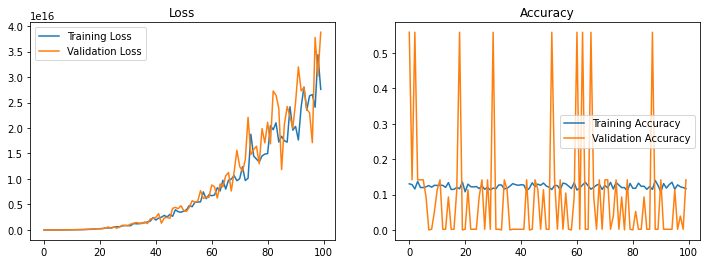

In [29]:
# Check training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history_augmented.history['loss'], label='Training Loss')
plt.plot(history_augmented.history['val_loss'], label='Validation Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1, 2, 2)
plt.plot(history_augmented.history['accuracy'], label='Training Accuracy')
plt.plot(history_augmented.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.title('Accuracy')
plt.show()

In [30]:
# Make predictions on the test set
predictions_augmented1 = model_augmented.predict(X_test)

17/17 [==============================] - 6s 333ms/step


In [31]:
# Check a few predictions
print("Sample Predictions:")
for i in range(5):
    print(f"Actual: {y_test_one_hot[i]}, Predicted: {predictions_augmented1[i]}")


Sample Predictions:
Actual: [1. 0. 0. 0. 0. 1. 1. 1. 0. 0.], Predicted: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
Actual: [1. 0. 0. 0. 1. 1. 1. 0. 0. 0.], Predicted: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
Actual: [0. 0. 0. 1. 0. 1. 1. 0. 1. 0.], Predicted: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
Actual: [0. 0. 0. 1. 0. 1. 1. 0. 1. 0.], Predicted: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
Actual: [1. 0. 0. 0. 0. 1. 1. 0. 1. 0.], Predicted: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]


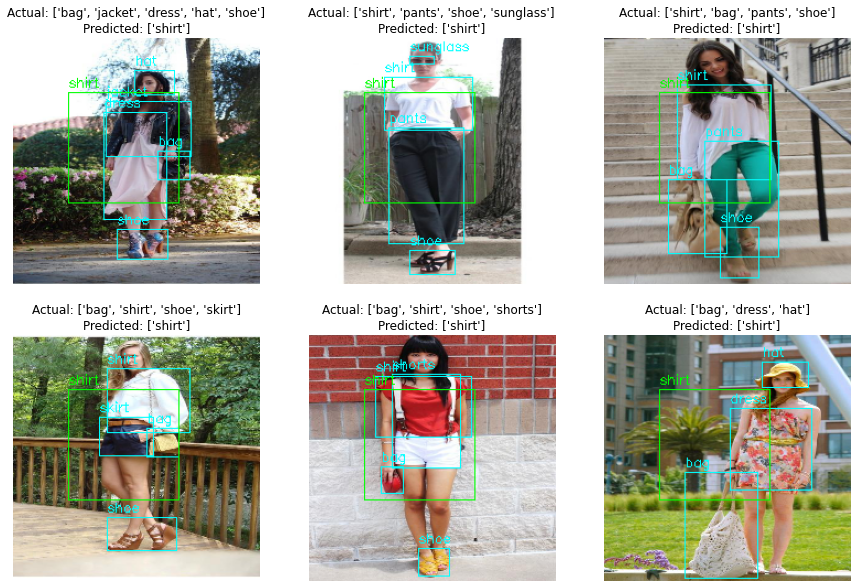

In [32]:
# Visualize random images with both actual and predicted bounding boxes
plt.figure(figsize=(15, 10))
for i, idx in enumerate(random_indices, 1):
    img = images_test[idx].copy()
    annotations_for_image = annotations_test[idx]
    predicted_labels = [class_list[i] for i in range(num_classes) if predictions_augmented1[idx][i] > 0.5]

    # Calculate resize factors
    resize_factor_x = image_size[0] / original_image_size[0]
    resize_factor_y = image_size[1] / original_image_size[1]

    # Draw actual bounding boxes and labels in green
    draw_bboxes_and_labels(img, annotations_for_image, resize_factor_x, resize_factor_y)

    # Draw predicted bounding boxes and labels in green
    for label in predicted_labels:
        bbox = [50, 50, 150, 150]  # Replace with the predicted bounding box coordinates
        draw_bbox_and_label(img, label, bbox, (0, 255, 0))  # Use green color (0, 255, 0)

    plt.subplot(2, 3, i)
    plt.imshow(img)
    plt.title(f"Actual: {[annotation.find('name').text for annotation in annotations_for_image]}\n"
              f"Predicted: {predicted_labels}")
    plt.axis("off")

plt.show()

### Recommendation

In [33]:
import tensorflow as tf
from sklearn.metrics.pairwise import cosine_similarity

In [34]:
tf.keras.backend.clear_session()

In [35]:
# Resize images to match the expected input shape of ResNet50
resized_images = [tf.image.resize(image, (224, 224)) for image in X]

# Convert the list of TensorFlow tensors to a NumPy array
X_resized_np = np.array([tf.keras.backend.eval(image) for image in resized_images])

# Preprocess resized images for ResNet50
X_preprocessed = tf.keras.applications.resnet50.preprocess_input(X_resized_np)


In [36]:
# Load ResNet50 model for feature extraction
resnet_model = tf.keras.applications.ResNet50(
    include_top=False,
    weights='imagenet',
    input_shape=(224, 224, 3),
    pooling='avg'
)

In [37]:
# Extract features for all images
features = resnet_model.predict(X_preprocessed)

84/84 [==============================] - 77s 915ms/step


In [38]:
from sklearn.manifold import TSNE

# Perform t-SNE on the extracted features
tsne = TSNE(n_components=2, random_state=42)
features_tsne = tsne.fit_transform(features)



C:\Users\shari\anaconda3\envs\mycpuenv1\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\shari\anaconda3\envs\mycpuenv1\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


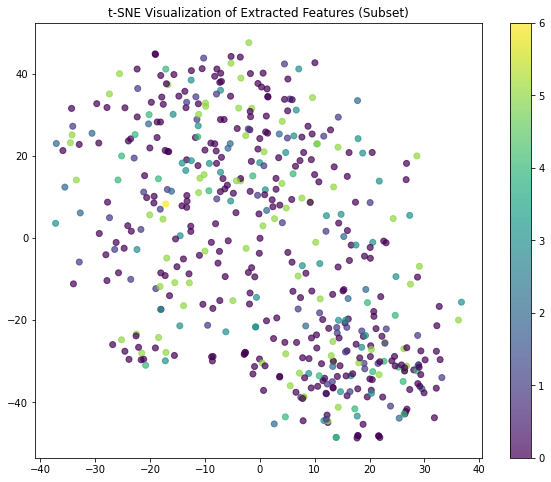

In [39]:
# Visualize a subset of the t-SNE plot
subset_size = 500  # Choose a subset size
subset_indices = np.random.choice(len(X_test), size=subset_size, replace=False)

plt.figure(figsize=(10, 8))
plt.scatter(features_tsne[subset_indices, 0], features_tsne[subset_indices, 1], 
            c=np.argmax(y_test_one_hot[subset_indices], axis=1), cmap='viridis', alpha=0.7)
plt.title('t-SNE Visualization of Extracted Features (Subset)')
plt.colorbar()
plt.show()


The scatter plot of the extracted features using t-SNE visualizes the high-dimensional feature vectors in a reduced 2D space. 

Dots (Points): Each dot on the plot represents an image in your dataset. In this case, each dot corresponds to an image in your test set.

Colors: The colors of the dots are determined by the class labels of the images. Each class is assigned a unique color, and the color of the dot indicates the class to which the corresponding image belongs. This color mapping is achieved using the c=np.argmax(y_test_one_hot[subset_indices], axis=1) line, where y_test_one_hot contains one-hot encoded class labels, and np.argmax is used to get the index of the maximum value (i.e., the predicted class).

For example, if you have classes like 'sunglass,' 'hat,' 'jacket,' etc., each class will be associated with a specific color in the plot. Different colors help distinguish between classes.

In summary, the t-SNE plot is a visual representation of how the extracted features cluster in a 2D space. Points that are close together in the plot are considered similar in the high-dimensional feature space. Colors represent different classes, allowing you to observe the distribution of different classes and potential groupings or separations in the reduced feature space. Keep in mind that while t-SNE provides valuable insights, it may not preserve all the relationships in the original high-dimensional space, and it's primarily used for visualization and exploration.

In [40]:
# Function to get similar images based on cosine similarity
def get_similar_images(query_image_index, features, num_recommendations=5):
    query_feature = features[query_image_index].reshape(1, -1)
    similarities = cosine_similarity(query_feature, features).flatten()

    # Get indices of similar images, excluding the query image itself
    similar_indices = similarities.argsort()[:-num_recommendations-1:-1]

    return similar_indices

# Randomly select an image for recommendation
query_image_index = np.random.choice(len(X_test))

(-0.5, 223.5, 223.5, -0.5)

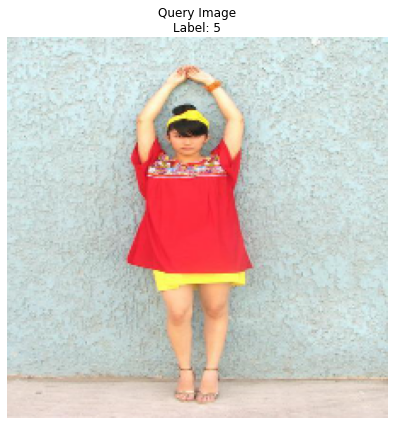

In [41]:
# Get similar images, excluding the query image
similar_indices = get_similar_images(query_image_index, features, num_recommendations=8)

# Ensure that the indices are within bounds and exclude the query image
valid_indices = [idx for idx in similar_indices if idx < len(X_test) and idx != query_image_index]

# If needed, add more indices to reach the total of 9 recommendations
remaining_recommendations = 9 - len(valid_indices)
additional_indices = np.random.choice([idx for idx in range(len(X_test)) if idx not in valid_indices and idx != query_image_index], remaining_recommendations, replace=False)
valid_indices.extend(additional_indices)

# Visualize the query image and its recommendations with a thick line
plt.figure(figsize=(15, 10))

# Plot the query image separately
plt.subplot(1, 2, 1)
plt.imshow(X_test[query_image_index])
#plt.title(f"Query Image\nLabel: {y_test[query_image_index]}")
plt.title(f"Query Image\nLabel: {np.argmax(y_test_one_hot[query_image_index])}")
plt.axis("off")




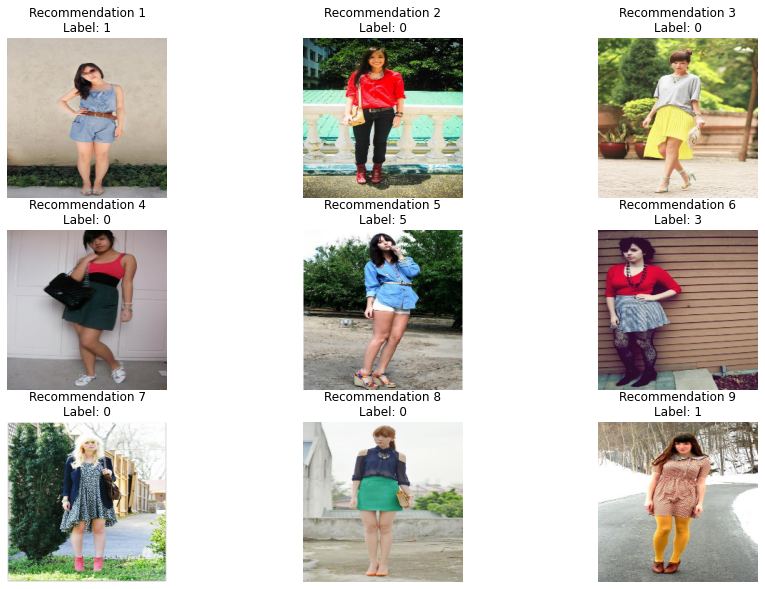

In [42]:
# Visualize the query image and its recommendations with a thick line
plt.figure(figsize=(15, 10))

# Plot recommended images
for i, idx in enumerate(valid_indices, 1):
    plt.subplot(3, 3, i)
    plt.imshow(X_test[idx])
    plt.title(f"Recommendation {i}\nLabel: {np.argmax(y_test_one_hot[idx])}")
    #plt.title(f"Recommendation {i}\nLabel: {y_test[idx]}")
    plt.axis("off")

plt.show()

#### Recommendation Observations

from the recommendation final results that is present in the images above , the recommendations looks good and close . specially the the 1st 4 images are close to the image which has been picked up as the source to find recommendation.

### GAN and Building Synthetic data to be used in training the model further

In [43]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Reshape, Flatten
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.optimizers import Adam


In [44]:
def build_gan(latent_dim, img_shape):
    model = Sequential()
    
    # Generator
    model.add(Dense(256, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Dense(512))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Dense(1024))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Dense(np.prod(img_shape), activation='tanh'))
    model.add(Reshape(img_shape))

    return model



def build_discriminator(img_shape):
    model = Sequential()

    # Discriminator
    model.add(Flatten(input_shape=img_shape))
    model.add(Dense(512))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dense(256))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dense(1, activation='sigmoid'))

    return model


In [45]:
def build_gan_model(generator, discriminator):
    discriminator.trainable = False
    model = Sequential()
    model.add(generator)
    model.add(discriminator)
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5))
    return model


In [46]:
def train_gan(generator, discriminator, gan_model, X_train, epochs=100, batch_size=64, latent_dim=100, img_shape=(224, 224, 3)):
    half_batch = batch_size // 2

    for epoch in range(epochs):
        idx = np.random.randint(0, X_train.shape[0], half_batch)
        real_images = X_train[idx]

        noise = np.random.normal(0, 1, (half_batch, latent_dim))
        fake_images = generator.predict(noise)

        # Reshape the fake_images to match the expected input shape of the discriminator
        fake_images = np.reshape(fake_images, (half_batch,) + img_shape)

        real_labels = np.ones((half_batch, 1))
        fake_labels = np.zeros((half_batch, 1))

        d_loss_real = discriminator.train_on_batch(real_images, real_labels)
        d_loss_fake = discriminator.train_on_batch(fake_images, fake_labels)
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

        noise = np.random.normal(0, 1, (batch_size, latent_dim))
        valid_labels = np.ones((batch_size, 1))

        g_loss = gan_model.train_on_batch(noise, valid_labels)

        print(f"{epoch}/{epochs} [D loss: {d_loss[0]} | D accuracy: {100 * d_loss[1]}] [G loss: {g_loss}]")

        if epoch % save_interval == 0:
            save_generated_images(generator, epoch, examples=10, latent_dim=100)


In [47]:
def save_generated_images(generator, epoch, examples=10, latent_dim=100):
    noise = np.random.normal(0, 1, (examples, int(latent_dim)))
    generated_images = generator.predict(noise)

    generated_images = 0.5 * generated_images + 0.5  # Rescale images 0-1

    fig, axs = plt.subplots(2, examples, figsize=(15, 4))

    for i in range(examples):
        axs[0, i].imshow(generated_images[i])
        axs[0, i].axis('off')

    plt.show()


1/1 [==============================] - 0s 121ms/step
0/10000 [D loss: 93.44362217187881 | D accuracy: 15.625] [G loss: 0.7036535739898682]
1/1 [==============================] - 0s 36ms/step


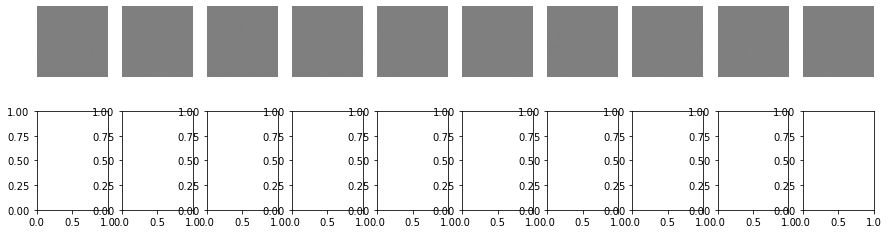

1/1 [==============================] - 0s 30ms/step
1/10000 [D loss: 0.6219688653945923 | D accuracy: 71.875] [G loss: 11.17255687713623]
1/1 [==============================] - 0s 34ms/step
2/10000 [D loss: 0.963738203048706 | D accuracy: 81.25] [G loss: 17.323036193847656]
1/1 [==============================] - 0s 41ms/step
3/10000 [D loss: 2.985901117324829 | D accuracy: 75.0] [G loss: 10.64583969116211]
1/1 [==============================] - 0s 41ms/step
4/10000 [D loss: 4.4497833251953125 | D accuracy: 71.875] [G loss: 15.981298446655273]
1/1 [==============================] - 0s 37ms/step
5/10000 [D loss: 4.785516262054443 | D accuracy: 65.625] [G loss: 20.983253479003906]
1/1 [==============================] - 0s 33ms/step
6/10000 [D loss: 7.903573036193848 | D accuracy: 68.75] [G loss: 19.60727310180664]
1/1 [==============================] - 0s 34ms/step
7/10000 [D loss: 7.331014156341553 | D accuracy: 65.625] [G loss: 20.854843139648438]
1/1 [==============================] - 

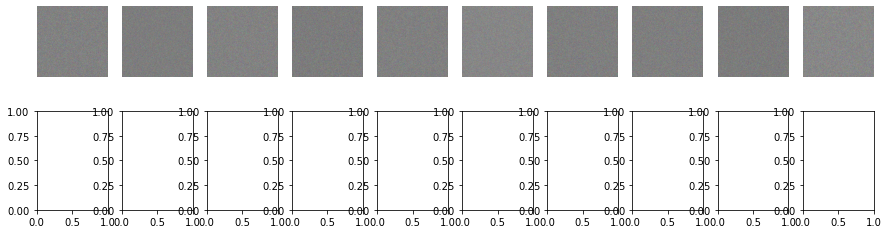

1/1 [==============================] - 0s 33ms/step
51/10000 [D loss: 141.9958038330078 | D accuracy: 65.625] [G loss: 64.89344787597656]
1/1 [==============================] - 0s 33ms/step
52/10000 [D loss: 177.32635498046875 | D accuracy: 56.25] [G loss: 42.591365814208984]
1/1 [==============================] - 0s 35ms/step
53/10000 [D loss: 152.6106719970703 | D accuracy: 68.75] [G loss: 35.683753967285156]
1/1 [==============================] - 0s 31ms/step
54/10000 [D loss: 36.15054702758789 | D accuracy: 78.125] [G loss: 59.0665168762207]
1/1 [==============================] - 0s 35ms/step
55/10000 [D loss: 94.54457092285156 | D accuracy: 65.625] [G loss: 38.007652282714844]
1/1 [==============================] - 0s 32ms/step
56/10000 [D loss: 132.96522521972656 | D accuracy: 56.25] [G loss: 32.247398376464844]
1/1 [==============================] - 0s 34ms/step
57/10000 [D loss: 135.30043029785156 | D accuracy: 65.625] [G loss: 52.849822998046875]
1/1 [=========================

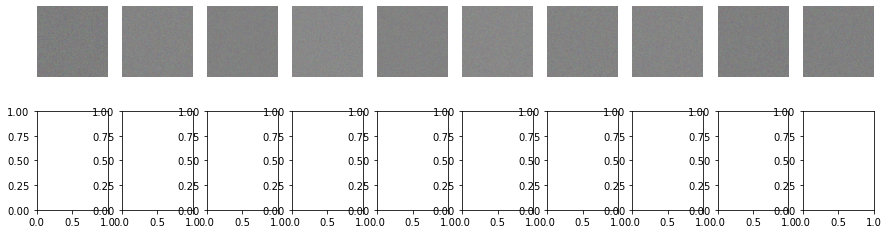

1/1 [==============================] - 0s 31ms/step
101/10000 [D loss: 63.97533416748047 | D accuracy: 59.375] [G loss: 20.917247772216797]
1/1 [==============================] - 0s 34ms/step
102/10000 [D loss: 84.96541595458984 | D accuracy: 53.125] [G loss: 11.728246688842773]
1/1 [==============================] - 0s 33ms/step
103/10000 [D loss: 61.35492706298828 | D accuracy: 65.625] [G loss: 16.278642654418945]
1/1 [==============================] - 0s 37ms/step
104/10000 [D loss: 48.02532958984375 | D accuracy: 59.375] [G loss: 12.864261627197266]
1/1 [==============================] - 0s 38ms/step
105/10000 [D loss: 69.11637878417969 | D accuracy: 53.125] [G loss: 5.615297317504883]
1/1 [==============================] - 0s 39ms/step
106/10000 [D loss: 67.99732208251953 | D accuracy: 53.125] [G loss: 7.376433372497559]
1/1 [==============================] - 0s 33ms/step
107/10000 [D loss: 59.670448303222656 | D accuracy: 53.125] [G loss: 12.330541610717773]
1/1 [================

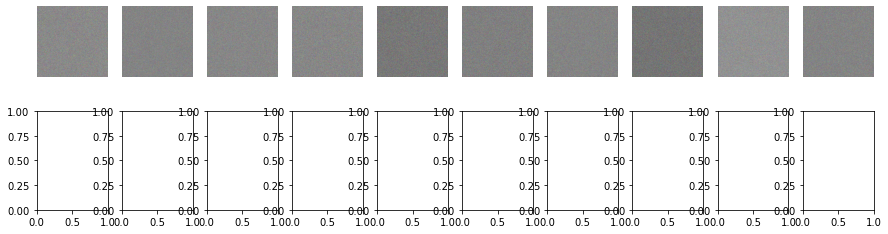

1/1 [==============================] - 0s 32ms/step
151/10000 [D loss: 953.6787719726562 | D accuracy: 59.375] [G loss: 286.287109375]
1/1 [==============================] - 0s 32ms/step
152/10000 [D loss: 1020.3839111328125 | D accuracy: 53.125] [G loss: 272.0575866699219]
1/1 [==============================] - 0s 36ms/step
153/10000 [D loss: 1343.4775390625 | D accuracy: 62.5] [G loss: 285.434814453125]
1/1 [==============================] - 0s 103ms/step
154/10000 [D loss: 1393.8798828125 | D accuracy: 62.5] [G loss: 99.52435302734375]
1/1 [==============================] - 0s 37ms/step
155/10000 [D loss: 971.3701171875 | D accuracy: 65.625] [G loss: 427.76287841796875]
1/1 [==============================] - 0s 34ms/step
156/10000 [D loss: 1364.94140625 | D accuracy: 65.625] [G loss: 132.62789916992188]
1/1 [==============================] - 0s 34ms/step
157/10000 [D loss: 1301.871826171875 | D accuracy: 59.375] [G loss: 228.02716064453125]
1/1 [==============================] - 0s 

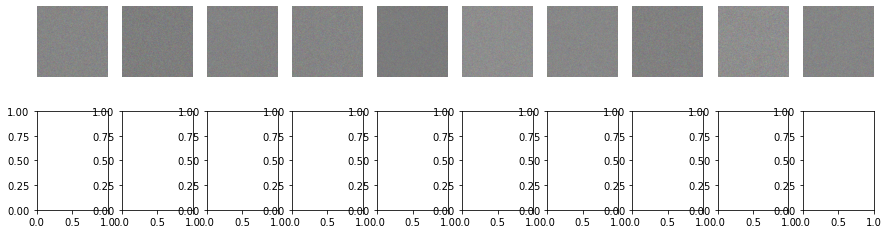

1/1 [==============================] - 0s 32ms/step
201/10000 [D loss: 626.5919189453125 | D accuracy: 50.0] [G loss: 6.362269401550293]
1/1 [==============================] - 0s 30ms/step
202/10000 [D loss: 801.1823120117188 | D accuracy: 50.0] [G loss: 45.7100715637207]
1/1 [==============================] - 0s 37ms/step
203/10000 [D loss: 706.357177734375 | D accuracy: 56.25] [G loss: 45.07034683227539]
1/1 [==============================] - 0s 40ms/step
204/10000 [D loss: 678.6531982421875 | D accuracy: 53.125] [G loss: 52.47199249267578]
1/1 [==============================] - 0s 36ms/step
205/10000 [D loss: 674.5294189453125 | D accuracy: 53.125] [G loss: 28.46731948852539]
1/1 [==============================] - 0s 35ms/step
206/10000 [D loss: 728.1942138671875 | D accuracy: 62.5] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
207/10000 [D loss: 596.7317504882812 | D accuracy: 59.375] [G loss: 45.056190490722656]
1/1 [==============================] - 0s 37ms/st

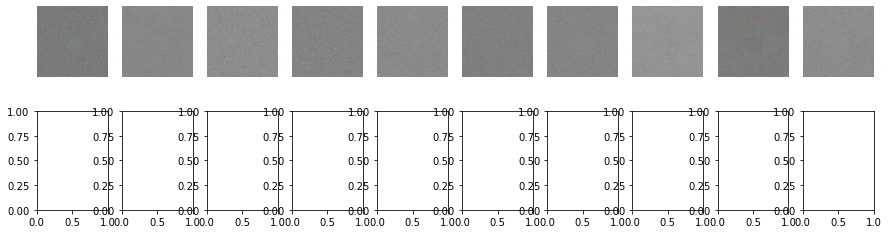

1/1 [==============================] - 0s 34ms/step
251/10000 [D loss: 1564.2318115234375 | D accuracy: 50.0] [G loss: 407.5113830566406]
1/1 [==============================] - 0s 35ms/step
252/10000 [D loss: 1666.28466796875 | D accuracy: 56.25] [G loss: 255.52740478515625]
1/1 [==============================] - 0s 37ms/step
253/10000 [D loss: 1502.389404296875 | D accuracy: 50.0] [G loss: 191.35745239257812]
1/1 [==============================] - 0s 33ms/step
254/10000 [D loss: 1062.8289794921875 | D accuracy: 59.375] [G loss: 511.936767578125]
1/1 [==============================] - 0s 37ms/step
255/10000 [D loss: 1677.001220703125 | D accuracy: 59.375] [G loss: 214.56686401367188]
1/1 [==============================] - 0s 32ms/step
256/10000 [D loss: 1639.28662109375 | D accuracy: 62.5] [G loss: 144.95135498046875]
1/1 [==============================] - 0s 34ms/step
257/10000 [D loss: 1514.78125 | D accuracy: 53.125] [G loss: 233.9010009765625]
1/1 [==============================] -

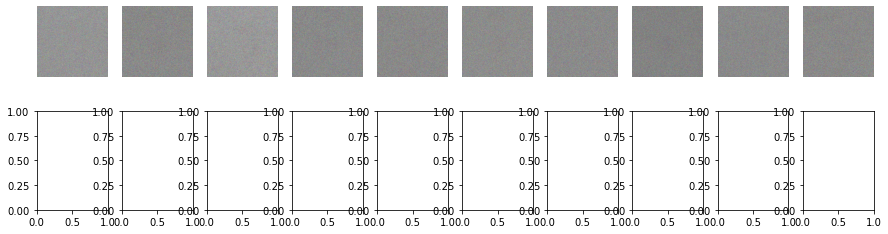

1/1 [==============================] - 0s 43ms/step
301/10000 [D loss: 887.0328979492188 | D accuracy: 53.125] [G loss: 21.226421356201172]
1/1 [==============================] - 0s 32ms/step
302/10000 [D loss: 1106.074462890625 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
303/10000 [D loss: 992.6441650390625 | D accuracy: 50.0] [G loss: 57.56596755981445]
1/1 [==============================] - 0s 30ms/step
304/10000 [D loss: 537.3763427734375 | D accuracy: 53.125] [G loss: 17.357378005981445]
1/1 [==============================] - 0s 31ms/step
305/10000 [D loss: 861.7454223632812 | D accuracy: 50.0] [G loss: 16.934589385986328]
1/1 [==============================] - 0s 33ms/step
306/10000 [D loss: 843.388916015625 | D accuracy: 50.0] [G loss: 22.569419860839844]
1/1 [==============================] - 0s 34ms/step
307/10000 [D loss: 839.8826904296875 | D accuracy: 50.0] [G loss: 3.2670321464538574]
1/1 [==============================] - 0s 30m

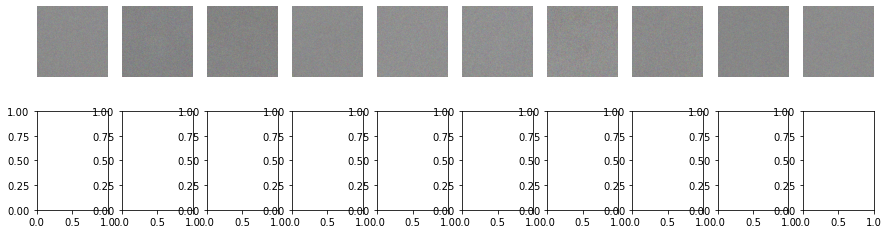

1/1 [==============================] - 0s 40ms/step
351/10000 [D loss: 15.81214427947998 | D accuracy: 56.25] [G loss: 28.059326171875]
1/1 [==============================] - 0s 32ms/step
352/10000 [D loss: 8356.947509765625 | D accuracy: 18.75] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
353/10000 [D loss: 5055.6279296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
354/10000 [D loss: 5602.24365234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
355/10000 [D loss: 6556.59765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
356/10000 [D loss: 6005.7822265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
357/10000 [D loss: 6734.4765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
358/10000 [D loss: 5914.060546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============

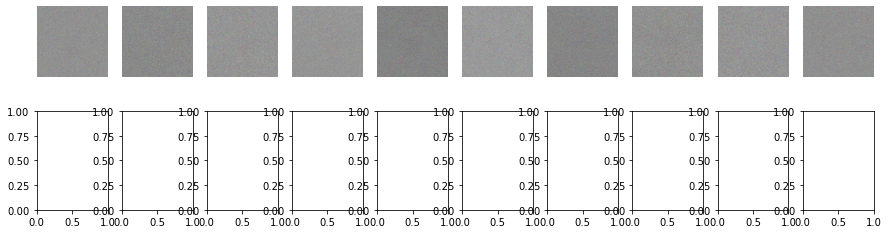

1/1 [==============================] - 0s 31ms/step
401/10000 [D loss: 6678.2841796875 | D accuracy: 56.25] [G loss: 261.6263122558594]
1/1 [==============================] - 0s 38ms/step
402/10000 [D loss: 5214.6728515625 | D accuracy: 53.125] [G loss: 42.926658630371094]
1/1 [==============================] - 0s 35ms/step
403/10000 [D loss: 4243.13720703125 | D accuracy: 53.125] [G loss: 619.4442138671875]
1/1 [==============================] - 0s 42ms/step
404/10000 [D loss: 5556.94677734375 | D accuracy: 50.0] [G loss: 299.884033203125]
1/1 [==============================] - 0s 39ms/step
405/10000 [D loss: 5659.91455078125 | D accuracy: 50.0] [G loss: 155.42198181152344]
1/1 [==============================] - 0s 32ms/step
406/10000 [D loss: 4433.5947265625 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
407/10000 [D loss: 3386.242431640625 | D accuracy: 50.0] [G loss: 187.89173889160156]
1/1 [==============================] - 0s 34ms/step
408

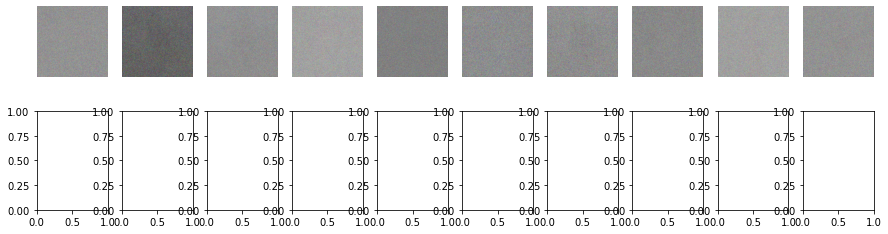

1/1 [==============================] - 0s 134ms/step
451/10000 [D loss: 10335.7060546875 | D accuracy: 50.0] [G loss: 200.86532592773438]
1/1 [==============================] - 0s 34ms/step
452/10000 [D loss: 6569.11328125 | D accuracy: 53.125] [G loss: 1118.198974609375]
1/1 [==============================] - 0s 32ms/step
453/10000 [D loss: 9033.83984375 | D accuracy: 50.0] [G loss: 116.63407135009766]
1/1 [==============================] - 0s 38ms/step
454/10000 [D loss: 9402.6279296875 | D accuracy: 53.125] [G loss: 593.121826171875]
1/1 [==============================] - 0s 43ms/step
455/10000 [D loss: 10420.072265625 | D accuracy: 53.125] [G loss: 204.2130126953125]
1/1 [==============================] - 0s 34ms/step
456/10000 [D loss: 8092.8154296875 | D accuracy: 53.125] [G loss: 459.372314453125]
1/1 [==============================] - 0s 32ms/step
457/10000 [D loss: 10094.7841796875 | D accuracy: 53.125] [G loss: 480.4254150390625]
1/1 [==============================] - 0s 34ms

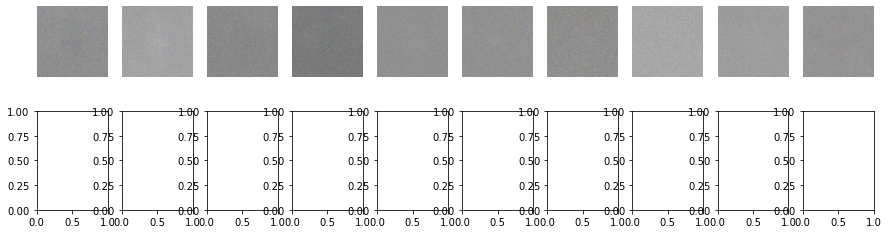

1/1 [==============================] - 0s 33ms/step
501/10000 [D loss: 3516.859130859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
502/10000 [D loss: 3742.65380859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
503/10000 [D loss: 4364.38427734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
504/10000 [D loss: 3705.9765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
505/10000 [D loss: 3392.597900390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
506/10000 [D loss: 3347.91845703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
507/10000 [D loss: 3231.37646484375 | D accuracy: 56.25] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
508/10000 [D loss: 3417.779052734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [===================

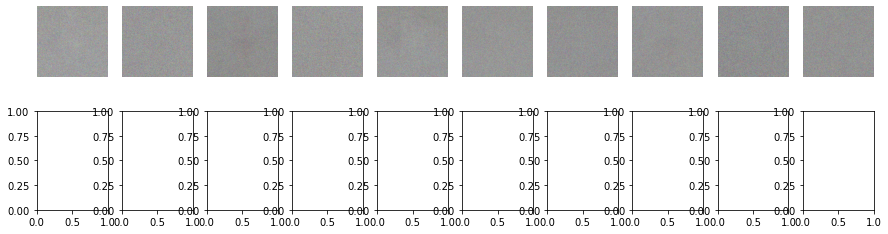

1/1 [==============================] - 0s 31ms/step
551/10000 [D loss: 2608.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
552/10000 [D loss: 2654.39453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
553/10000 [D loss: 2326.680908203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
554/10000 [D loss: 2131.25927734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
555/10000 [D loss: 2513.7890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
556/10000 [D loss: 2250.57080078125 | D accuracy: 50.0] [G loss: 5.187414169311523]
1/1 [==============================] - 0s 34ms/step
557/10000 [D loss: 1880.236083984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
558/10000 [D loss: 2077.1376953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [===================

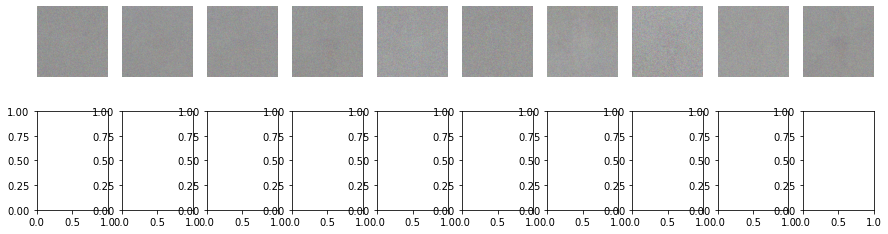

1/1 [==============================] - 0s 34ms/step
601/10000 [D loss: 1705.849609375 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
602/10000 [D loss: 2009.068115234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
603/10000 [D loss: 1821.009521484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
604/10000 [D loss: 1844.5806884765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
605/10000 [D loss: 1954.46435546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
606/10000 [D loss: 1511.042236328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
607/10000 [D loss: 1617.37548828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
608/10000 [D loss: 1535.9376220703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [============

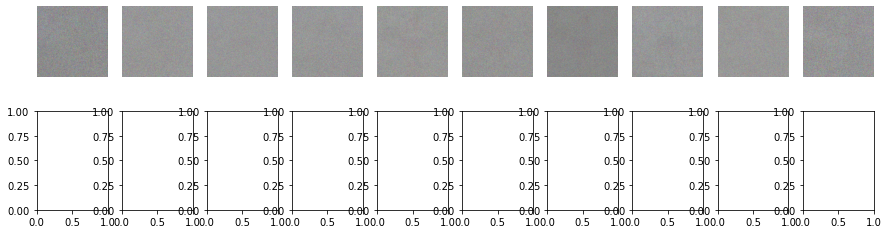

1/1 [==============================] - 0s 45ms/step
651/10000 [D loss: 2225.11181640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
652/10000 [D loss: 1682.1162109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
653/10000 [D loss: 1673.894287109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
654/10000 [D loss: 1787.828857421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
655/10000 [D loss: 1543.265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
656/10000 [D loss: 1367.940673828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
657/10000 [D loss: 1338.5640869140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
658/10000 [D loss: 1500.609619140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [===================

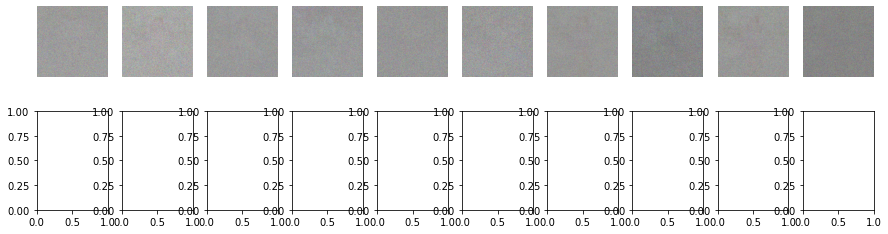

1/1 [==============================] - 0s 33ms/step
701/10000 [D loss: 2163.29296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
702/10000 [D loss: 2074.71142578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
703/10000 [D loss: 1891.72314453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
704/10000 [D loss: 2086.5078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
705/10000 [D loss: 1964.8692626953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
706/10000 [D loss: 1847.3447265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
707/10000 [D loss: 1754.2421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
708/10000 [D loss: 2098.742431640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [============================

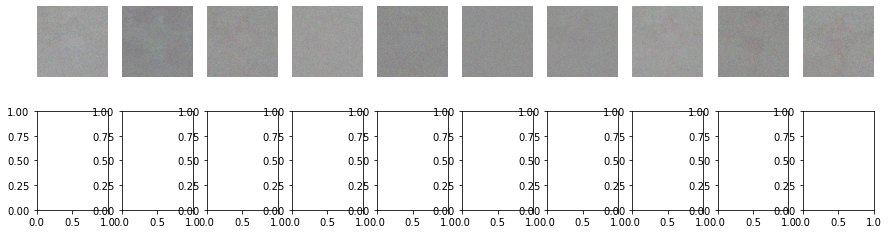

1/1 [==============================] - 0s 30ms/step
751/10000 [D loss: 3236.2392578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
752/10000 [D loss: 3005.916259765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
753/10000 [D loss: 3439.9521484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
754/10000 [D loss: 3240.120361328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
755/10000 [D loss: 3108.673583984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
756/10000 [D loss: 2816.4990234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
757/10000 [D loss: 2741.852783203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
758/10000 [D loss: 2594.353515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [====================

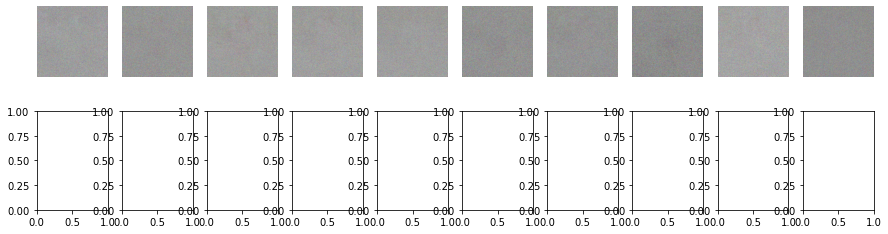

1/1 [==============================] - 0s 31ms/step
801/10000 [D loss: 92.98225402832031 | D accuracy: 62.5] [G loss: 2.2345049381256104]
1/1 [==============================] - 0s 35ms/step
802/10000 [D loss: 3798.8935546875 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
803/10000 [D loss: 3154.046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
804/10000 [D loss: 2586.619384765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
805/10000 [D loss: 2851.65966796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
806/10000 [D loss: 3016.494873046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
807/10000 [D loss: 2682.8486328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
808/10000 [D loss: 2800.917724609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=====

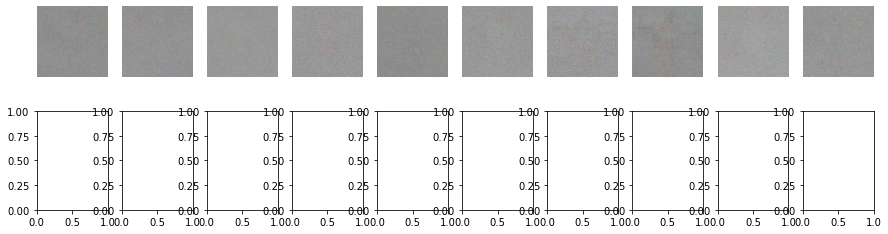

1/1 [==============================] - 0s 31ms/step
851/10000 [D loss: 6655.68798828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
852/10000 [D loss: 8637.822265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
853/10000 [D loss: 7470.32373046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
854/10000 [D loss: 9158.5673828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
855/10000 [D loss: 7313.4248046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
856/10000 [D loss: 7751.2900390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
857/10000 [D loss: 7273.751953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
858/10000 [D loss: 7338.6728515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [===========================

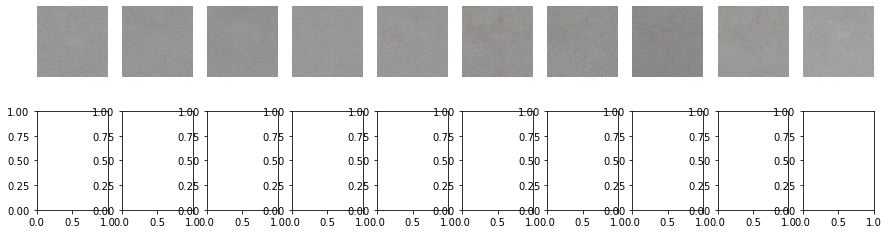

1/1 [==============================] - 0s 39ms/step
901/10000 [D loss: 2704.77490234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
902/10000 [D loss: 2369.196533203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 56ms/step
903/10000 [D loss: 2273.351318359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
904/10000 [D loss: 2198.801513671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
905/10000 [D loss: 1989.9384765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
906/10000 [D loss: 2059.2529296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
907/10000 [D loss: 1769.240966796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
908/10000 [D loss: 1462.609130859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [================

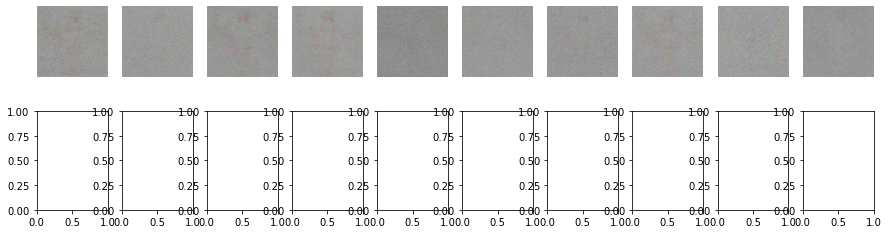

1/1 [==============================] - 0s 34ms/step
951/10000 [D loss: 15634.232421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
952/10000 [D loss: 13583.939453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
953/10000 [D loss: 12743.9609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
954/10000 [D loss: 14309.0546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
955/10000 [D loss: 11678.609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
956/10000 [D loss: 12523.728515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
957/10000 [D loss: 11508.833984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
958/10000 [D loss: 11998.1796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s

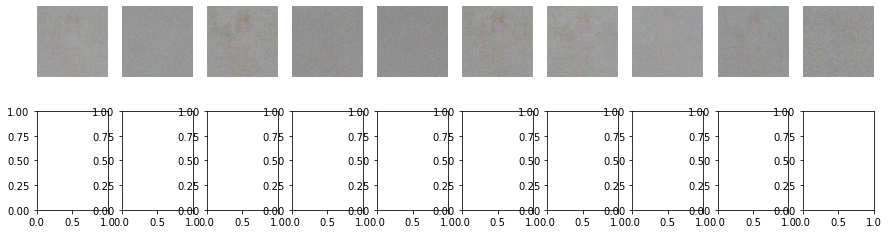

1/1 [==============================] - 0s 33ms/step
1001/10000 [D loss: 49600.1015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
1002/10000 [D loss: 48987.04296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
1003/10000 [D loss: 44276.9453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1004/10000 [D loss: 46000.78515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1005/10000 [D loss: 44296.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1006/10000 [D loss: 49120.02734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
1007/10000 [D loss: 42238.0234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1008/10000 [D loss: 47531.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s

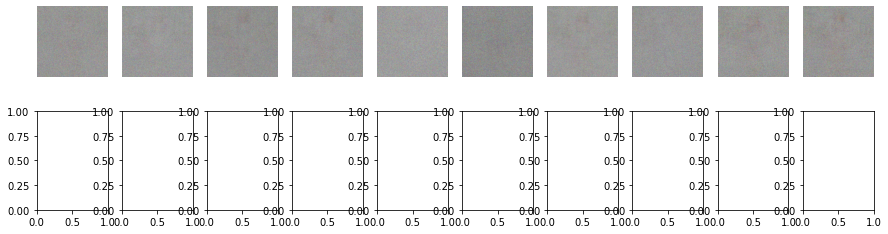

1/1 [==============================] - 0s 32ms/step
1051/10000 [D loss: 11643.4775390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1052/10000 [D loss: 10082.513671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1053/10000 [D loss: 8907.4443359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1054/10000 [D loss: 6783.63671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1055/10000 [D loss: 6025.8525390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
1056/10000 [D loss: 4002.564208984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1057/10000 [D loss: 2910.19482421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
1058/10000 [D loss: 758.6327514648438 | D accuracy: 50.0] [G loss: 1170.033203125]
1/1 [====

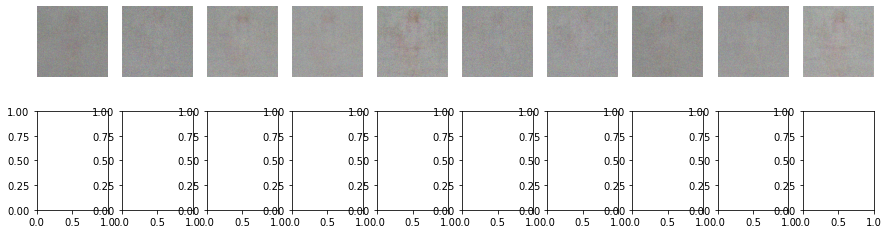

1/1 [==============================] - 0s 40ms/step
1101/10000 [D loss: 54185.4765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1102/10000 [D loss: 53148.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1103/10000 [D loss: 56867.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1104/10000 [D loss: 54973.12890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1105/10000 [D loss: 55863.89453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1106/10000 [D loss: 50708.72265625 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
1107/10000 [D loss: 55138.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1108/10000 [D loss: 51893.3203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 

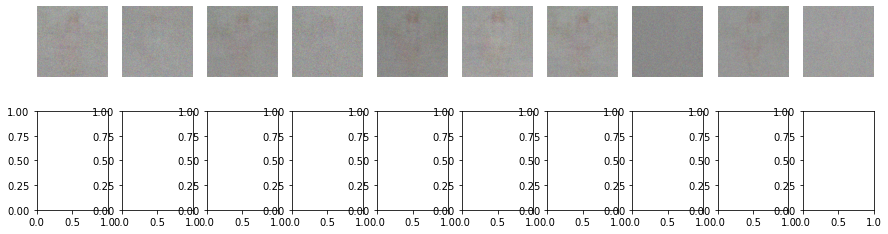

1/1 [==============================] - 0s 32ms/step
1151/10000 [D loss: 34393.12890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1152/10000 [D loss: 42496.80859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1153/10000 [D loss: 40200.55859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1154/10000 [D loss: 36321.1953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
1155/10000 [D loss: 36374.74609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 53ms/step
1156/10000 [D loss: 28044.275390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1157/10000 [D loss: 33533.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1158/10000 [D loss: 37455.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0

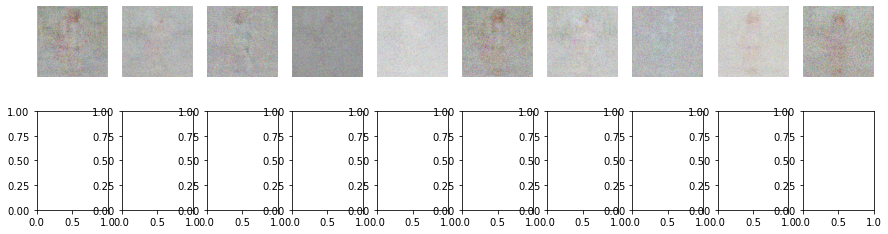

1/1 [==============================] - 0s 29ms/step
1201/10000 [D loss: 221360.5 | D accuracy: 53.125] [G loss: 34496.3203125]
1/1 [==============================] - 0s 33ms/step
1202/10000 [D loss: 203922.28125 | D accuracy: 50.0] [G loss: 23314.830078125]
1/1 [==============================] - 0s 42ms/step
1203/10000 [D loss: 214441.0625 | D accuracy: 53.125] [G loss: 3131.714599609375]
1/1 [==============================] - 0s 31ms/step
1204/10000 [D loss: 201953.34375 | D accuracy: 53.125] [G loss: 3488.739990234375]
1/1 [==============================] - 0s 33ms/step
1205/10000 [D loss: 212922.15625 | D accuracy: 50.0] [G loss: 78020.7578125]
1/1 [==============================] - 0s 35ms/step
1206/10000 [D loss: 169483.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1207/10000 [D loss: 254740.109375 | D accuracy: 50.0] [G loss: 996.5322265625]
1/1 [==============================] - 0s 31ms/step
1208/10000 [D loss: 184617.0625 | D accurac

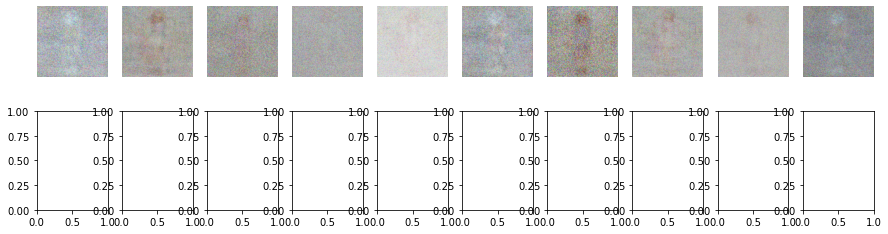

1/1 [==============================] - 0s 37ms/step
1251/10000 [D loss: 132016.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1252/10000 [D loss: 137769.359375 | D accuracy: 50.0] [G loss: 4227.96142578125]
1/1 [==============================] - 0s 35ms/step
1253/10000 [D loss: 191767.40625 | D accuracy: 50.0] [G loss: 5577.04638671875]
1/1 [==============================] - 0s 31ms/step
1254/10000 [D loss: 166323.09375 | D accuracy: 50.0] [G loss: 3312.49365234375]
1/1 [==============================] - 0s 46ms/step
1255/10000 [D loss: 148914.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1256/10000 [D loss: 145309.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 105ms/step
1257/10000 [D loss: 144048.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1258/10000 [D loss: 113358.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [======

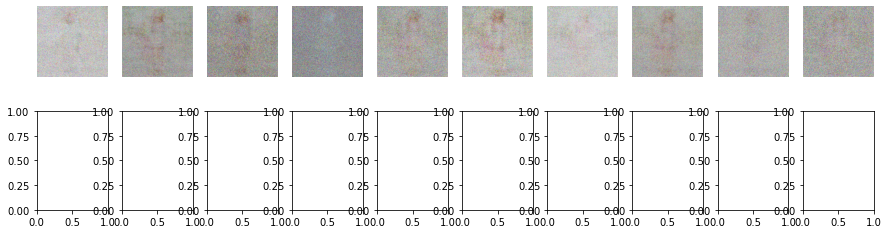

1/1 [==============================] - 0s 38ms/step
1301/10000 [D loss: 86068.390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
1302/10000 [D loss: 71903.6328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
1303/10000 [D loss: 78990.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1304/10000 [D loss: 70394.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1305/10000 [D loss: 59679.21875 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1306/10000 [D loss: 72420.7734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1307/10000 [D loss: 50696.37890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1308/10000 [D loss: 58667.02734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms

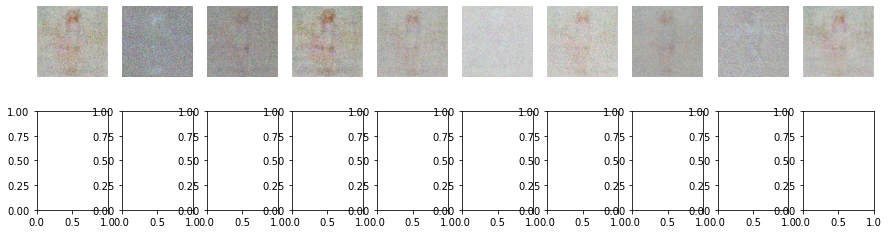

1/1 [==============================] - 0s 37ms/step
1351/10000 [D loss: 95736.359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1352/10000 [D loss: 86596.90625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1353/10000 [D loss: 83994.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1354/10000 [D loss: 93320.9921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1355/10000 [D loss: 85626.6328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1356/10000 [D loss: 84618.203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
1357/10000 [D loss: 78486.7421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1358/10000 [D loss: 88000.7734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/s

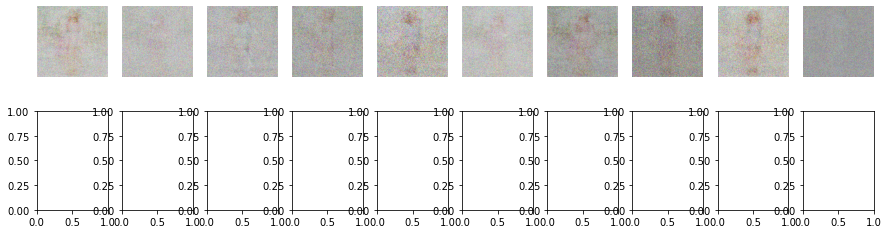

1/1 [==============================] - 0s 31ms/step
1401/10000 [D loss: 37856.0859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1402/10000 [D loss: 42326.3828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1403/10000 [D loss: 41359.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1404/10000 [D loss: 39795.9140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1405/10000 [D loss: 38370.3515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1406/10000 [D loss: 37886.2421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1407/10000 [D loss: 30057.853515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1408/10000 [D loss: 37387.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 

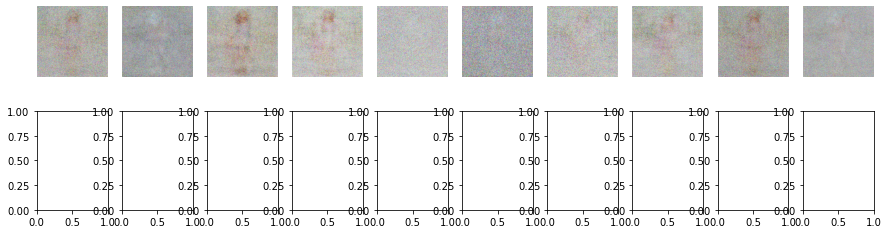

1/1 [==============================] - 0s 44ms/step
1451/10000 [D loss: 3476.366455078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1452/10000 [D loss: 2971.12255859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1453/10000 [D loss: 1935.587890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
1454/10000 [D loss: 1370.866943359375 | D accuracy: 50.0] [G loss: 108.76649475097656]
1/1 [==============================] - 0s 33ms/step
1455/10000 [D loss: 10376.585571289062 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1456/10000 [D loss: 15420.185546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1457/10000 [D loss: 16529.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1458/10000 [D loss: 17386.880859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 

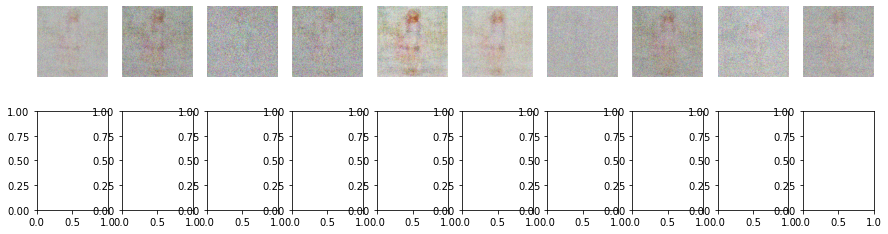

1/1 [==============================] - 0s 30ms/step
1501/10000 [D loss: 1873.219970703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1502/10000 [D loss: 835.4097900390625 | D accuracy: 53.125] [G loss: 11.389847755432129]
1/1 [==============================] - 0s 35ms/step
1503/10000 [D loss: 716.68212890625 | D accuracy: 53.125] [G loss: 170.75302124023438]
1/1 [==============================] - 0s 35ms/step
1504/10000 [D loss: 31977.9873046875 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1505/10000 [D loss: 20303.65234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1506/10000 [D loss: 21286.25390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1507/10000 [D loss: 18132.4453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1508/10000 [D loss: 20702.4921875 | D accuracy: 50.0] [G 

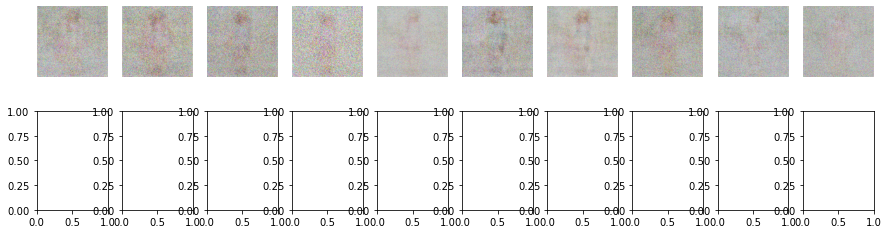

1/1 [==============================] - 0s 34ms/step
1551/10000 [D loss: 18259.20703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
1552/10000 [D loss: 15860.728515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1553/10000 [D loss: 16152.748046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1554/10000 [D loss: 14926.6669921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
1555/10000 [D loss: 12758.9990234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1556/10000 [D loss: 13125.80078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1557/10000 [D loss: 12810.11328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1558/10000 [D loss: 11128.33203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=====================

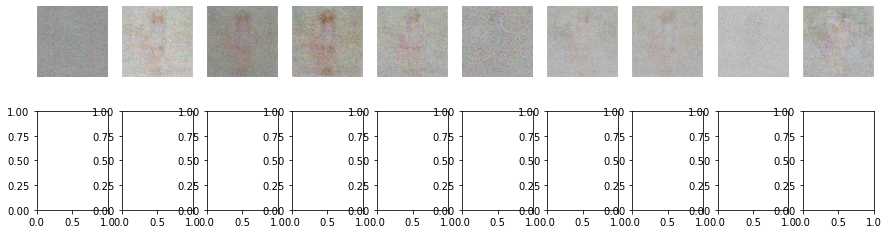

1/1 [==============================] - 0s 31ms/step
1601/10000 [D loss: 11030.775390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1602/10000 [D loss: 10419.974609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1603/10000 [D loss: 12024.029296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1604/10000 [D loss: 10532.4814453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1605/10000 [D loss: 10134.2294921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1606/10000 [D loss: 8726.01953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
1607/10000 [D loss: 6567.54052734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1608/10000 [D loss: 6394.51806640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=================

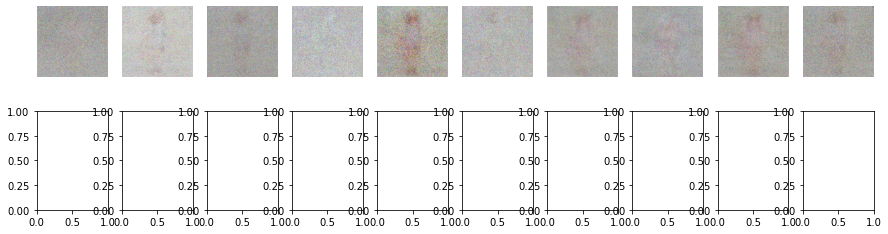

1/1 [==============================] - 0s 42ms/step
1651/10000 [D loss: 27028.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1652/10000 [D loss: 26426.68359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
1653/10000 [D loss: 30620.421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
1654/10000 [D loss: 27881.2421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
1655/10000 [D loss: 29819.60546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1656/10000 [D loss: 23754.11328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1657/10000 [D loss: 25195.966796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1658/10000 [D loss: 22691.134765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================

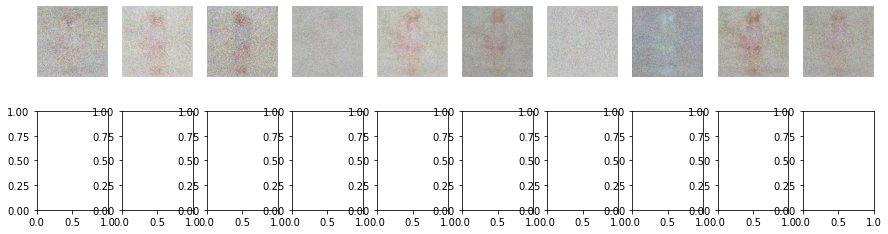

1/1 [==============================] - 0s 31ms/step
1701/10000 [D loss: 3377.912109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1702/10000 [D loss: 2297.10791015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
1703/10000 [D loss: 1352.386962890625 | D accuracy: 50.0] [G loss: 3.0425832271575928]
1/1 [==============================] - 0s 36ms/step
1704/10000 [D loss: 24868.900390625 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1705/10000 [D loss: 8239.39453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1706/10000 [D loss: 8484.212890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1707/10000 [D loss: 7320.93994140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1708/10000 [D loss: 6152.6552734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==

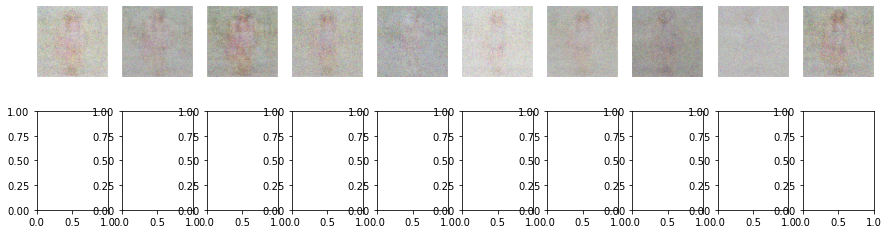

1/1 [==============================] - 0s 39ms/step
1751/10000 [D loss: 125326.9453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1752/10000 [D loss: 116225.4921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1753/10000 [D loss: 136052.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1754/10000 [D loss: 117291.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1755/10000 [D loss: 131097.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1756/10000 [D loss: 123284.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1757/10000 [D loss: 114831.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1758/10000 [D loss: 115530.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms

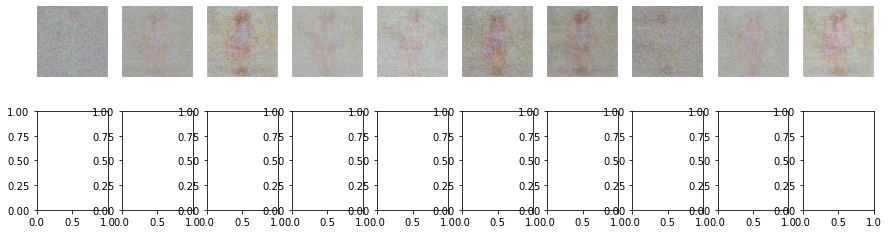

1/1 [==============================] - 0s 31ms/step
1801/10000 [D loss: 65641.8359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1802/10000 [D loss: 70246.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1803/10000 [D loss: 69742.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1804/10000 [D loss: 72492.6484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1805/10000 [D loss: 67234.078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1806/10000 [D loss: 72118.515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
1807/10000 [D loss: 61348.1796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1808/10000 [D loss: 66591.8046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/s

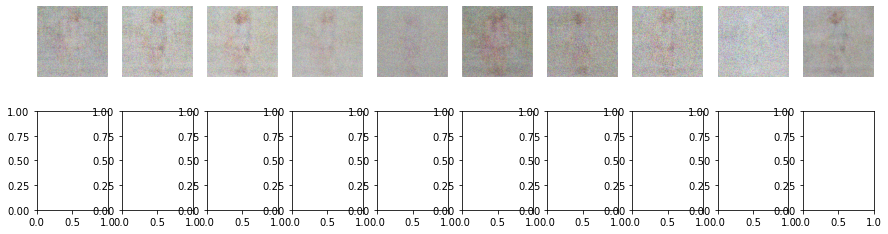

1/1 [==============================] - 0s 31ms/step
1851/10000 [D loss: 24694.00390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1852/10000 [D loss: 25005.671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1853/10000 [D loss: 26548.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1854/10000 [D loss: 24620.24609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
1855/10000 [D loss: 24287.44140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
1856/10000 [D loss: 22408.9921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
1857/10000 [D loss: 24729.34765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
1858/10000 [D loss: 20739.55078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] -

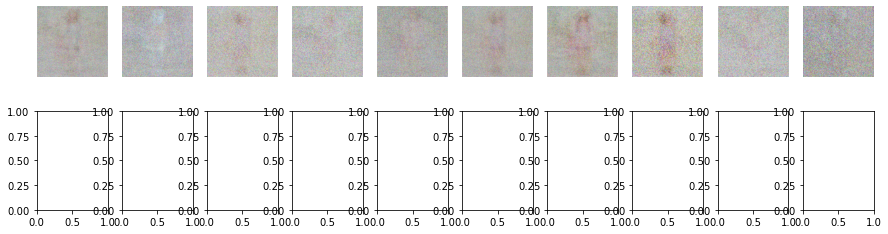

1/1 [==============================] - 0s 31ms/step
1901/10000 [D loss: 3401.44482421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1902/10000 [D loss: 2389.642333984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
1903/10000 [D loss: 1889.724853515625 | D accuracy: 50.0] [G loss: 0.0009262957028113306]
1/1 [==============================] - 0s 30ms/step
1904/10000 [D loss: 1148.878662109375 | D accuracy: 50.0] [G loss: 75.28352355957031]
1/1 [==============================] - 0s 32ms/step
1905/10000 [D loss: 4107.688583374023 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1906/10000 [D loss: 5279.880859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
1907/10000 [D loss: 5666.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
1908/10000 [D loss: 5605.06982421875 | D accuracy: 50.0] 

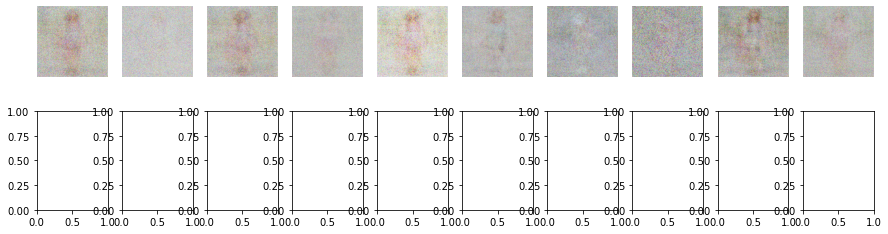

1/1 [==============================] - 0s 32ms/step
1951/10000 [D loss: 23502.666015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1952/10000 [D loss: 22499.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
1953/10000 [D loss: 25167.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1954/10000 [D loss: 21541.146484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1955/10000 [D loss: 23119.30859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
1956/10000 [D loss: 20855.453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
1957/10000 [D loss: 18142.640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
1958/10000 [D loss: 21381.2421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0

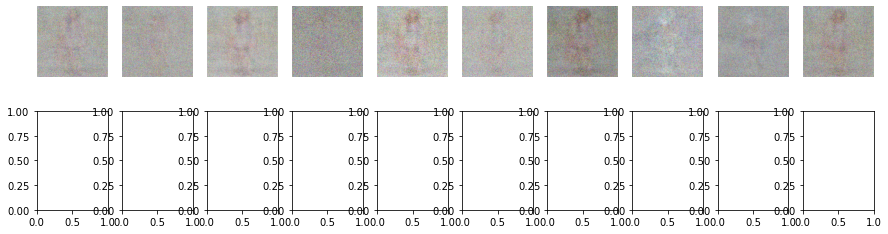

1/1 [==============================] - 0s 31ms/step
2001/10000 [D loss: 72917.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
2002/10000 [D loss: 66660.4453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2003/10000 [D loss: 76098.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2004/10000 [D loss: 72753.921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2005/10000 [D loss: 76377.671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2006/10000 [D loss: 69129.984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
2007/10000 [D loss: 76327.6171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2008/10000 [D loss: 62865.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/

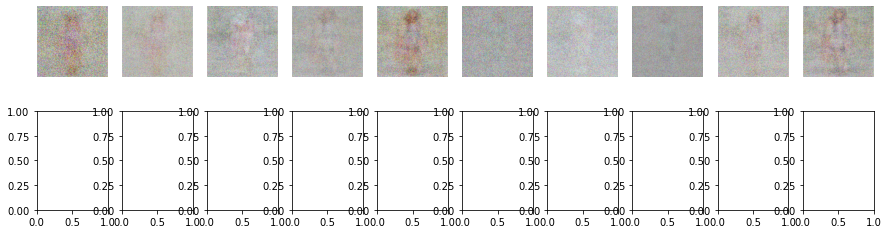

1/1 [==============================] - 0s 39ms/step
2051/10000 [D loss: 29015.841796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2052/10000 [D loss: 31183.275390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
2053/10000 [D loss: 30048.12890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2054/10000 [D loss: 27812.404296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
2055/10000 [D loss: 29366.880859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2056/10000 [D loss: 27049.01171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2057/10000 [D loss: 26623.451171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2058/10000 [D loss: 27871.892578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=====================

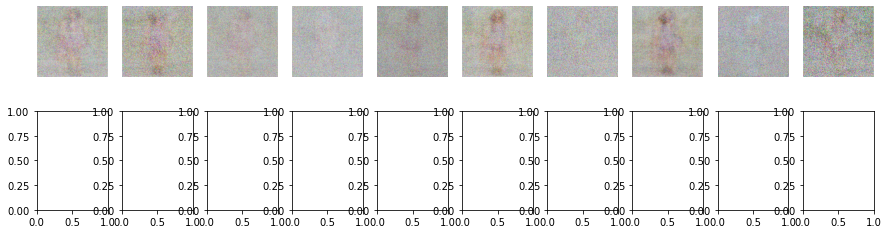

1/1 [==============================] - 0s 32ms/step
2101/10000 [D loss: 36125.4609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
2102/10000 [D loss: 33226.9375 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2103/10000 [D loss: 31037.0078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 150ms/step
2104/10000 [D loss: 31442.85546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2105/10000 [D loss: 33725.19140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2106/10000 [D loss: 30213.28515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2107/10000 [D loss: 27711.5859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2108/10000 [D loss: 25226.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s

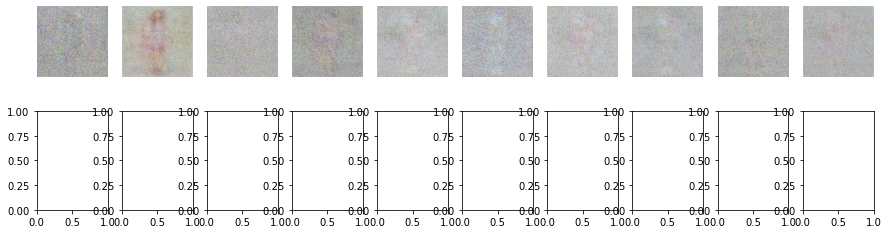

1/1 [==============================] - 0s 32ms/step
2151/10000 [D loss: 72022.734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2152/10000 [D loss: 60297.62890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 29ms/step
2153/10000 [D loss: 66088.5078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2154/10000 [D loss: 64535.71484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
2155/10000 [D loss: 59942.484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
2156/10000 [D loss: 55983.14453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
2157/10000 [D loss: 66329.4140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2158/10000 [D loss: 52609.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 8

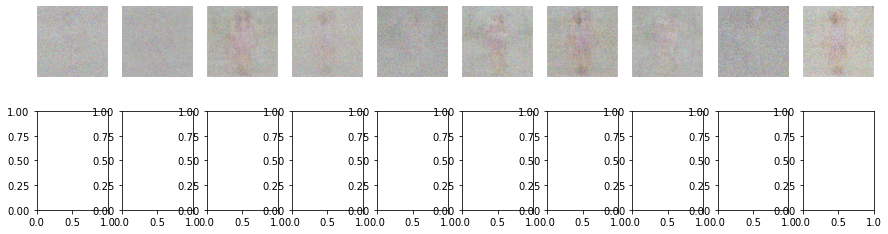

1/1 [==============================] - 0s 35ms/step
2201/10000 [D loss: 23022.943359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2202/10000 [D loss: 19796.263671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
2203/10000 [D loss: 19402.6640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2204/10000 [D loss: 19545.9609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
2205/10000 [D loss: 17617.810546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2206/10000 [D loss: 16494.78515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2207/10000 [D loss: 15087.4814453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
2208/10000 [D loss: 16203.85546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [========================

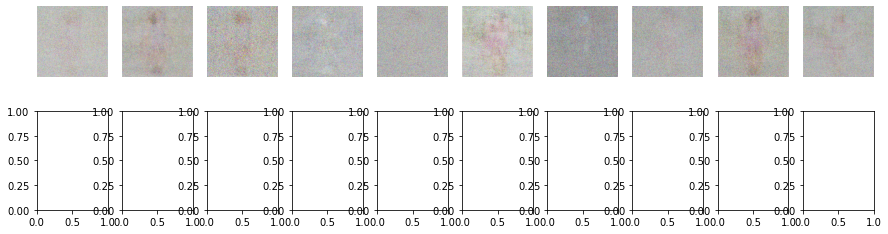

1/1 [==============================] - 0s 30ms/step
2251/10000 [D loss: 25346.7265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2252/10000 [D loss: 23033.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2253/10000 [D loss: 22776.01953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
2254/10000 [D loss: 21061.22265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2255/10000 [D loss: 22256.140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2256/10000 [D loss: 18704.849609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2257/10000 [D loss: 21009.5390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2258/10000 [D loss: 21768.705078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] -

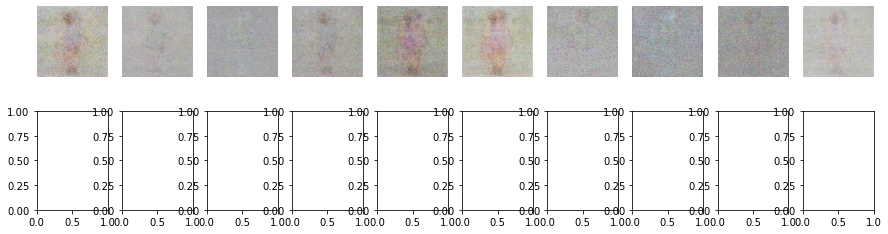

1/1 [==============================] - 0s 31ms/step
2301/10000 [D loss: 29034.990234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2302/10000 [D loss: 29672.283203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2303/10000 [D loss: 32990.58984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2304/10000 [D loss: 30328.32421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2305/10000 [D loss: 27963.55078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2306/10000 [D loss: 26892.85546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
2307/10000 [D loss: 29928.17578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 50ms/step
2308/10000 [D loss: 24788.2734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==========================

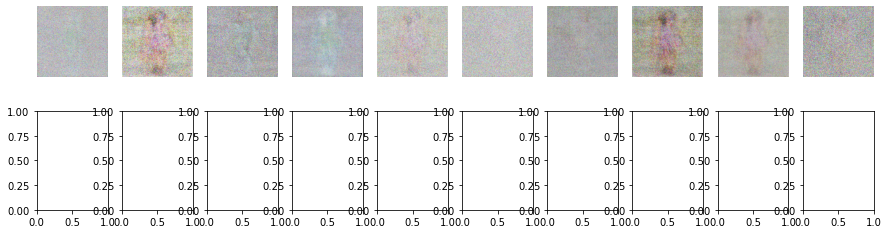

1/1 [==============================] - 0s 42ms/step
2351/10000 [D loss: 8063.62744140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2352/10000 [D loss: 8846.259765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2353/10000 [D loss: 7616.49658203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2354/10000 [D loss: 6332.224609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
2355/10000 [D loss: 6094.26513671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2356/10000 [D loss: 5040.4345703125 | D accuracy: 50.0] [G loss: 335.3957214355469]
1/1 [==============================] - 0s 31ms/step
2357/10000 [D loss: 4100.80078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2358/10000 [D loss: 3669.6494140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [======

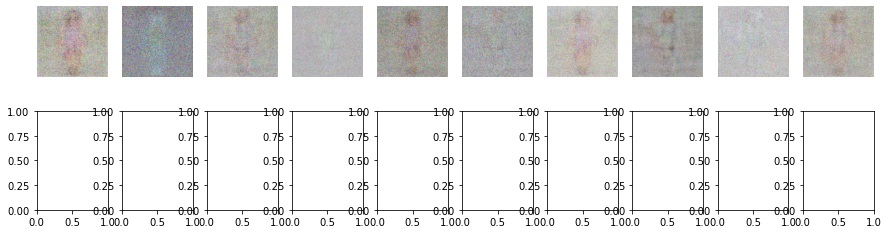

1/1 [==============================] - 0s 31ms/step
2401/10000 [D loss: 5681.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
2402/10000 [D loss: 4503.6513671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2403/10000 [D loss: 3069.3486328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2404/10000 [D loss: 3330.4462890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2405/10000 [D loss: 2516.22900390625 | D accuracy: 50.0] [G loss: 9.205667495727539]
1/1 [==============================] - 0s 34ms/step
2406/10000 [D loss: 1616.3377685546875 | D accuracy: 50.0] [G loss: 0.8512192368507385]
1/1 [==============================] - 0s 29ms/step
2407/10000 [D loss: 702.9326171875 | D accuracy: 50.0] [G loss: 113.7548828125]
1/1 [==============================] - 0s 39ms/step
2408/10000 [D loss: 24766.255859375 | D accuracy: 43.75]

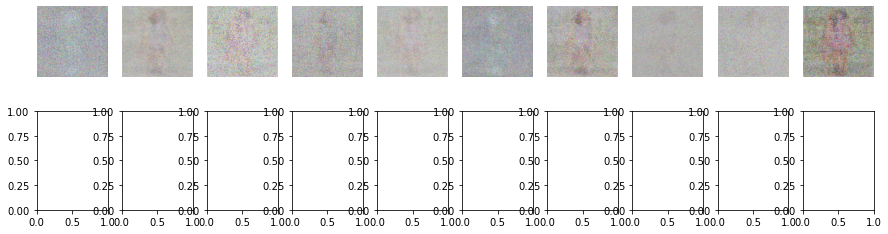

1/1 [==============================] - 0s 32ms/step
2451/10000 [D loss: 98266.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2452/10000 [D loss: 103188.546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
2453/10000 [D loss: 108188.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
2454/10000 [D loss: 98890.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
2455/10000 [D loss: 96428.0859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
2456/10000 [D loss: 99799.609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2457/10000 [D loss: 92351.046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2458/10000 [D loss: 90029.953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/s

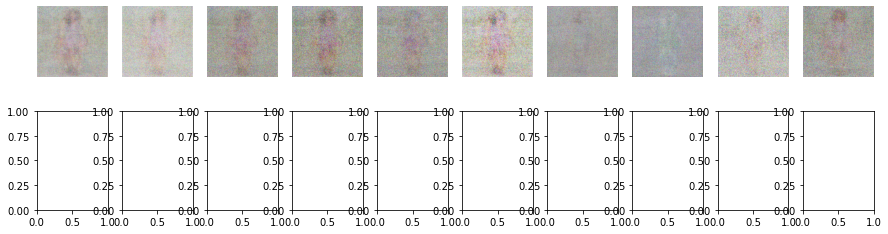

1/1 [==============================] - 0s 37ms/step
2501/10000 [D loss: 45176.2890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2502/10000 [D loss: 44295.765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2503/10000 [D loss: 42087.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
2504/10000 [D loss: 36292.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2505/10000 [D loss: 36084.2109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
2506/10000 [D loss: 31152.568359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2507/10000 [D loss: 31047.78515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2508/10000 [D loss: 27685.642578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s

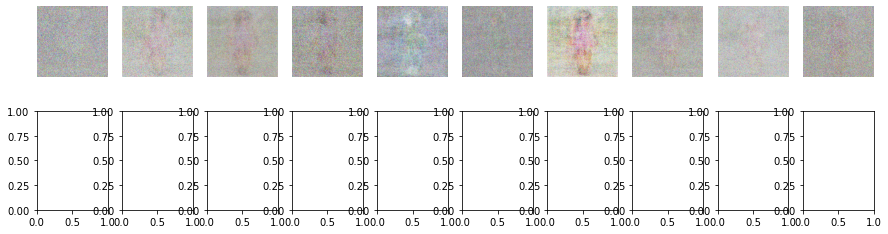

1/1 [==============================] - 0s 44ms/step
2551/10000 [D loss: 164771.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
2552/10000 [D loss: 171164.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2553/10000 [D loss: 154419.21875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2554/10000 [D loss: 163566.671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2555/10000 [D loss: 152130.609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2556/10000 [D loss: 143397.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2557/10000 [D loss: 148716.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2558/10000 [D loss: 145054.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/

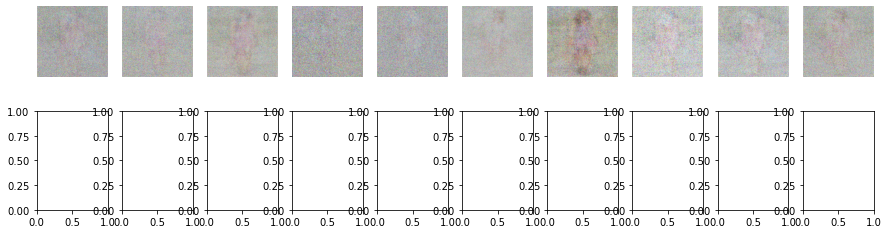

1/1 [==============================] - 0s 31ms/step
2601/10000 [D loss: 75315.2109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2602/10000 [D loss: 72720.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2603/10000 [D loss: 65304.234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2604/10000 [D loss: 66624.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2605/10000 [D loss: 56961.1640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
2606/10000 [D loss: 57629.234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2607/10000 [D loss: 58644.79296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2608/10000 [D loss: 58781.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/st

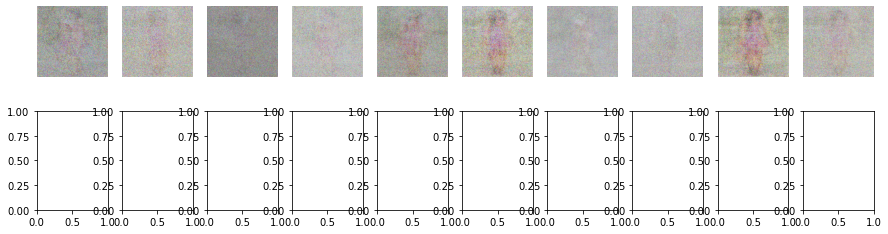

1/1 [==============================] - 0s 40ms/step
2651/10000 [D loss: 251284.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 127ms/step
2652/10000 [D loss: 260969.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2653/10000 [D loss: 237061.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2654/10000 [D loss: 249910.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2655/10000 [D loss: 236832.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2656/10000 [D loss: 230726.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
2657/10000 [D loss: 249981.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
2658/10000 [D loss: 229578.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
265

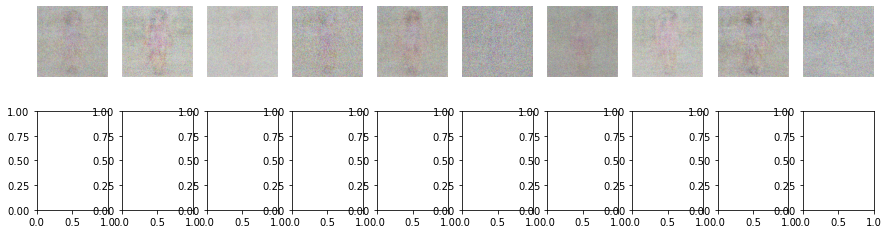

1/1 [==============================] - 0s 38ms/step
2701/10000 [D loss: 154458.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2702/10000 [D loss: 168355.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
2703/10000 [D loss: 140098.265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2704/10000 [D loss: 151905.3125 | D accuracy: 50.0] [G loss: 955.70458984375]
1/1 [==============================] - 0s 32ms/step
2705/10000 [D loss: 148922.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2706/10000 [D loss: 132659.890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2707/10000 [D loss: 144503.46875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2708/10000 [D loss: 143064.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 

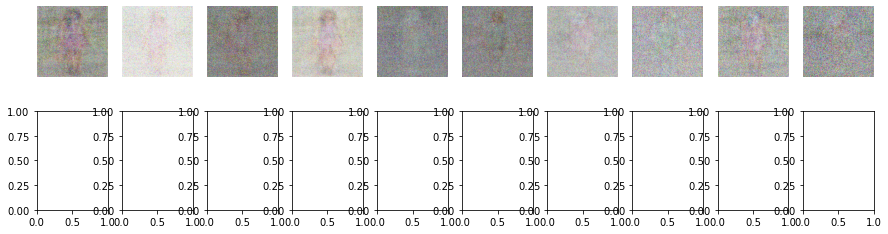

1/1 [==============================] - 0s 31ms/step
2751/10000 [D loss: 323547.375 | D accuracy: 53.125] [G loss: 66993.5703125]
1/1 [==============================] - 0s 33ms/step
2752/10000 [D loss: 294578.25 | D accuracy: 50.0] [G loss: 6035.3779296875]
1/1 [==============================] - 0s 35ms/step
2753/10000 [D loss: 285937.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2754/10000 [D loss: 197418.6875 | D accuracy: 53.125] [G loss: 1593.9588623046875]
1/1 [==============================] - 0s 38ms/step
2755/10000 [D loss: 257519.609375 | D accuracy: 59.375] [G loss: 28728.171875]
1/1 [==============================] - 0s 30ms/step
2756/10000 [D loss: 349298.40625 | D accuracy: 56.25] [G loss: 14216.3984375]
1/1 [==============================] - 0s 33ms/step
2757/10000 [D loss: 301477.25 | D accuracy: 53.125] [G loss: 41116.5703125]
1/1 [==============================] - 0s 36ms/step
2758/10000 [D loss: 251464.59375 | D accuracy: 5

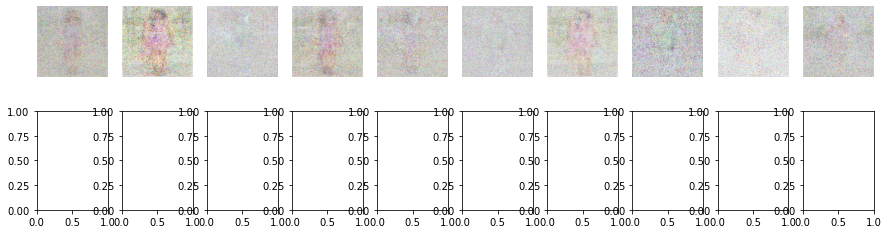

1/1 [==============================] - 0s 32ms/step
2801/10000 [D loss: 186723.359375 | D accuracy: 50.0] [G loss: 7690.89013671875]
1/1 [==============================] - 0s 34ms/step
2802/10000 [D loss: 169358.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
2803/10000 [D loss: 155412.90625 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2804/10000 [D loss: 181678.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
2805/10000 [D loss: 178283.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
2806/10000 [D loss: 151868.234375 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
2807/10000 [D loss: 167362.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2808/10000 [D loss: 162959.3125 | D accuracy: 50.0] [G loss: 14984.9892578125]
1/1 [=============

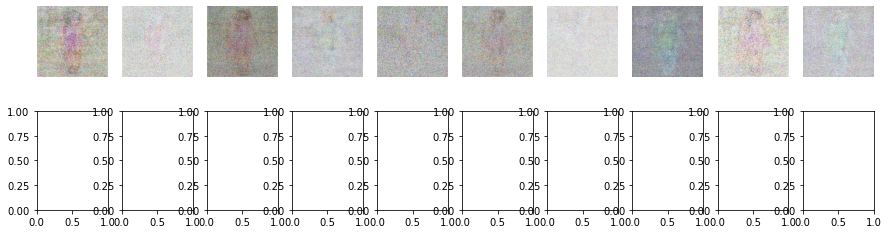

1/1 [==============================] - 0s 30ms/step
2851/10000 [D loss: 241936.421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2852/10000 [D loss: 257837.703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2853/10000 [D loss: 255212.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
2854/10000 [D loss: 235278.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2855/10000 [D loss: 221467.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2856/10000 [D loss: 205011.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
2857/10000 [D loss: 251137.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2858/10000 [D loss: 230913.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
2859/1

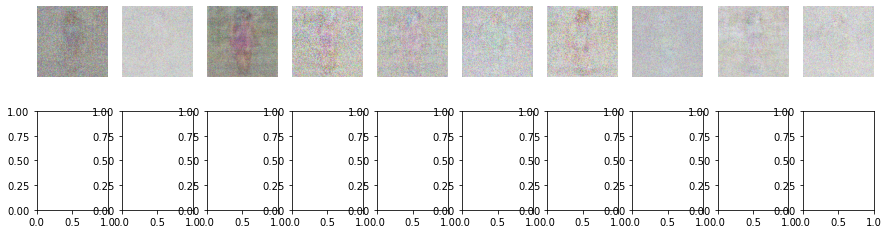

1/1 [==============================] - 0s 31ms/step
2901/10000 [D loss: 111285.7734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2902/10000 [D loss: 117817.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
2903/10000 [D loss: 123514.703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2904/10000 [D loss: 112489.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
2905/10000 [D loss: 104315.359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
2906/10000 [D loss: 105161.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2907/10000 [D loss: 94513.546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2908/10000 [D loss: 101686.203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35m

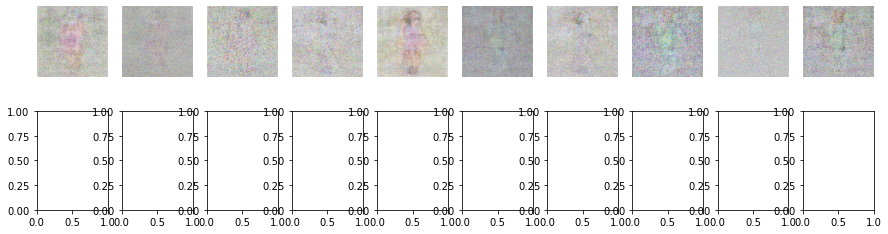

1/1 [==============================] - 0s 36ms/step
2951/10000 [D loss: 9432.2822265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
2952/10000 [D loss: 5634.4169921875 | D accuracy: 50.0] [G loss: 181.26358032226562]
1/1 [==============================] - 0s 38ms/step
2953/10000 [D loss: 3954.81982421875 | D accuracy: 53.125] [G loss: 200.214111328125]
1/1 [==============================] - 0s 33ms/step
2954/10000 [D loss: 1310.642578125 | D accuracy: 62.5] [G loss: 1268.49755859375]
1/1 [==============================] - 0s 32ms/step
2955/10000 [D loss: 21522.218994140625 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2956/10000 [D loss: 32854.1328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
2957/10000 [D loss: 30433.63671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
2958/10000 [D loss: 34284.83984375 | D accuracy: 

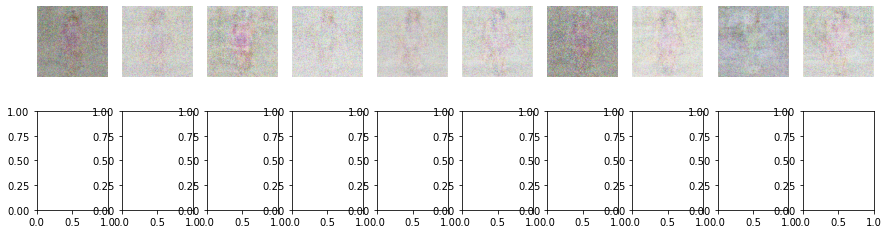

1/1 [==============================] - 0s 37ms/step
3001/10000 [D loss: 422891.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3002/10000 [D loss: 359088.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
3003/10000 [D loss: 409105.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
3004/10000 [D loss: 367774.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3005/10000 [D loss: 399847.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3006/10000 [D loss: 413117.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3007/10000 [D loss: 357340.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
3008/10000 [D loss: 335392.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3009/10

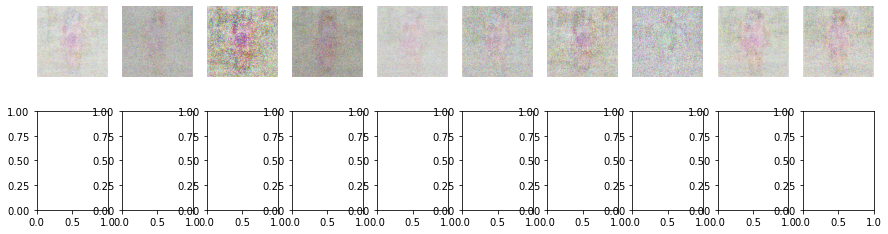

1/1 [==============================] - 0s 32ms/step
3051/10000 [D loss: 234785.984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3052/10000 [D loss: 278243.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3053/10000 [D loss: 257703.609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3054/10000 [D loss: 229036.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3055/10000 [D loss: 220862.328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3056/10000 [D loss: 207934.90625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3057/10000 [D loss: 259656.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3058/10000 [D loss: 238463.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
30

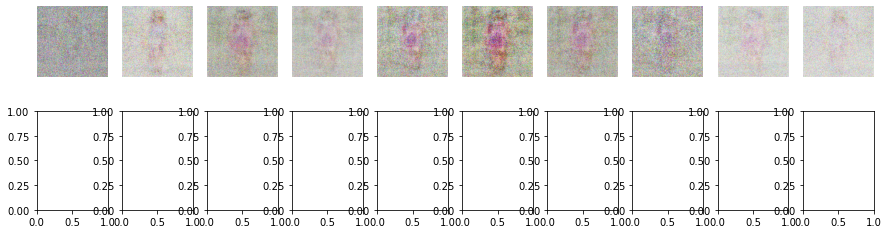

1/1 [==============================] - 0s 31ms/step
3101/10000 [D loss: 35112.1328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3102/10000 [D loss: 25615.984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
3103/10000 [D loss: 24049.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3104/10000 [D loss: 16810.587890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3105/10000 [D loss: 6376.3173828125 | D accuracy: 50.0] [G loss: 108.01602935791016]
1/1 [==============================] - 0s 33ms/step
3106/10000 [D loss: 884.3506469726562 | D accuracy: 62.5] [G loss: 8257.0341796875]
1/1 [==============================] - 0s 33ms/step
3107/10000 [D loss: 1412867.65625 | D accuracy: 0.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
3108/10000 [D loss: 412102.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=====

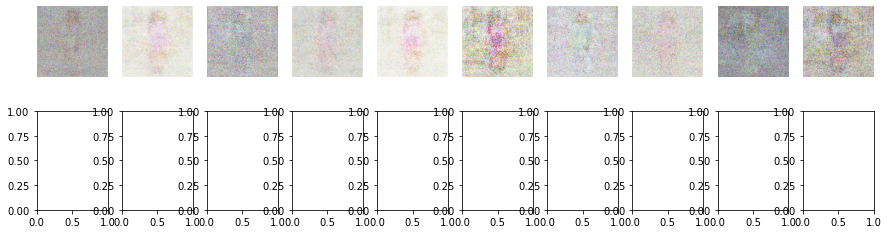

1/1 [==============================] - 0s 38ms/step
3151/10000 [D loss: 365615.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
3152/10000 [D loss: 363755.625 | D accuracy: 50.0] [G loss: 179.7474365234375]
1/1 [==============================] - 0s 32ms/step
3153/10000 [D loss: 385273.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3154/10000 [D loss: 347663.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
3155/10000 [D loss: 377955.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
3156/10000 [D loss: 344494.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3157/10000 [D loss: 337193.78125 | D accuracy: 53.125] [G loss: 23095.951171875]
1/1 [==============================] - 0s 33ms/step
3158/10000 [D loss: 388091.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=============================

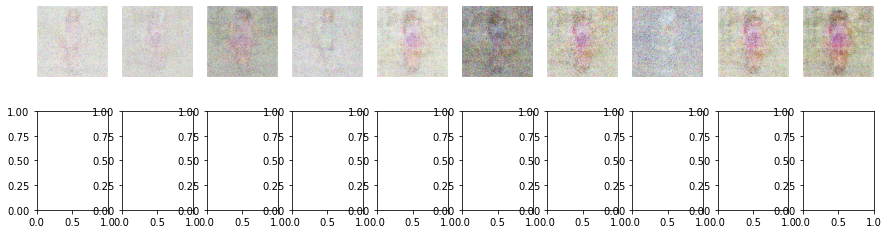

1/1 [==============================] - 0s 31ms/step
3201/10000 [D loss: 53330.6953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
3202/10000 [D loss: 56106.9296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3203/10000 [D loss: 46333.8046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3204/10000 [D loss: 37702.9296875 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
3205/10000 [D loss: 36584.55078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3206/10000 [D loss: 23416.63671875 | D accuracy: 50.0] [G loss: 241.60128784179688]
1/1 [==============================] - 0s 118ms/step
3207/10000 [D loss: 23816.16796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
3208/10000 [D loss: 14349.5 | D accuracy: 50.0] [G loss: 5.705530166625977]
1/1 [======

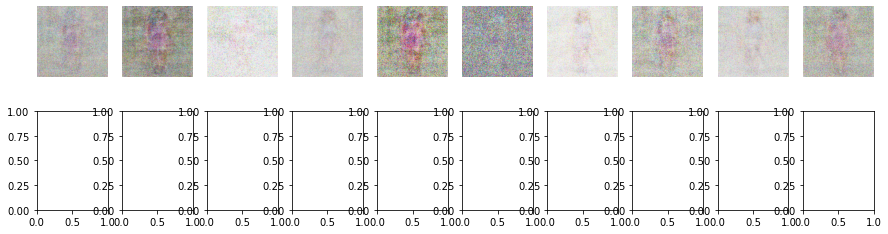

1/1 [==============================] - 0s 32ms/step
3251/10000 [D loss: 40658.09765625 | D accuracy: 50.0] [G loss: 10393.0068359375]
1/1 [==============================] - 0s 34ms/step
3252/10000 [D loss: 34650.33984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3253/10000 [D loss: 29551.46875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3254/10000 [D loss: 22270.8515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
3255/10000 [D loss: 20574.142578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3256/10000 [D loss: 13466.376953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3257/10000 [D loss: 11114.62109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3258/10000 [D loss: 6551.0322265625 | D accuracy: 50.0] [G loss: 256.66253662109375]
1/1 [

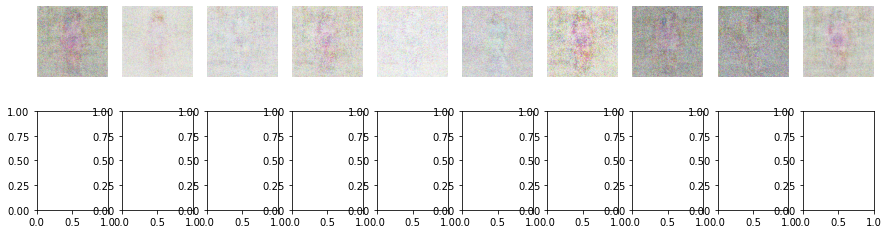

1/1 [==============================] - 0s 30ms/step
3301/10000 [D loss: 319558.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3302/10000 [D loss: 277068.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
3303/10000 [D loss: 327175.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3304/10000 [D loss: 294005.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3305/10000 [D loss: 300906.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3306/10000 [D loss: 275186.21875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3307/10000 [D loss: 249891.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3308/10000 [D loss: 280646.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3309/10000 

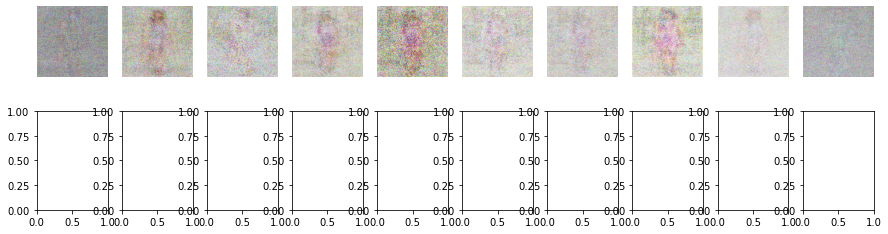

1/1 [==============================] - 0s 32ms/step
3351/10000 [D loss: 76211.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3352/10000 [D loss: 64537.3203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
3353/10000 [D loss: 65980.140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3354/10000 [D loss: 48211.9609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
3355/10000 [D loss: 49608.0859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
3356/10000 [D loss: 33771.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
3357/10000 [D loss: 26897.86328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3358/10000 [D loss: 20686.45703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms

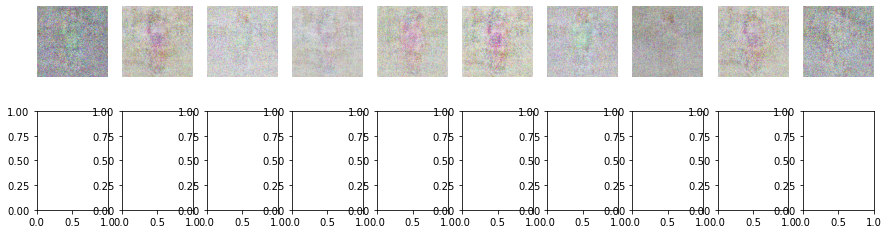

1/1 [==============================] - 0s 39ms/step
3401/10000 [D loss: 84703.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3402/10000 [D loss: 86472.3359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
3403/10000 [D loss: 94736.953125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
3404/10000 [D loss: 79679.2109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 50ms/step
3405/10000 [D loss: 70679.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3406/10000 [D loss: 64081.84765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3407/10000 [D loss: 60773.578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3408/10000 [D loss: 61722.421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/s

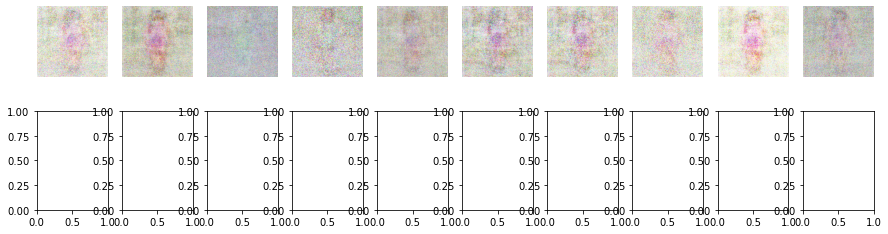

1/1 [==============================] - 0s 32ms/step
3451/10000 [D loss: 24058.79296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3452/10000 [D loss: 19507.74609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
3453/10000 [D loss: 16399.140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3454/10000 [D loss: 10671.60546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3455/10000 [D loss: 7177.12890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3456/10000 [D loss: 2812.0458984375 | D accuracy: 50.0] [G loss: 1261.13720703125]
1/1 [==============================] - 0s 36ms/step
3457/10000 [D loss: 162373.42578125 | D accuracy: 37.5] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3458/10000 [D loss: 240376.328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [================

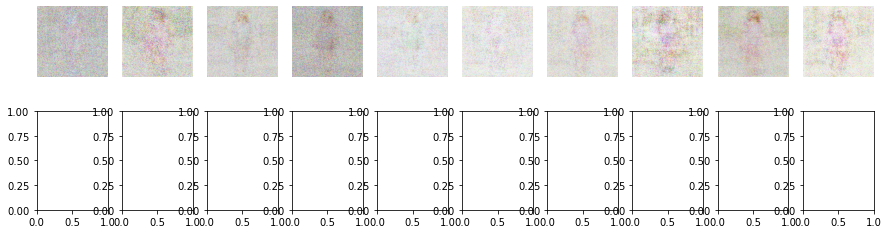

1/1 [==============================] - 0s 30ms/step
3501/10000 [D loss: 97719.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3502/10000 [D loss: 99450.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
3503/10000 [D loss: 104146.8046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3504/10000 [D loss: 81011.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3505/10000 [D loss: 77719.5234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3506/10000 [D loss: 82619.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3507/10000 [D loss: 72689.671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3508/10000 [D loss: 70451.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3509

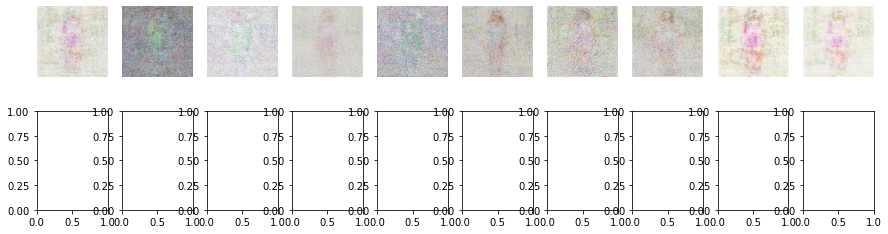

1/1 [==============================] - 0s 32ms/step
3551/10000 [D loss: 22480.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3552/10000 [D loss: 19067.60546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3553/10000 [D loss: 14858.6923828125 | D accuracy: 50.0] [G loss: 68.96448516845703]
1/1 [==============================] - 0s 34ms/step
3554/10000 [D loss: 12703.65234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3555/10000 [D loss: 7573.6669921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
3556/10000 [D loss: 3865.348388671875 | D accuracy: 50.0] [G loss: 14.094695091247559]
1/1 [==============================] - 0s 36ms/step
3557/10000 [D loss: 66673.390625 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
3558/10000 [D loss: 49107.1328125 | D accuracy: 50.0] [G loss: 0.0]
1

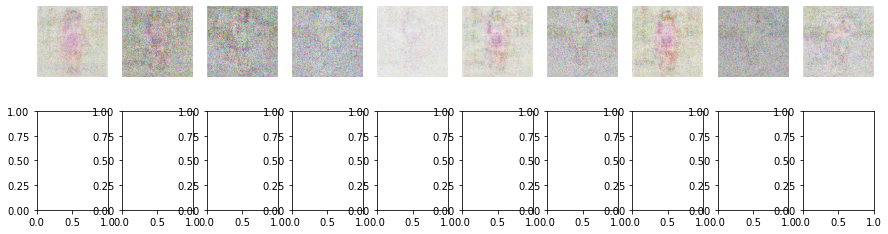

1/1 [==============================] - 0s 32ms/step
3601/10000 [D loss: 161539.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
3602/10000 [D loss: 170458.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3603/10000 [D loss: 161641.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3604/10000 [D loss: 154526.328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
3605/10000 [D loss: 136411.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3606/10000 [D loss: 150950.6875 | D accuracy: 50.0] [G loss: 9779.7294921875]
1/1 [==============================] - 0s 32ms/step
3607/10000 [D loss: 144492.671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3608/10000 [D loss: 144105.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0

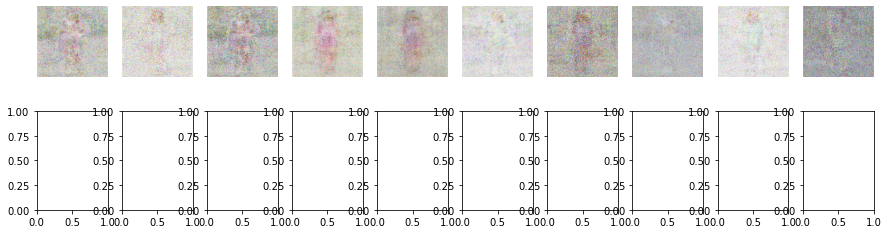

1/1 [==============================] - 0s 33ms/step
3651/10000 [D loss: 31757.140625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3652/10000 [D loss: 27427.7890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3653/10000 [D loss: 23236.49609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3654/10000 [D loss: 17993.169921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3655/10000 [D loss: 14534.791015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3656/10000 [D loss: 11850.33203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3657/10000 [D loss: 8083.5205078125 | D accuracy: 50.0] [G loss: 27.97963523864746]
1/1 [==============================] - 0s 39ms/step
3658/10000 [D loss: 4419.96435546875 | D accuracy: 50.0] [G loss: 70.65284729003906]
1/

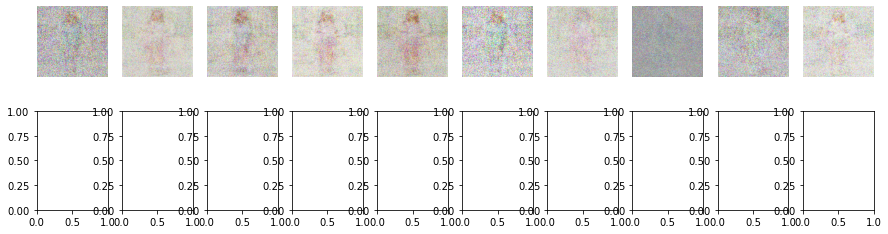

1/1 [==============================] - 0s 33ms/step
3701/10000 [D loss: 476344.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
3702/10000 [D loss: 555980.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3703/10000 [D loss: 619786.0 | D accuracy: 50.0] [G loss: 1974.147705078125]
1/1 [==============================] - 0s 40ms/step
3704/10000 [D loss: 564791.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3705/10000 [D loss: 543634.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3706/10000 [D loss: 581682.125 | D accuracy: 50.0] [G loss: 16211.0927734375]
1/1 [==============================] - 0s 33ms/step
3707/10000 [D loss: 610167.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
3708/10000 [D loss: 518941.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] -

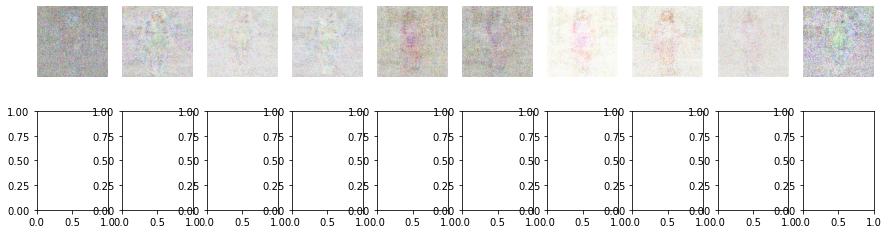

1/1 [==============================] - 0s 30ms/step
3751/10000 [D loss: 914290.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3752/10000 [D loss: 913326.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
3753/10000 [D loss: 966698.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
3754/10000 [D loss: 826342.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
3755/10000 [D loss: 813315.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3756/10000 [D loss: 943194.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3757/10000 [D loss: 831452.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 50ms/step
3758/10000 [D loss: 948837.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3759/1000

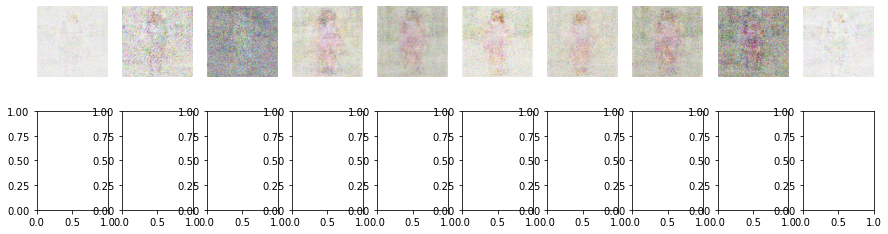

1/1 [==============================] - 0s 30ms/step
3801/10000 [D loss: 781272.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3802/10000 [D loss: 762442.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3803/10000 [D loss: 642857.75 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3804/10000 [D loss: 694634.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3805/10000 [D loss: 724558.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3806/10000 [D loss: 708019.375 | D accuracy: 50.0] [G loss: 123246.71875]
1/1 [==============================] - 0s 36ms/step
3807/10000 [D loss: 666138.5 | D accuracy: 50.0] [G loss: 25014.720703125]
1/1 [==============================] - 0s 42ms/step
3808/10000 [D loss: 756519.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 

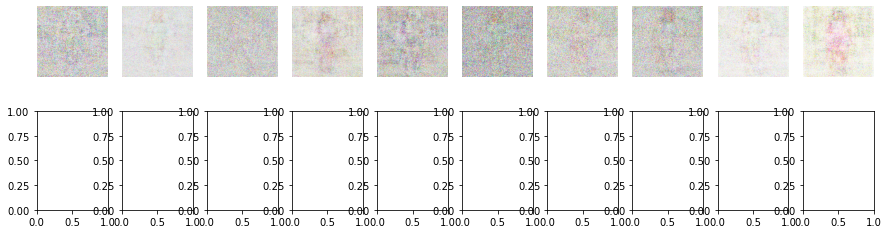

1/1 [==============================] - 0s 43ms/step
3851/10000 [D loss: 136834.0625 | D accuracy: 50.0] [G loss: 9847.0390625]
1/1 [==============================] - 0s 35ms/step
3852/10000 [D loss: 118182.859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3853/10000 [D loss: 90236.0078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3854/10000 [D loss: 73313.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3855/10000 [D loss: 54066.43359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3856/10000 [D loss: 24950.3046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3857/10000 [D loss: 3631.57958984375 | D accuracy: 59.375] [G loss: 26169.9453125]
1/1 [==============================] - 0s 34ms/step
3858/10000 [D loss: 3008554.75 | D accuracy: 0.0] [G loss: 0.0]
1/1 [======================

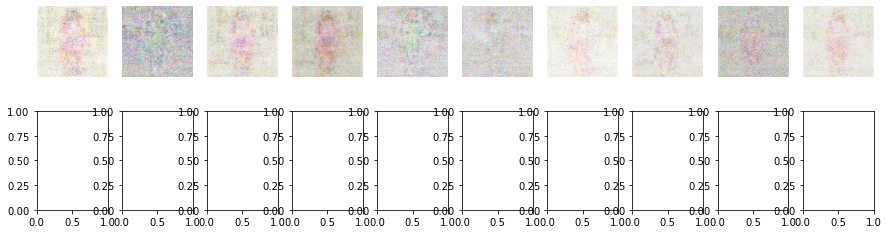

1/1 [==============================] - 0s 32ms/step
3901/10000 [D loss: 688381.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
3902/10000 [D loss: 674331.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
3903/10000 [D loss: 627240.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3904/10000 [D loss: 652526.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3905/10000 [D loss: 637917.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
3906/10000 [D loss: 662175.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3907/10000 [D loss: 605656.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
3908/10000 [D loss: 606255.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3909/10000 [

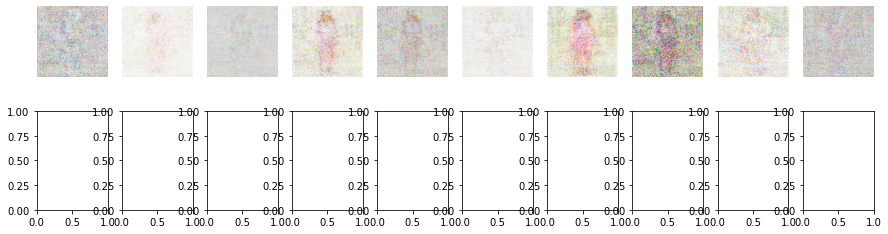

1/1 [==============================] - 0s 33ms/step
3951/10000 [D loss: 272222.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3952/10000 [D loss: 207612.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
3953/10000 [D loss: 203063.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
3954/10000 [D loss: 192487.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
3955/10000 [D loss: 184117.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
3956/10000 [D loss: 158372.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
3957/10000 [D loss: 134103.859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
3958/10000 [D loss: 124779.984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
395

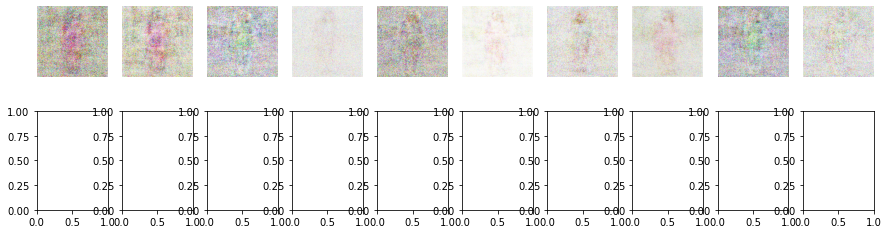

1/1 [==============================] - 0s 34ms/step
4001/10000 [D loss: 437756.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4002/10000 [D loss: 417872.6875 | D accuracy: 50.0] [G loss: 7771.37548828125]
1/1 [==============================] - 0s 34ms/step
4003/10000 [D loss: 480445.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4004/10000 [D loss: 445127.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
4005/10000 [D loss: 419553.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4006/10000 [D loss: 443334.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4007/10000 [D loss: 430910.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4008/10000 [D loss: 466100.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/s

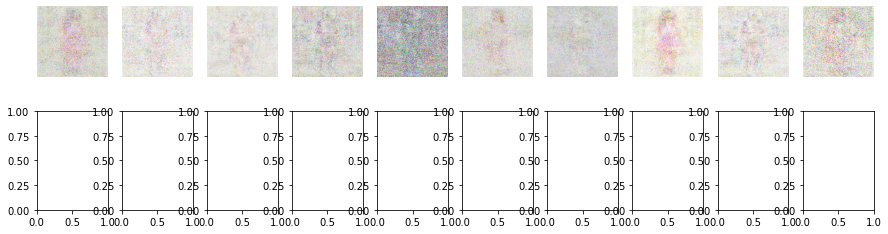

1/1 [==============================] - 0s 62ms/step
4051/10000 [D loss: 206420.484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
4052/10000 [D loss: 189772.734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
4053/10000 [D loss: 209459.90625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4054/10000 [D loss: 183599.578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
4055/10000 [D loss: 165206.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4056/10000 [D loss: 154594.828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4057/10000 [D loss: 156605.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4058/10000 [D loss: 160760.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/st

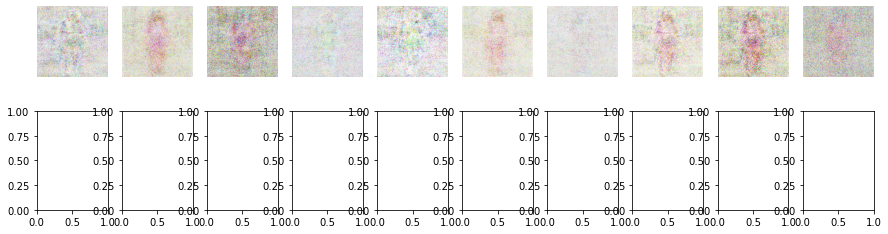

1/1 [==============================] - 0s 31ms/step
4101/10000 [D loss: 24448.890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4102/10000 [D loss: 19381.1328125 | D accuracy: 50.0] [G loss: 7.073593616485596]
1/1 [==============================] - 0s 36ms/step
4103/10000 [D loss: 15917.0498046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 49ms/step
4104/10000 [D loss: 9198.982421875 | D accuracy: 50.0] [G loss: 251.51336669921875]
1/1 [==============================] - 0s 31ms/step
4105/10000 [D loss: 55394.46875 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4106/10000 [D loss: 35084.33984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4107/10000 [D loss: 37869.83203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
4108/10000 [D loss: 30772.91015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [

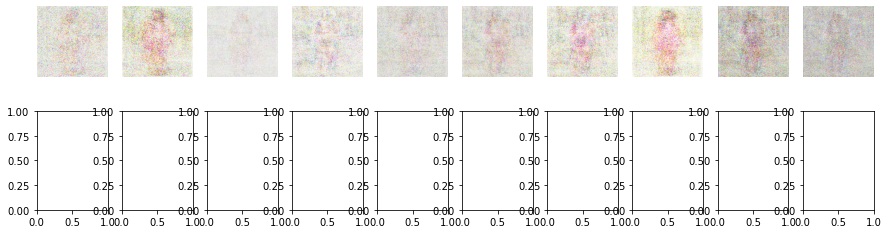

1/1 [==============================] - 0s 34ms/step
4151/10000 [D loss: 157301.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4152/10000 [D loss: 158111.015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4153/10000 [D loss: 154588.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
4154/10000 [D loss: 144111.46875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4155/10000 [D loss: 137251.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4156/10000 [D loss: 130456.734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
4157/10000 [D loss: 135032.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
4158/10000 [D loss: 134085.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4

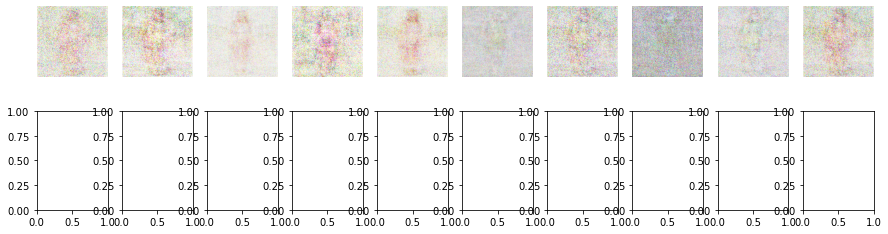

1/1 [==============================] - 0s 31ms/step
4201/10000 [D loss: 460776.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 59ms/step
4202/10000 [D loss: 458379.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4203/10000 [D loss: 479363.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4204/10000 [D loss: 435443.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4205/10000 [D loss: 433477.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4206/10000 [D loss: 443029.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4207/10000 [D loss: 429406.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4208/10000 [D loss: 431631.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4209/100

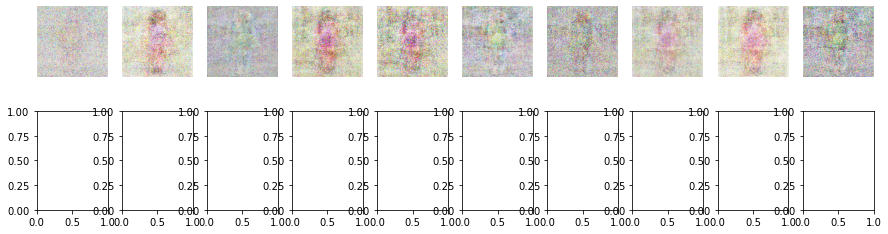

1/1 [==============================] - 0s 31ms/step
4251/10000 [D loss: 186101.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4252/10000 [D loss: 159573.578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4253/10000 [D loss: 153950.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4254/10000 [D loss: 165569.859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4255/10000 [D loss: 162756.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
4256/10000 [D loss: 136804.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4257/10000 [D loss: 129245.015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4258/10000 [D loss: 135566.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4259

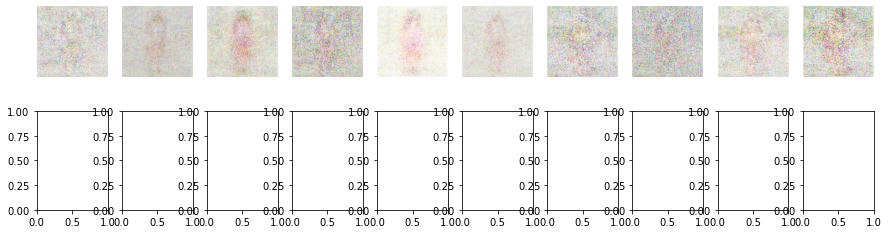

1/1 [==============================] - 0s 34ms/step
4301/10000 [D loss: 350028.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4302/10000 [D loss: 413728.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
4303/10000 [D loss: 341051.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
4304/10000 [D loss: 384600.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4305/10000 [D loss: 370138.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4306/10000 [D loss: 362425.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4307/10000 [D loss: 382576.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4308/10000 [D loss: 345978.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4309

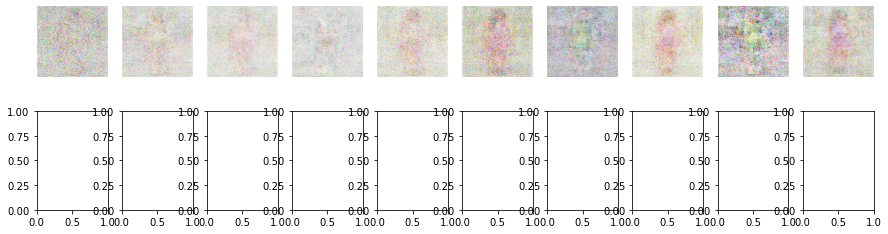

1/1 [==============================] - 0s 42ms/step
4351/10000 [D loss: 86124.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4352/10000 [D loss: 74636.3671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4353/10000 [D loss: 72424.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4354/10000 [D loss: 78651.921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4355/10000 [D loss: 61492.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4356/10000 [D loss: 61959.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4357/10000 [D loss: 54216.3515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4358/10000 [D loss: 50061.90234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/st

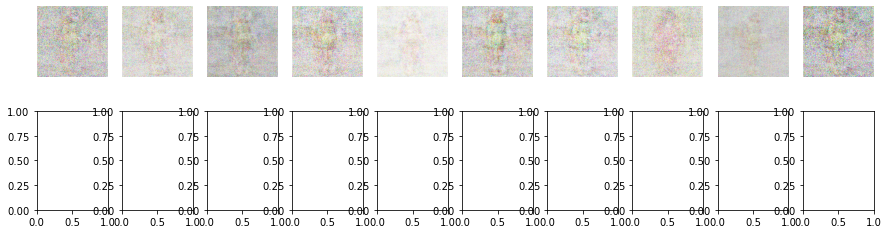

1/1 [==============================] - 0s 33ms/step
4401/10000 [D loss: 97287.4921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4402/10000 [D loss: 91764.8671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 76ms/step
4403/10000 [D loss: 88037.828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4404/10000 [D loss: 85161.6015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4405/10000 [D loss: 74026.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
4406/10000 [D loss: 61471.515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4407/10000 [D loss: 65702.421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4408/10000 [D loss: 51900.2578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47m

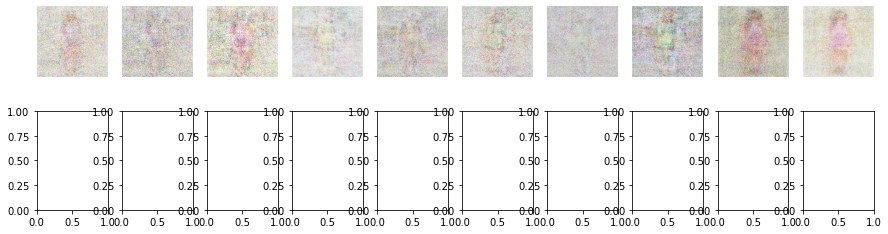

1/1 [==============================] - 0s 49ms/step
4451/10000 [D loss: 558246.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4452/10000 [D loss: 646552.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4453/10000 [D loss: 583037.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4454/10000 [D loss: 565583.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4455/10000 [D loss: 568106.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4456/10000 [D loss: 527330.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4457/10000 [D loss: 541118.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4458/10000 [D loss: 536940.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4459/10000

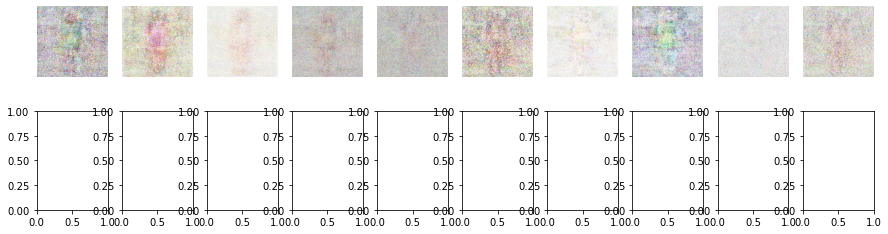

1/1 [==============================] - 0s 30ms/step
4501/10000 [D loss: 276030.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4502/10000 [D loss: 273202.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4503/10000 [D loss: 306589.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4504/10000 [D loss: 281173.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4505/10000 [D loss: 272454.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
4506/10000 [D loss: 281996.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4507/10000 [D loss: 270682.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4508/10000 [D loss: 250215.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4509

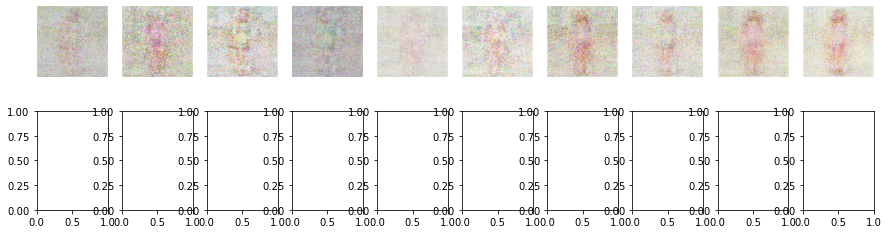

1/1 [==============================] - 0s 49ms/step
4551/10000 [D loss: 712277.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4552/10000 [D loss: 700412.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4553/10000 [D loss: 789957.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
4554/10000 [D loss: 760479.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
4555/10000 [D loss: 716128.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
4556/10000 [D loss: 664495.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4557/10000 [D loss: 623370.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4558/10000 [D loss: 708873.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
4559/10000 [D lo

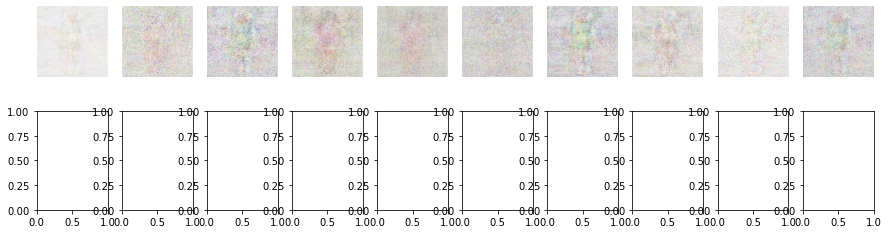

1/1 [==============================] - 0s 33ms/step
4601/10000 [D loss: 441363.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 82ms/step
4602/10000 [D loss: 452327.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4603/10000 [D loss: 436924.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4604/10000 [D loss: 426855.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4605/10000 [D loss: 443412.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4606/10000 [D loss: 422247.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4607/10000 [D loss: 403557.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4608/10000 [D loss: 382286.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
4609

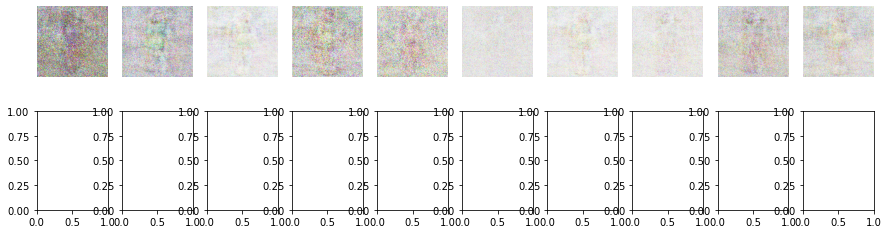

1/1 [==============================] - 0s 31ms/step
4651/10000 [D loss: 179833.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
4652/10000 [D loss: 194942.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4653/10000 [D loss: 163863.859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4654/10000 [D loss: 179204.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4655/10000 [D loss: 160393.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4656/10000 [D loss: 145587.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4657/10000 [D loss: 142770.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
4658/10000 [D loss: 153161.921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/

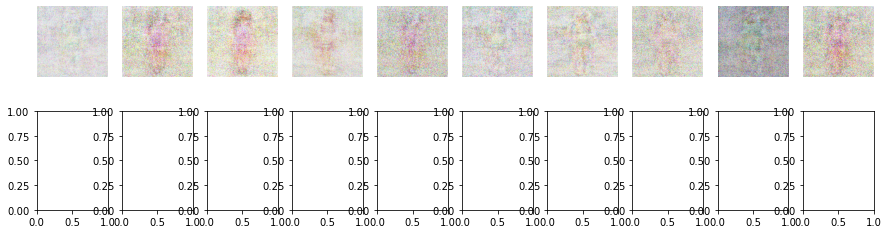

1/1 [==============================] - 0s 36ms/step
4701/10000 [D loss: 489109.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
4702/10000 [D loss: 481822.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
4703/10000 [D loss: 544503.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4704/10000 [D loss: 508179.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4705/10000 [D loss: 510005.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
4706/10000 [D loss: 457067.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4707/10000 [D loss: 498444.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4708/10000 [D loss: 459294.46875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4709/1000

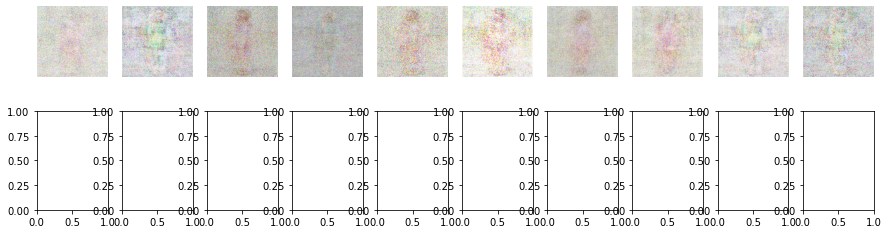

1/1 [==============================] - 0s 39ms/step
4751/10000 [D loss: 196030.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4752/10000 [D loss: 201287.21875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4753/10000 [D loss: 187835.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
4754/10000 [D loss: 184045.203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4755/10000 [D loss: 151307.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4756/10000 [D loss: 162142.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
4757/10000 [D loss: 161060.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4758/10000 [D loss: 147026.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4759/100

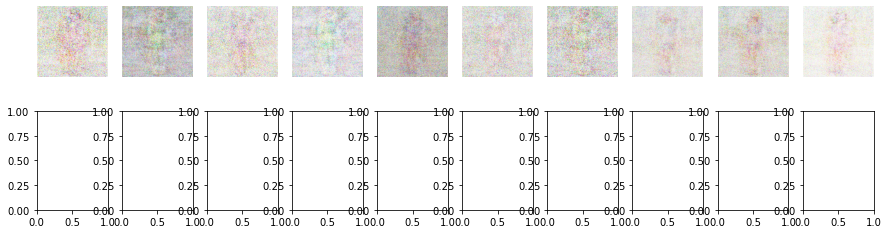

1/1 [==============================] - 0s 31ms/step
4801/10000 [D loss: 804625.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4802/10000 [D loss: 870467.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4803/10000 [D loss: 820292.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
4804/10000 [D loss: 867128.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4805/10000 [D loss: 904594.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4806/10000 [D loss: 790158.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4807/10000 [D loss: 927462.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4808/10000 [D loss: 831032.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4809/10000 [D

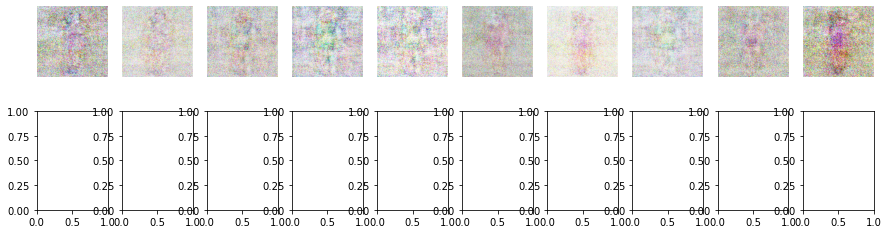

1/1 [==============================] - 0s 32ms/step
4851/10000 [D loss: 997379.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
4852/10000 [D loss: 1158545.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4853/10000 [D loss: 1075956.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4854/10000 [D loss: 1050662.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4855/10000 [D loss: 1152995.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4856/10000 [D loss: 1117970.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
4857/10000 [D loss: 1169117.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
4858/10000 [D loss: 1127173.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
4859/10000 

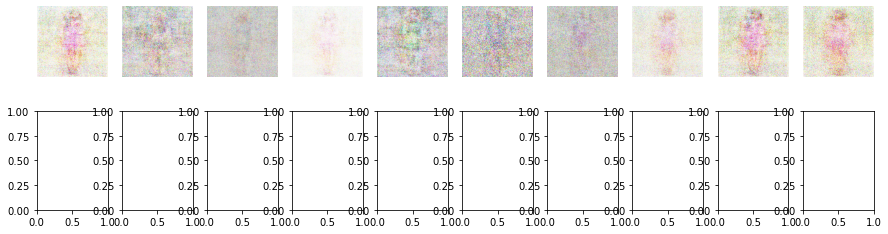

1/1 [==============================] - 0s 35ms/step
4901/10000 [D loss: 702436.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4902/10000 [D loss: 704498.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4903/10000 [D loss: 725476.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4904/10000 [D loss: 690476.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 48ms/step
4905/10000 [D loss: 679866.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4906/10000 [D loss: 707454.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
4907/10000 [D loss: 622009.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4908/10000 [D loss: 685389.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
4909/10000 [D l

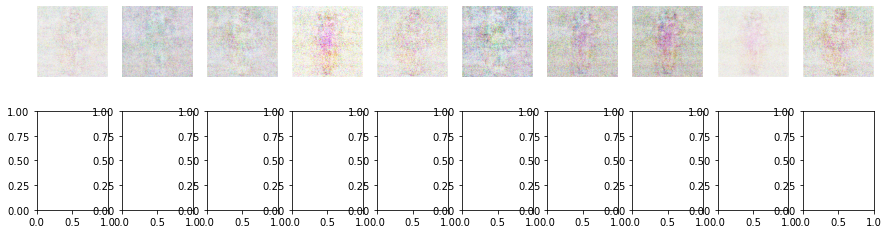

1/1 [==============================] - 0s 33ms/step
4951/10000 [D loss: 1221164.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
4952/10000 [D loss: 1212292.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 59ms/step
4953/10000 [D loss: 1170580.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
4954/10000 [D loss: 1126127.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4955/10000 [D loss: 1080864.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4956/10000 [D loss: 1102871.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
4957/10000 [D loss: 1088471.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
4958/10000 [D loss: 1078732.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
4959/10000 [

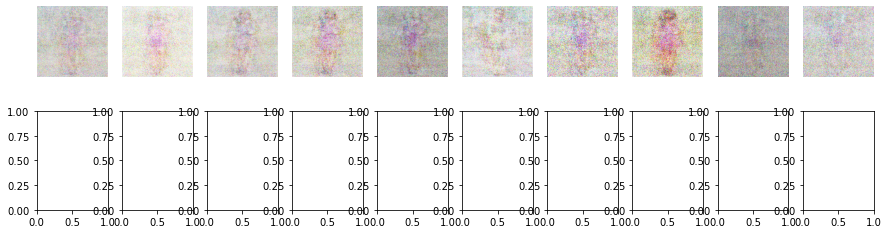

1/1 [==============================] - 0s 32ms/step
5001/10000 [D loss: 741226.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
5002/10000 [D loss: 731477.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5003/10000 [D loss: 764125.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5004/10000 [D loss: 771404.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5005/10000 [D loss: 717322.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5006/10000 [D loss: 648644.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5007/10000 [D loss: 667453.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5008/10000 [D loss: 618080.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5009/10000 [D

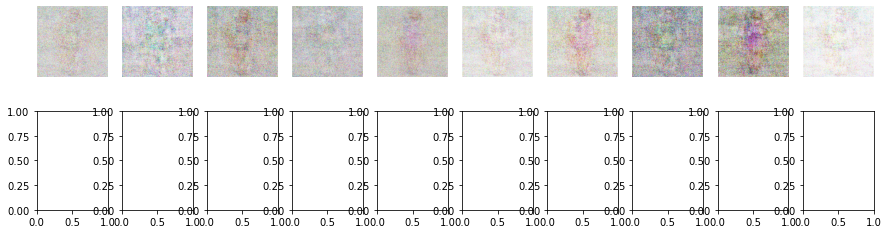

1/1 [==============================] - 0s 32ms/step
5051/10000 [D loss: 156503.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5052/10000 [D loss: 145888.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5053/10000 [D loss: 142352.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5054/10000 [D loss: 121630.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
5055/10000 [D loss: 115375.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5056/10000 [D loss: 117027.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
5057/10000 [D loss: 93843.4765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5058/10000 [D loss: 82274.015625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5

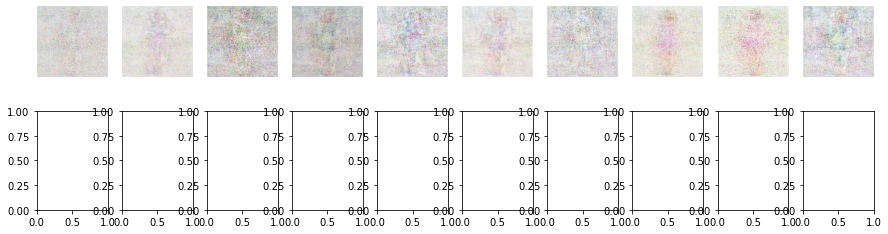

1/1 [==============================] - 0s 31ms/step
5101/10000 [D loss: 1155875.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5102/10000 [D loss: 1250492.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5103/10000 [D loss: 1352246.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
5104/10000 [D loss: 1299066.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5105/10000 [D loss: 1224548.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5106/10000 [D loss: 1195487.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
5107/10000 [D loss: 1151507.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
5108/10000 [D loss: 1083583.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5109/10000 

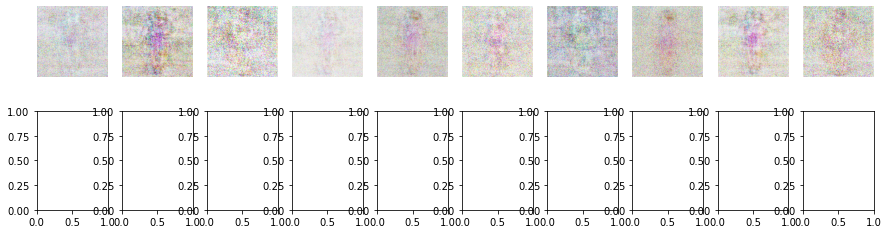

1/1 [==============================] - 0s 31ms/step
5151/10000 [D loss: 768141.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
5152/10000 [D loss: 808160.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
5153/10000 [D loss: 773779.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
5154/10000 [D loss: 738814.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5155/10000 [D loss: 770200.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
5156/10000 [D loss: 729492.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
5157/10000 [D loss: 676964.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5158/10000 [D loss: 764551.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5159/10000 [D

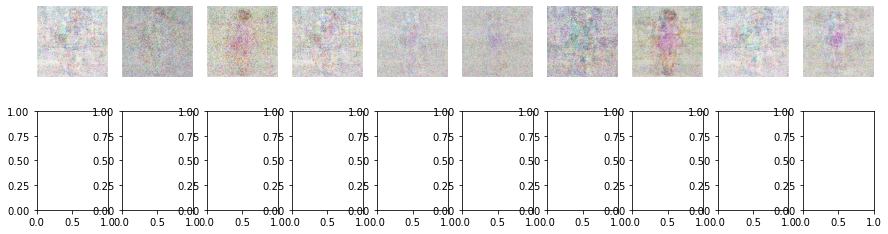

1/1 [==============================] - 0s 32ms/step
5201/10000 [D loss: 1339097.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5202/10000 [D loss: 1485307.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
5203/10000 [D loss: 1300537.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
5204/10000 [D loss: 1412225.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
5205/10000 [D loss: 1408449.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5206/10000 [D loss: 1427655.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5207/10000 [D loss: 1289475.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5208/10000 [D loss: 1465074.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5209/10000 [D lo

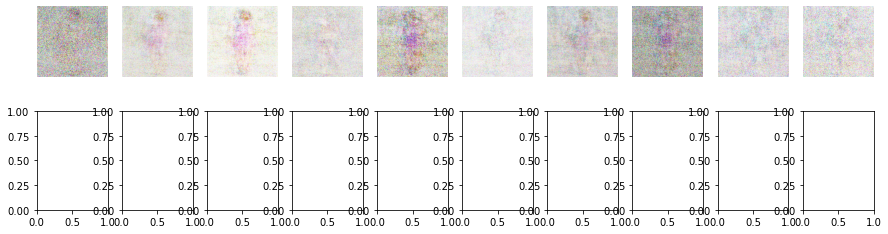

1/1 [==============================] - 0s 32ms/step
5251/10000 [D loss: 1138975.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5252/10000 [D loss: 1012487.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5253/10000 [D loss: 992791.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5254/10000 [D loss: 1161370.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5255/10000 [D loss: 1043183.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5256/10000 [D loss: 1073300.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5257/10000 [D loss: 1083599.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5258/10000 [D loss: 1020951.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 120ms/step
5259/10

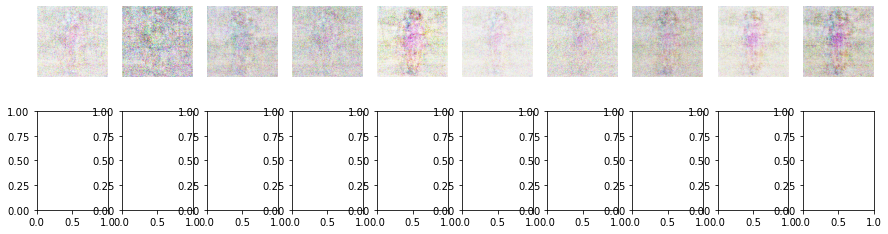

1/1 [==============================] - 0s 33ms/step
5301/10000 [D loss: 794797.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 84ms/step
5302/10000 [D loss: 734225.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5303/10000 [D loss: 727522.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5304/10000 [D loss: 731662.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
5305/10000 [D loss: 716125.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
5306/10000 [D loss: 702635.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5307/10000 [D loss: 757958.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5308/10000 [D loss: 755307.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
5309/10000 

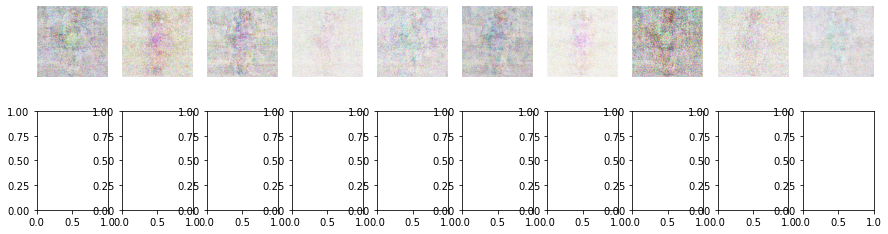

1/1 [==============================] - 0s 31ms/step
5351/10000 [D loss: 296860.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5352/10000 [D loss: 295432.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5353/10000 [D loss: 267831.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5354/10000 [D loss: 271508.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5355/10000 [D loss: 246102.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5356/10000 [D loss: 224995.859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5357/10000 [D loss: 206246.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5358/10000 [D loss: 181978.078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
53

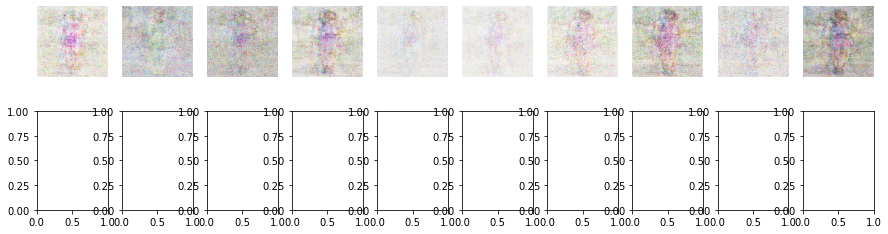

1/1 [==============================] - 0s 35ms/step
5401/10000 [D loss: 761817.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
5402/10000 [D loss: 731566.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5403/10000 [D loss: 825601.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5404/10000 [D loss: 819672.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5405/10000 [D loss: 781807.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5406/10000 [D loss: 697810.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
5407/10000 [D loss: 662131.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5408/10000 [D loss: 749950.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5409/10000 [

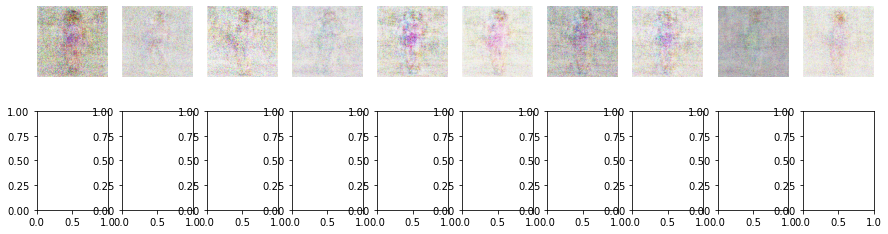

1/1 [==============================] - 0s 34ms/step
5451/10000 [D loss: 428421.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5452/10000 [D loss: 408647.21875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5453/10000 [D loss: 411832.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5454/10000 [D loss: 406412.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
5455/10000 [D loss: 411601.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5456/10000 [D loss: 389326.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5457/10000 [D loss: 380654.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
5458/10000 [D loss: 369803.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
545

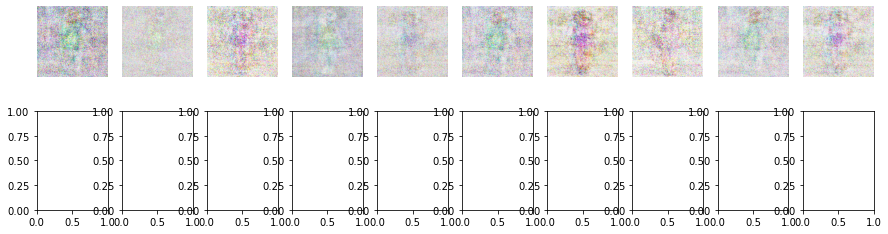

1/1 [==============================] - 0s 34ms/step
5501/10000 [D loss: 71206.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5502/10000 [D loss: 62550.3515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
5503/10000 [D loss: 55543.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5504/10000 [D loss: 49850.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
5505/10000 [D loss: 41680.046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
5506/10000 [D loss: 35634.83203125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5507/10000 [D loss: 28186.080078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5508/10000 [D loss: 17025.3828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 

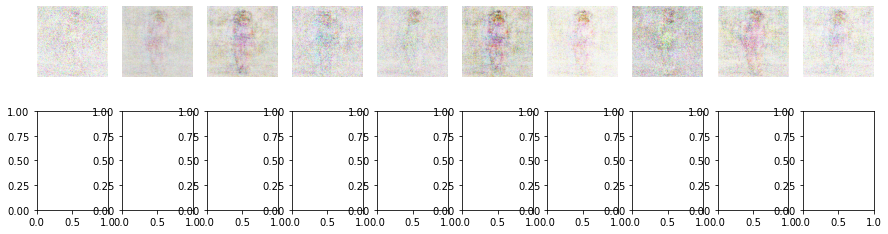

1/1 [==============================] - 0s 35ms/step
5551/10000 [D loss: 676394.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5552/10000 [D loss: 698785.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5553/10000 [D loss: 704945.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5554/10000 [D loss: 644599.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
5555/10000 [D loss: 693392.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5556/10000 [D loss: 633249.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5557/10000 [D loss: 658287.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
5558/10000 [D loss: 650388.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5559/10000 [

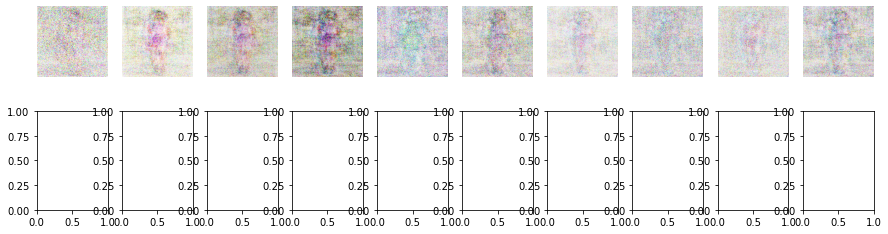

1/1 [==============================] - 0s 112ms/step
5601/10000 [D loss: 355114.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5602/10000 [D loss: 356735.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5603/10000 [D loss: 331073.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5604/10000 [D loss: 320479.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5605/10000 [D loss: 320694.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5606/10000 [D loss: 286409.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5607/10000 [D loss: 314868.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5608/10000 [D loss: 311683.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5609/10

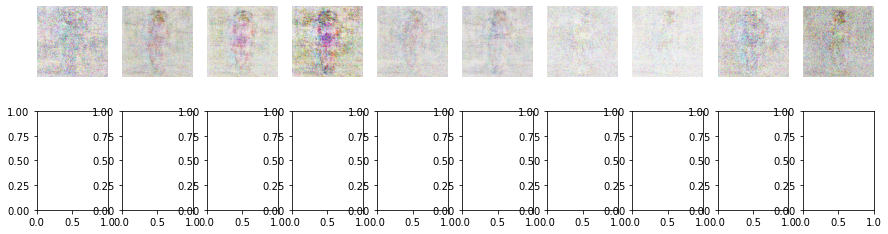

1/1 [==============================] - 0s 33ms/step
5651/10000 [D loss: 1807.918212890625 | D accuracy: 62.5] [G loss: 3893.259033203125]
1/1 [==============================] - 0s 41ms/step
5652/10000 [D loss: 882636.0 | D accuracy: 15.625] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5653/10000 [D loss: 949264.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
5654/10000 [D loss: 1110409.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
5655/10000 [D loss: 1156230.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
5656/10000 [D loss: 1109274.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5657/10000 [D loss: 1096347.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
5658/10000 [D loss: 1105727.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 3

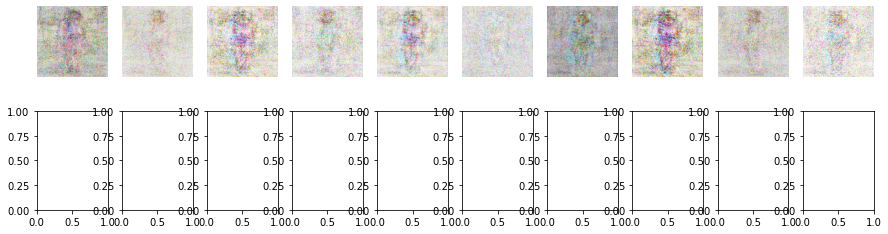

1/1 [==============================] - 0s 34ms/step
5701/10000 [D loss: 737601.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
5702/10000 [D loss: 757486.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5703/10000 [D loss: 770321.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
5704/10000 [D loss: 727621.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
5705/10000 [D loss: 708951.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
5706/10000 [D loss: 684154.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5707/10000 [D loss: 677917.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5708/10000 [D loss: 624330.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5709/10000 [D lo

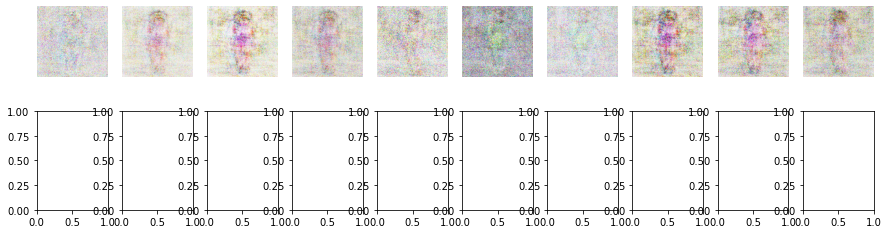

1/1 [==============================] - 0s 32ms/step
5751/10000 [D loss: 392147.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5752/10000 [D loss: 387992.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5753/10000 [D loss: 392591.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
5754/10000 [D loss: 373808.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5755/10000 [D loss: 354239.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5756/10000 [D loss: 357958.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
5757/10000 [D loss: 357299.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
5758/10000 [D loss: 346720.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5759/10000

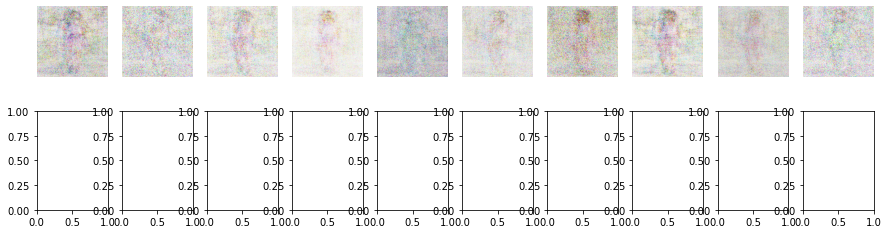

1/1 [==============================] - 0s 38ms/step
5801/10000 [D loss: 30440.927734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5802/10000 [D loss: 24144.359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5803/10000 [D loss: 14334.11328125 | D accuracy: 50.0] [G loss: 143.95578002929688]
1/1 [==============================] - 0s 40ms/step
5804/10000 [D loss: 7656.60107421875 | D accuracy: 50.0] [G loss: 1908.620849609375]
1/1 [==============================] - 0s 32ms/step
5805/10000 [D loss: 50327.26611328125 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
5806/10000 [D loss: 66106.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5807/10000 [D loss: 77284.609375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5808/10000 [D loss: 68107.3046875 | D accuracy: 50.0] [G loss: 0.0]
1/1

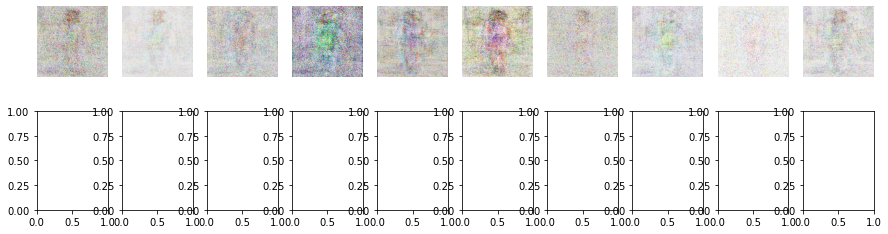

1/1 [==============================] - 0s 33ms/step
5851/10000 [D loss: 35196.5078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5852/10000 [D loss: 28633.77734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
5853/10000 [D loss: 19560.275390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 50ms/step
5854/10000 [D loss: 11108.345703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5855/10000 [D loss: 4340.43212890625 | D accuracy: 53.125] [G loss: 1511.72998046875]
1/1 [==============================] - 0s 41ms/step
5856/10000 [D loss: 70095.94775390625 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5857/10000 [D loss: 95584.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5858/10000 [D loss: 108631.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [===========

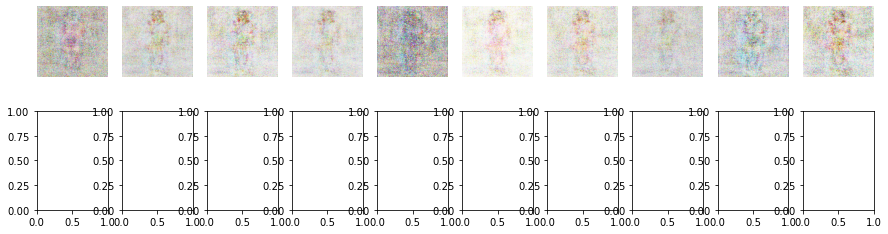

1/1 [==============================] - 0s 31ms/step
5901/10000 [D loss: 106960.5859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
5902/10000 [D loss: 100126.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5903/10000 [D loss: 91385.703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5904/10000 [D loss: 81703.578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5905/10000 [D loss: 73658.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
5906/10000 [D loss: 68171.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5907/10000 [D loss: 59681.640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
5908/10000 [D loss: 49486.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/s

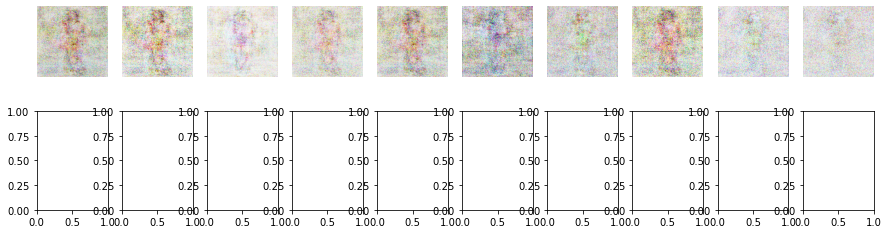

1/1 [==============================] - 0s 32ms/step
5951/10000 [D loss: 56624.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5952/10000 [D loss: 47346.53515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
5953/10000 [D loss: 40063.359375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
5954/10000 [D loss: 33775.70703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
5955/10000 [D loss: 24169.55859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
5956/10000 [D loss: 14630.6328125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
5957/10000 [D loss: 7217.5478515625 | D accuracy: 50.0] [G loss: 298.7384948730469]
1/1 [==============================] - 0s 38ms/step
5958/10000 [D loss: 465969.53125 | D accuracy: 31.25] [G loss: 0.0]
1/1 [===================

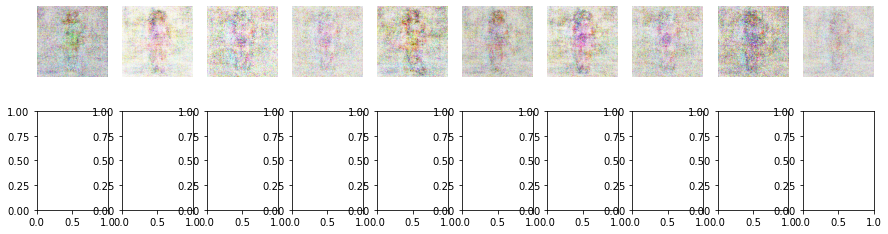

1/1 [==============================] - 0s 34ms/step
6001/10000 [D loss: 297566.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
6002/10000 [D loss: 282620.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6003/10000 [D loss: 286990.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6004/10000 [D loss: 255722.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6005/10000 [D loss: 275516.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6006/10000 [D loss: 272775.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6007/10000 [D loss: 245689.109375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
6008/10000 [D loss: 257659.21875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6009/1

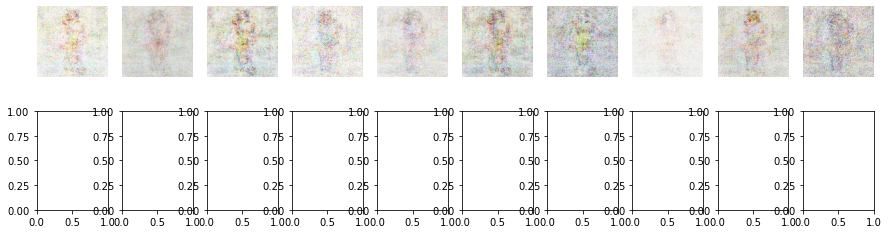

1/1 [==============================] - 0s 36ms/step
6051/10000 [D loss: 92205.0390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6052/10000 [D loss: 95105.578125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6053/10000 [D loss: 83892.828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6054/10000 [D loss: 70377.3984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6055/10000 [D loss: 68936.6640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6056/10000 [D loss: 60649.3828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6057/10000 [D loss: 52913.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6058/10000 [D loss: 50111.23828125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms

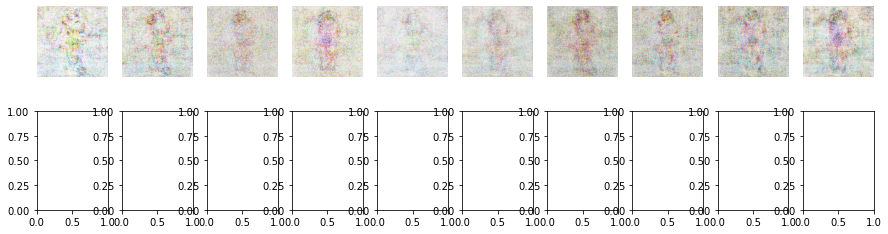

1/1 [==============================] - 0s 41ms/step
6101/10000 [D loss: 1351802.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
6102/10000 [D loss: 1315310.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6103/10000 [D loss: 1312815.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6104/10000 [D loss: 1291262.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6105/10000 [D loss: 1267934.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6106/10000 [D loss: 1220239.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6107/10000 [D loss: 1204903.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6108/10000 [D loss: 1125763.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6109/1000

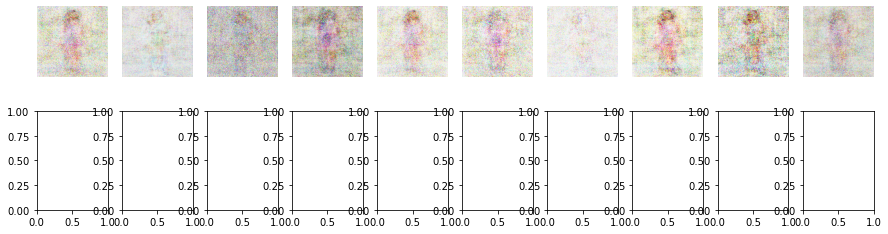

1/1 [==============================] - 0s 31ms/step
6151/10000 [D loss: 683619.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6152/10000 [D loss: 627377.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6153/10000 [D loss: 657050.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6154/10000 [D loss: 602463.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
6155/10000 [D loss: 636145.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6156/10000 [D loss: 573972.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6157/10000 [D loss: 548983.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
6158/10000 [D loss: 504947.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6159/10000 [

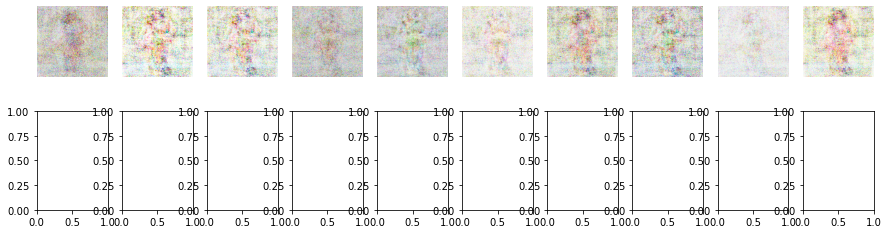

1/1 [==============================] - 0s 33ms/step
6201/10000 [D loss: 1342442.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6202/10000 [D loss: 1373673.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6203/10000 [D loss: 1396246.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6204/10000 [D loss: 1375660.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
6205/10000 [D loss: 1342787.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6206/10000 [D loss: 1287730.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
6207/10000 [D loss: 1411192.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6208/10000 [D loss: 1235352.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6209/10000 [D

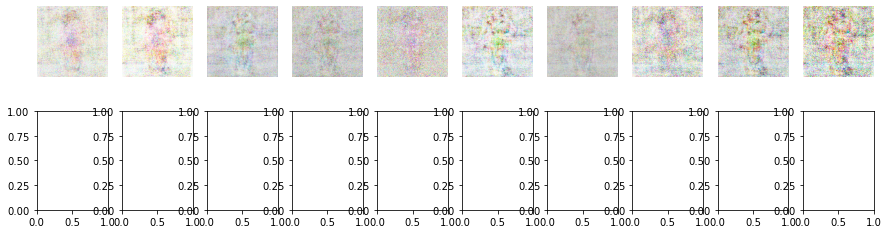

1/1 [==============================] - 0s 30ms/step
6251/10000 [D loss: 862768.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6252/10000 [D loss: 832434.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
6253/10000 [D loss: 858203.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6254/10000 [D loss: 824109.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
6255/10000 [D loss: 785902.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
6256/10000 [D loss: 798097.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6257/10000 [D loss: 773354.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6258/10000 [D loss: 752801.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6259/10000 [D lo

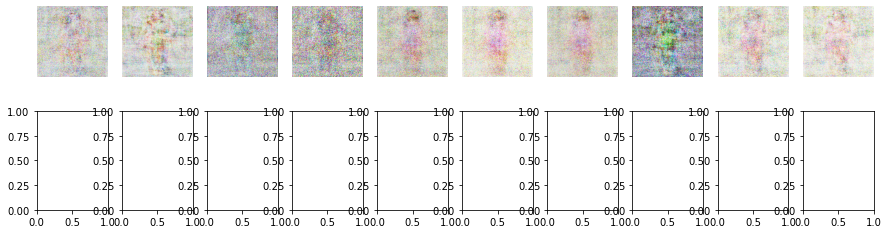

1/1 [==============================] - 0s 31ms/step
6301/10000 [D loss: 154706.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6302/10000 [D loss: 134811.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6303/10000 [D loss: 128973.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6304/10000 [D loss: 116542.9296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
6305/10000 [D loss: 97609.546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6306/10000 [D loss: 74363.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6307/10000 [D loss: 68664.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6308/10000 [D loss: 42568.32421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/s

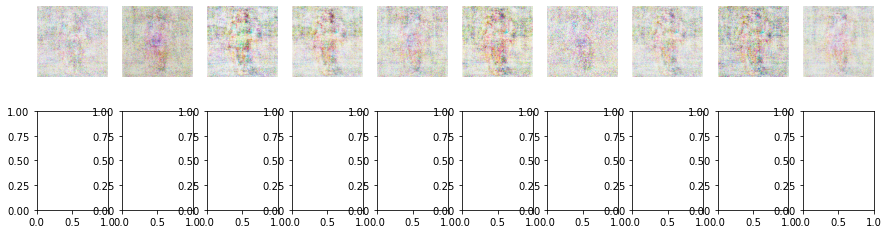

1/1 [==============================] - 0s 32ms/step
6351/10000 [D loss: 1023868.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6352/10000 [D loss: 1138376.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
6353/10000 [D loss: 949183.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6354/10000 [D loss: 1090088.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
6355/10000 [D loss: 995279.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
6356/10000 [D loss: 956241.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6357/10000 [D loss: 1097200.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6358/10000 [D loss: 1056244.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
6359/10000

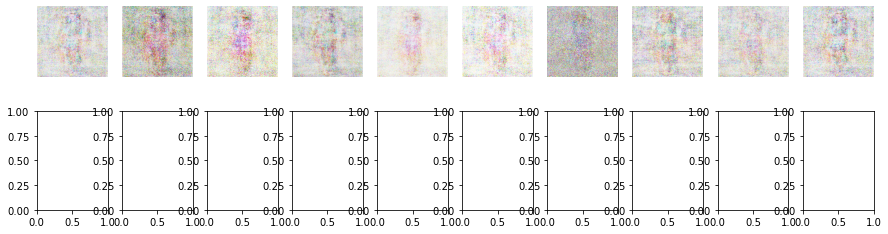

1/1 [==============================] - 0s 33ms/step
6401/10000 [D loss: 1861133.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
6402/10000 [D loss: 1878745.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
6403/10000 [D loss: 1780604.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6404/10000 [D loss: 1813460.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6405/10000 [D loss: 1720828.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6406/10000 [D loss: 1707641.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6407/10000 [D loss: 1762949.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
6408/10000 [D loss: 1805300.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6409/10000

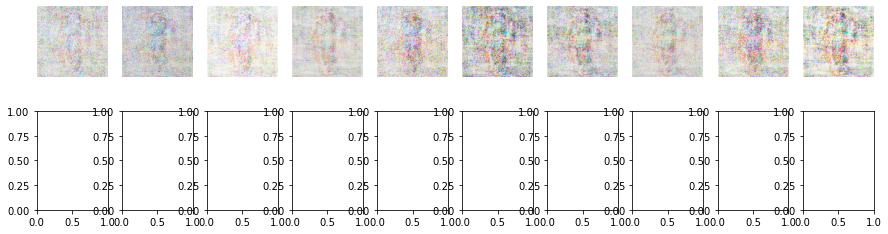

1/1 [==============================] - 0s 39ms/step
6451/10000 [D loss: 1355127.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6452/10000 [D loss: 1340062.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6453/10000 [D loss: 1249708.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6454/10000 [D loss: 1178922.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6455/10000 [D loss: 1252566.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6456/10000 [D loss: 1138373.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6457/10000 [D loss: 1172995.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6458/10000 [D loss: 1106885.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6459/100

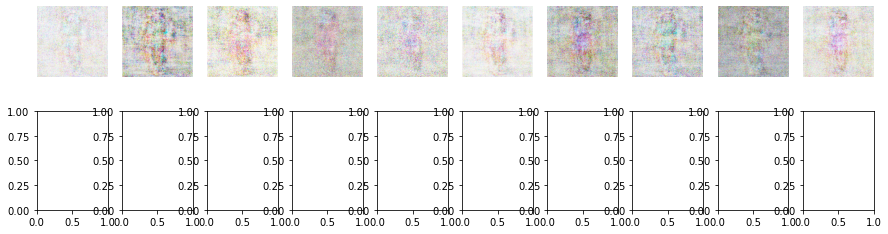

1/1 [==============================] - 0s 34ms/step
6501/10000 [D loss: 277887.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
6502/10000 [D loss: 274559.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6503/10000 [D loss: 247216.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6504/10000 [D loss: 209722.53125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6505/10000 [D loss: 181434.234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6506/10000 [D loss: 153417.078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6507/10000 [D loss: 119819.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6508/10000 [D loss: 84553.515625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/

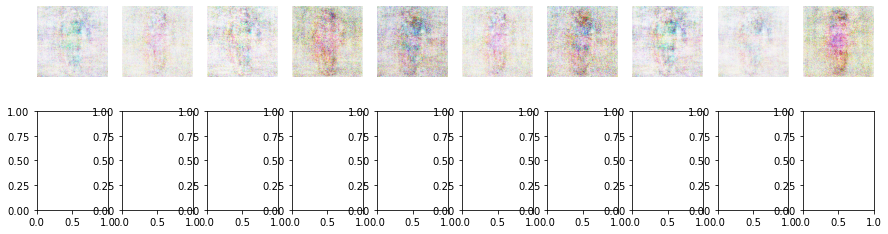

1/1 [==============================] - 0s 34ms/step
6551/10000 [D loss: 785897.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6552/10000 [D loss: 816800.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6553/10000 [D loss: 747751.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6554/10000 [D loss: 766940.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6555/10000 [D loss: 748094.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6556/10000 [D loss: 749018.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6557/10000 [D loss: 726592.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6558/10000 [D loss: 753569.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
6559/10000 [D

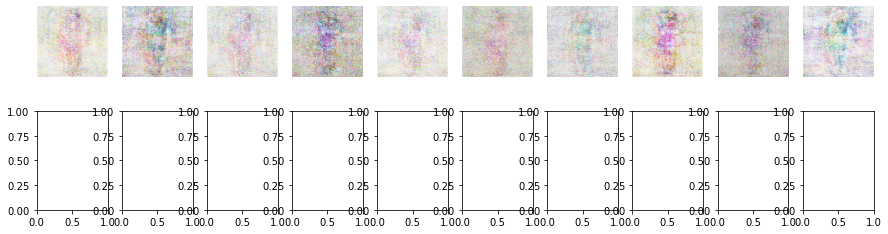

1/1 [==============================] - 0s 32ms/step
6601/10000 [D loss: 281271.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6602/10000 [D loss: 276327.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6603/10000 [D loss: 225082.453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6604/10000 [D loss: 247772.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
6605/10000 [D loss: 217866.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
6606/10000 [D loss: 240394.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6607/10000 [D loss: 218939.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6608/10000 [D loss: 205910.890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step

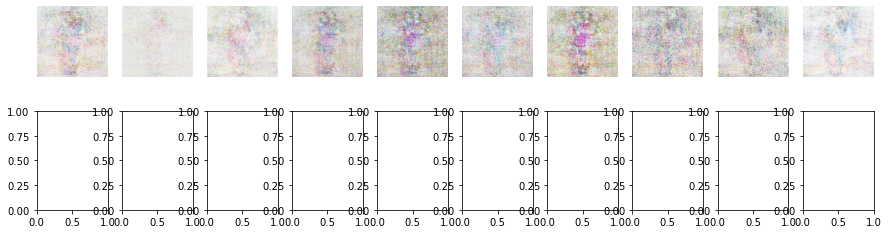

1/1 [==============================] - 0s 33ms/step
6651/10000 [D loss: 470011.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6652/10000 [D loss: 454403.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6653/10000 [D loss: 468950.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6654/10000 [D loss: 427580.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
6655/10000 [D loss: 431352.90625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6656/10000 [D loss: 394031.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6657/10000 [D loss: 425150.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6658/10000 [D loss: 397749.46875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
66

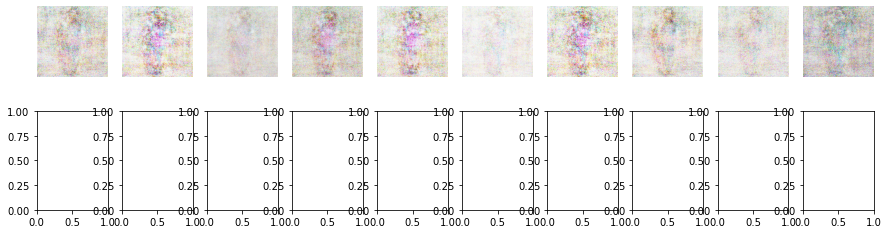

1/1 [==============================] - 0s 36ms/step
6701/10000 [D loss: 1070052.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
6702/10000 [D loss: 1121745.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6703/10000 [D loss: 1076475.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
6704/10000 [D loss: 1098510.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6705/10000 [D loss: 1121835.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6706/10000 [D loss: 947675.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6707/10000 [D loss: 1003616.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6708/10000 [D loss: 1148078.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
6709/10000 [D lo

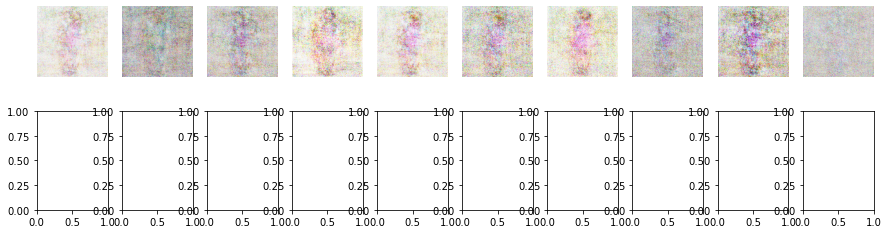

1/1 [==============================] - 0s 34ms/step
6751/10000 [D loss: 560647.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6752/10000 [D loss: 536770.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6753/10000 [D loss: 588720.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
6754/10000 [D loss: 572637.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6755/10000 [D loss: 541524.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6756/10000 [D loss: 523833.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6757/10000 [D loss: 489287.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6758/10000 [D loss: 522335.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6759/10000 [

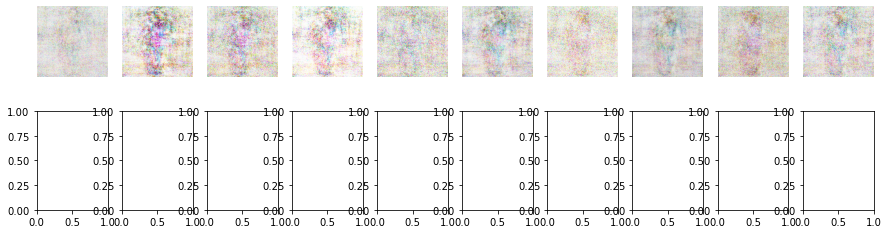

1/1 [==============================] - 0s 33ms/step
6801/10000 [D loss: 66662.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6802/10000 [D loss: 64470.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6803/10000 [D loss: 45202.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
6804/10000 [D loss: 40014.09765625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6805/10000 [D loss: 23596.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6806/10000 [D loss: 15832.7763671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6807/10000 [D loss: 6160.2333984375 | D accuracy: 53.125] [G loss: 1857.8621826171875]
1/1 [==============================] - 0s 37ms/step
6808/10000 [D loss: 2075.137451171875 | D accuracy: 62.5] [G loss: 9228.814453125]
1/1 [====

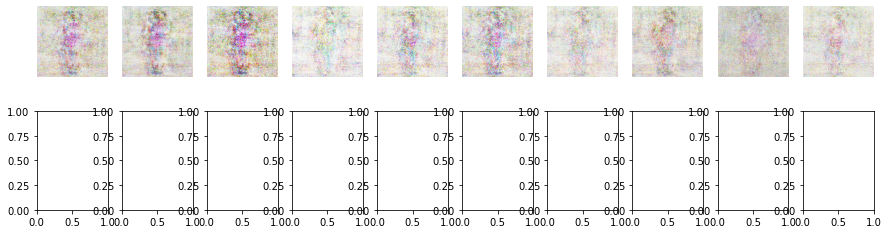

1/1 [==============================] - 0s 33ms/step
6851/10000 [D loss: 220882.859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
6852/10000 [D loss: 199455.421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6853/10000 [D loss: 178025.234375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6854/10000 [D loss: 174781.640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6855/10000 [D loss: 178111.921875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6856/10000 [D loss: 158603.453125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6857/10000 [D loss: 149108.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6858/10000 [D loss: 145215.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33

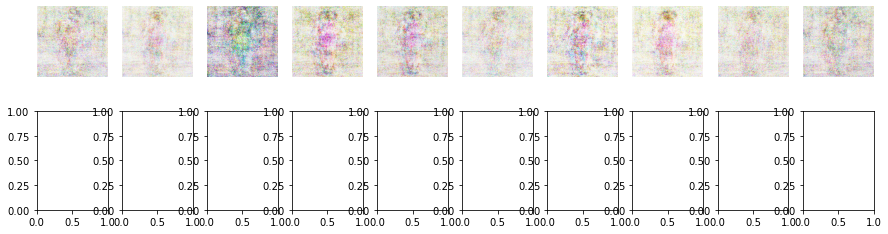

1/1 [==============================] - 0s 32ms/step
6901/10000 [D loss: 1539904.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
6902/10000 [D loss: 1462674.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 30ms/step
6903/10000 [D loss: 1584082.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6904/10000 [D loss: 1519588.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
6905/10000 [D loss: 1604698.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
6906/10000 [D loss: 1433227.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6907/10000 [D loss: 1402564.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6908/10000 [D loss: 1517401.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6909/10000

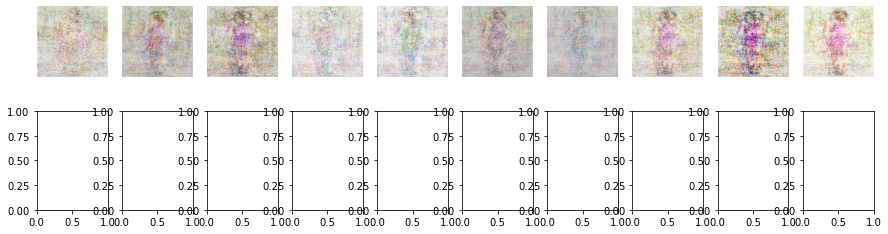

1/1 [==============================] - 0s 32ms/step
6951/10000 [D loss: 1021480.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
6952/10000 [D loss: 1054375.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6953/10000 [D loss: 969825.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
6954/10000 [D loss: 992160.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
6955/10000 [D loss: 988879.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6956/10000 [D loss: 992646.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
6957/10000 [D loss: 978936.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
6958/10000 [D loss: 1011742.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
6959/1000

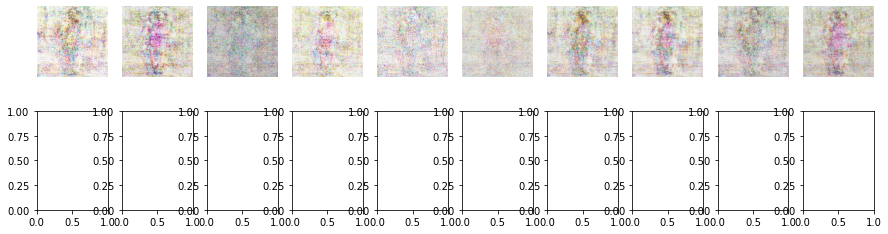

1/1 [==============================] - 0s 33ms/step
7001/10000 [D loss: 420880.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
7002/10000 [D loss: 391697.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
7003/10000 [D loss: 377694.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7004/10000 [D loss: 339392.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7005/10000 [D loss: 318431.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7006/10000 [D loss: 325013.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7007/10000 [D loss: 278798.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7008/10000 [D loss: 258122.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7009/10000

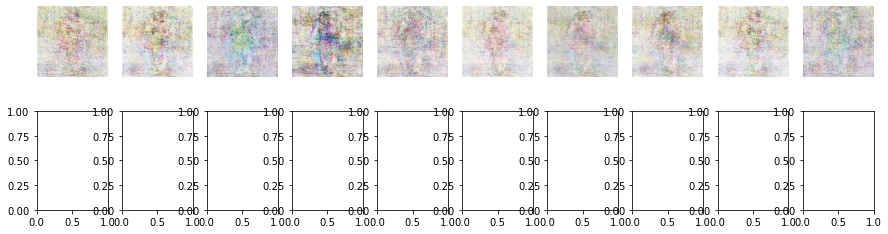

1/1 [==============================] - 0s 85ms/step
7051/10000 [D loss: 1062466.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7052/10000 [D loss: 938063.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7053/10000 [D loss: 923032.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7054/10000 [D loss: 967906.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7055/10000 [D loss: 958112.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
7056/10000 [D loss: 935100.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7057/10000 [D loss: 930856.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7058/10000 [D loss: 912342.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7059/10000 [D

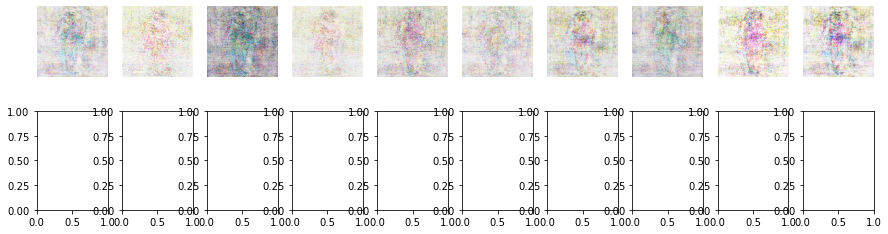

1/1 [==============================] - 0s 33ms/step
7101/10000 [D loss: 395575.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7102/10000 [D loss: 409940.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7103/10000 [D loss: 393730.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
7104/10000 [D loss: 359748.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
7105/10000 [D loss: 342170.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7106/10000 [D loss: 361014.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7107/10000 [D loss: 316831.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7108/10000 [D loss: 328661.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7109/

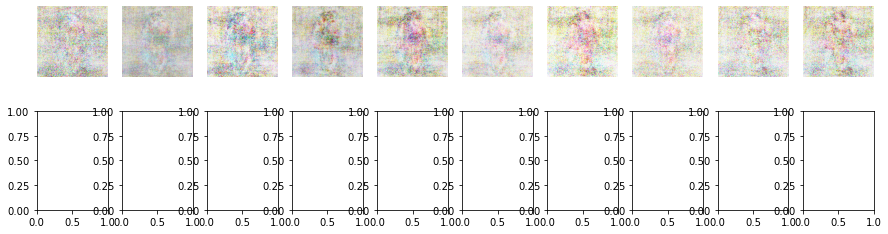

1/1 [==============================] - 0s 37ms/step
7151/10000 [D loss: 606697.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
7152/10000 [D loss: 627577.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7153/10000 [D loss: 580610.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7154/10000 [D loss: 555779.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7155/10000 [D loss: 586898.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7156/10000 [D loss: 576289.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
7157/10000 [D loss: 536354.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7158/10000 [D loss: 539383.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
7159/10000 [D lo

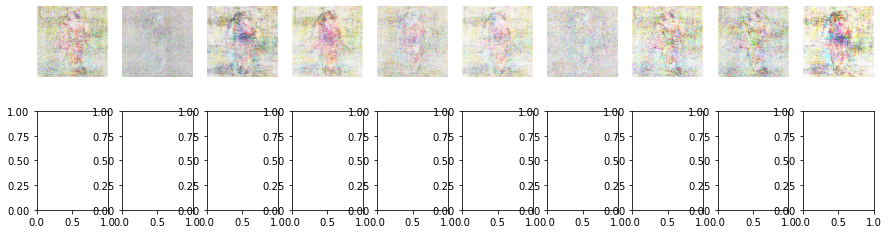

1/1 [==============================] - 0s 33ms/step
7201/10000 [D loss: 72694.0078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7202/10000 [D loss: 63962.7890625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7203/10000 [D loss: 52235.5390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7204/10000 [D loss: 39998.2578125 | D accuracy: 50.0] [G loss: 261.14739990234375]
1/1 [==============================] - 0s 40ms/step
7205/10000 [D loss: 23883.8671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
7206/10000 [D loss: 21792.52734375 | D accuracy: 50.0] [G loss: 525.0879516601562]
1/1 [==============================] - 0s 37ms/step
7207/10000 [D loss: 9561.134765625 | D accuracy: 56.25] [G loss: 3059.4638671875]
1/1 [==============================] - 0s 34ms/step
7208/10000 [D loss: 251484.03125 | D accuracy: 43.75] [G loss: 0

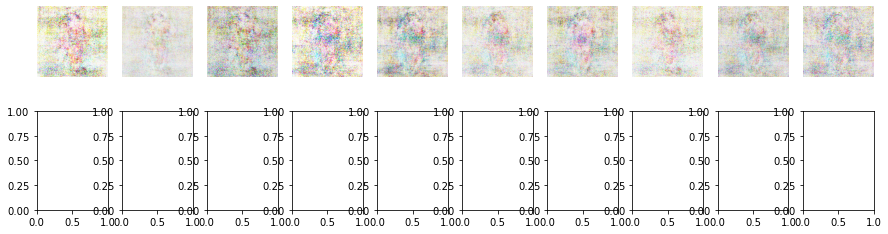

1/1 [==============================] - 0s 32ms/step
7251/10000 [D loss: 16274.677734375 | D accuracy: 50.0] [G loss: 144.11529541015625]
1/1 [==============================] - 0s 38ms/step
7252/10000 [D loss: 6134.4951171875 | D accuracy: 53.125] [G loss: 5895.91796875]
1/1 [==============================] - 0s 36ms/step
7253/10000 [D loss: 313551.65625 | D accuracy: 40.625] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
7254/10000 [D loss: 507236.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7255/10000 [D loss: 563078.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7256/10000 [D loss: 548294.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 50ms/step
7257/10000 [D loss: 495410.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
7258/10000 [D loss: 528846.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=================

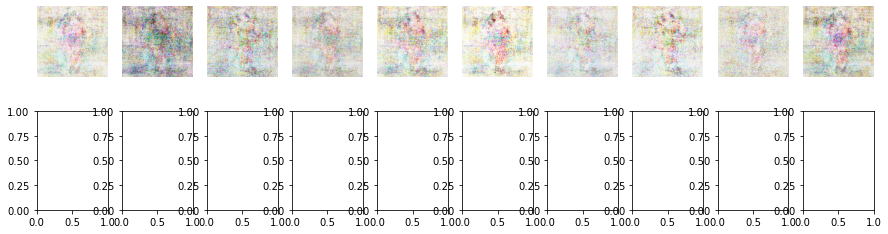

1/1 [==============================] - 0s 34ms/step
7301/10000 [D loss: 21689.08984375 | D accuracy: 50.0] [G loss: 75.94366455078125]
1/1 [==============================] - 0s 37ms/step
7302/10000 [D loss: 11073.861328125 | D accuracy: 50.0] [G loss: 1400.29833984375]
1/1 [==============================] - 0s 44ms/step
7303/10000 [D loss: 125368.1484375 | D accuracy: 46.875] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7304/10000 [D loss: 85845.484375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7305/10000 [D loss: 84815.1640625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
7306/10000 [D loss: 76367.984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7307/10000 [D loss: 73637.21875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7308/10000 [D loss: 58097.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [========

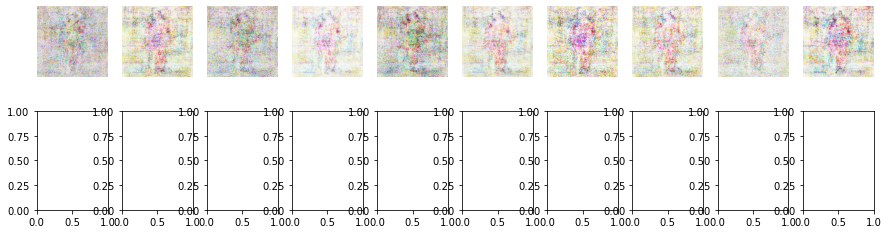

1/1 [==============================] - 0s 32ms/step
7351/10000 [D loss: 1134812.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7352/10000 [D loss: 979667.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7353/10000 [D loss: 1132586.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7354/10000 [D loss: 984134.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
7355/10000 [D loss: 1106215.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7356/10000 [D loss: 1077963.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7357/10000 [D loss: 1040447.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
7358/10000 [D loss: 1051628.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
7359/1

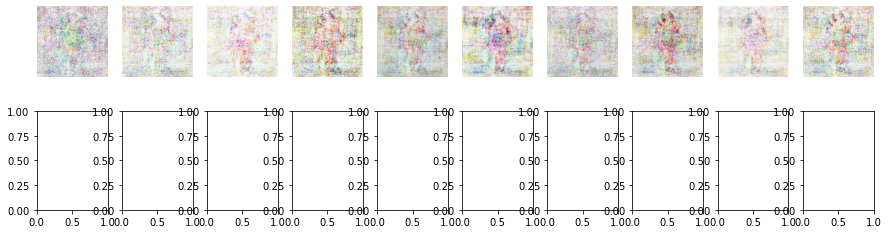

1/1 [==============================] - 0s 33ms/step
7401/10000 [D loss: 489665.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7402/10000 [D loss: 507534.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7403/10000 [D loss: 466154.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7404/10000 [D loss: 440779.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7405/10000 [D loss: 444432.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7406/10000 [D loss: 427112.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7407/10000 [D loss: 405256.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7408/10000 [D loss: 385144.15625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7409

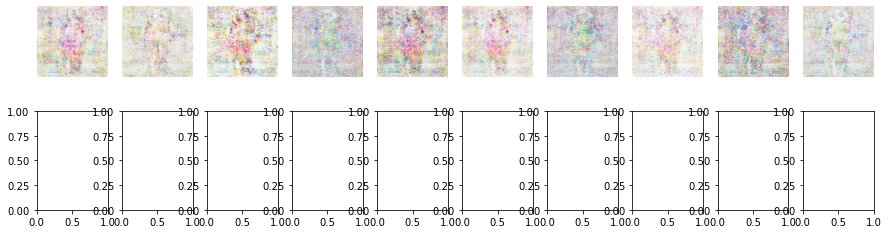

1/1 [==============================] - 0s 33ms/step
7451/10000 [D loss: 26469.70703125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7452/10000 [D loss: 13965.7646484375 | D accuracy: 50.0] [G loss: 798.8041381835938]
1/1 [==============================] - 0s 35ms/step
7453/10000 [D loss: 182200.56640625 | D accuracy: 43.75] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7454/10000 [D loss: 254682.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7455/10000 [D loss: 272843.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
7456/10000 [D loss: 278864.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7457/10000 [D loss: 271830.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7458/10000 [D loss: 250759.796875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [=====================

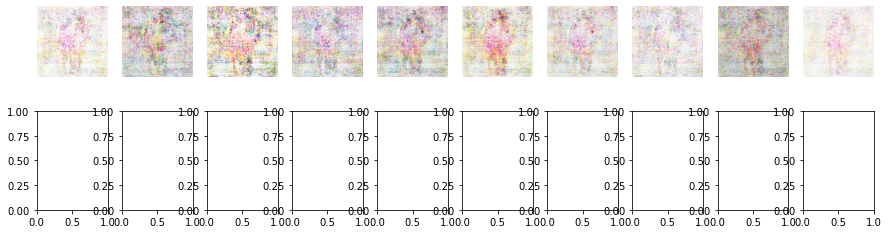

1/1 [==============================] - 0s 34ms/step
7501/10000 [D loss: 1964659.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7502/10000 [D loss: 1796100.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7503/10000 [D loss: 1882945.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
7504/10000 [D loss: 1684143.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7505/10000 [D loss: 1861802.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7506/10000 [D loss: 1833435.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7507/10000 [D loss: 1747744.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7508/10000 [D loss: 1637233.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7509/10000

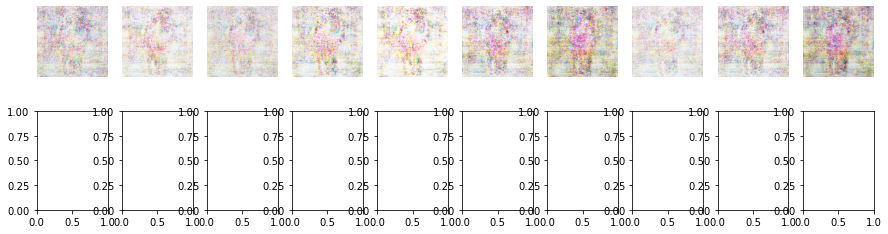

1/1 [==============================] - 0s 34ms/step
7551/10000 [D loss: 948623.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7552/10000 [D loss: 904259.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7553/10000 [D loss: 856863.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7554/10000 [D loss: 842021.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7555/10000 [D loss: 841942.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7556/10000 [D loss: 735513.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7557/10000 [D loss: 708604.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7558/10000 [D loss: 685936.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7559/10000 [D loss: 

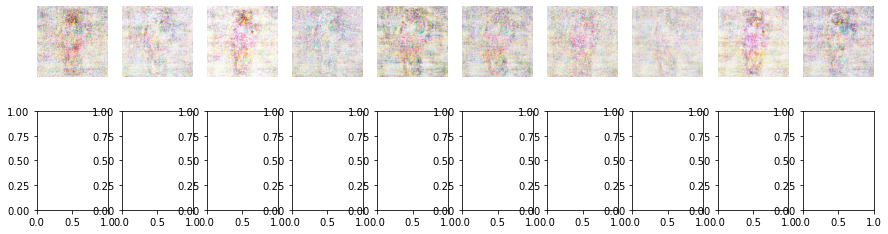

1/1 [==============================] - 0s 36ms/step
7601/10000 [D loss: 1594659.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7602/10000 [D loss: 1586271.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
7603/10000 [D loss: 1524824.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7604/10000 [D loss: 1588276.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7605/10000 [D loss: 1480000.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 49ms/step
7606/10000 [D loss: 1606473.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
7607/10000 [D loss: 1618338.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7608/10000 [D loss: 1508664.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
7609/10000 [D

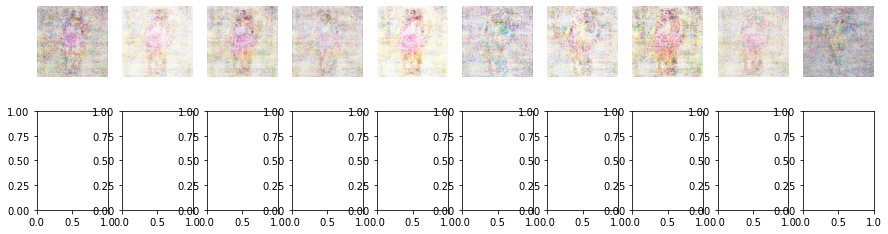

1/1 [==============================] - 0s 33ms/step
7651/10000 [D loss: 971658.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7652/10000 [D loss: 974325.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7653/10000 [D loss: 880158.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
7654/10000 [D loss: 931182.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
7655/10000 [D loss: 835109.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7656/10000 [D loss: 837071.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 50ms/step
7657/10000 [D loss: 751941.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
7658/10000 [D loss: 817212.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7659/10000 [D los

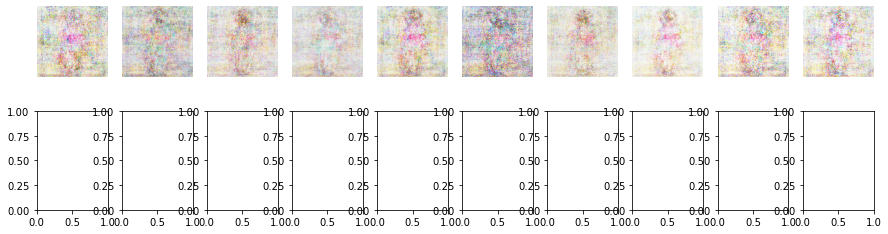

1/1 [==============================] - 0s 32ms/step
7701/10000 [D loss: 2496363.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7702/10000 [D loss: 2366136.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7703/10000 [D loss: 2403699.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7704/10000 [D loss: 2579464.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7705/10000 [D loss: 2434030.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7706/10000 [D loss: 2513154.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7707/10000 [D loss: 2491306.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7708/10000 [D loss: 2400169.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7709/10000 [D los

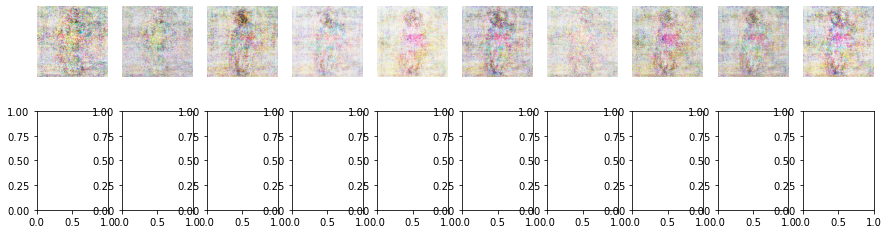

1/1 [==============================] - 0s 33ms/step
7751/10000 [D loss: 1645290.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7752/10000 [D loss: 1591064.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7753/10000 [D loss: 1468907.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7754/10000 [D loss: 1483977.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7755/10000 [D loss: 1446303.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7756/10000 [D loss: 1500436.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7757/10000 [D loss: 1373312.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7758/10000 [D loss: 1430923.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
7759/10000 [D 

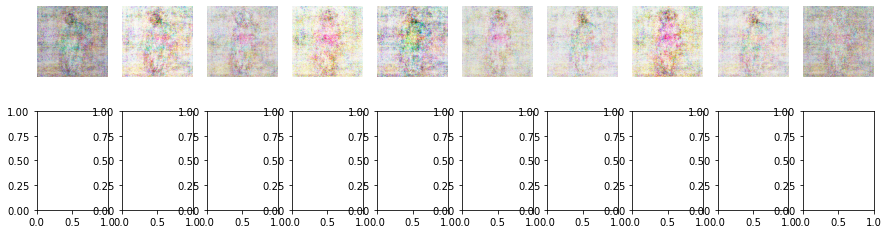

1/1 [==============================] - 0s 33ms/step
7801/10000 [D loss: 8815.2978515625 | D accuracy: 53.125] [G loss: 19550.556640625]
1/1 [==============================] - 0s 33ms/step
7802/10000 [D loss: 2355042.8125 | D accuracy: 3.125] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7803/10000 [D loss: 2065965.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7804/10000 [D loss: 2334653.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 49ms/step
7805/10000 [D loss: 2483302.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
7806/10000 [D loss: 2491496.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7807/10000 [D loss: 2227284.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
7808/10000 [D loss: 2290752.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36m

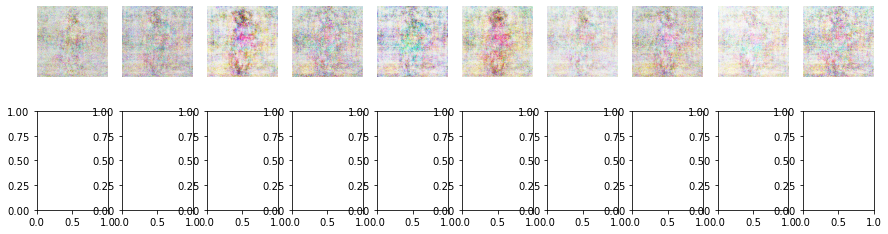

1/1 [==============================] - 0s 33ms/step
7851/10000 [D loss: 1657509.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7852/10000 [D loss: 1753446.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7853/10000 [D loss: 1724511.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7854/10000 [D loss: 1603995.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7855/10000 [D loss: 1628010.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7856/10000 [D loss: 1659399.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7857/10000 [D loss: 1624415.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7858/10000 [D loss: 1637144.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7859/10000 [D 

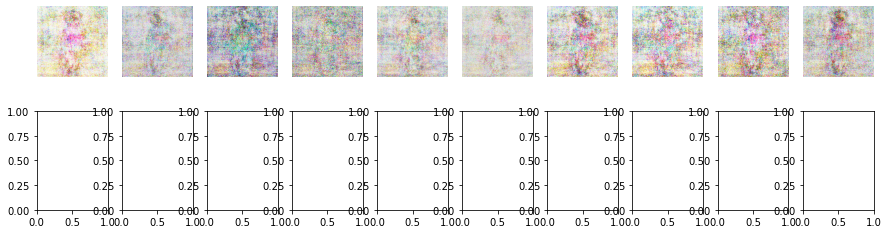

1/1 [==============================] - 0s 33ms/step
7901/10000 [D loss: 465897.21875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
7902/10000 [D loss: 393367.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7903/10000 [D loss: 335320.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
7904/10000 [D loss: 320157.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7905/10000 [D loss: 262611.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
7906/10000 [D loss: 255152.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7907/10000 [D loss: 192589.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
7908/10000 [D loss: 164112.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
7909

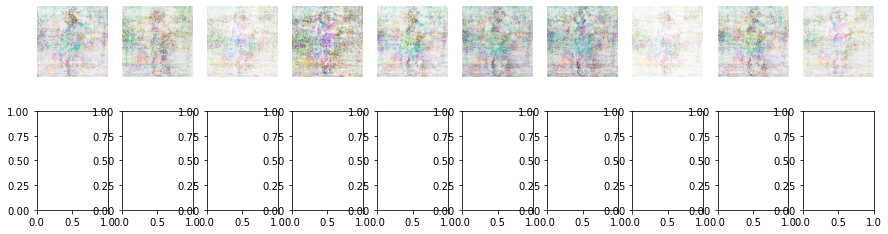

1/1 [==============================] - 0s 32ms/step
7951/10000 [D loss: 1776234.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
7952/10000 [D loss: 2024533.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7953/10000 [D loss: 1885732.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7954/10000 [D loss: 1858945.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
7955/10000 [D loss: 1719365.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
7956/10000 [D loss: 1801876.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
7957/10000 [D loss: 1744150.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
7958/10000 [D loss: 1762885.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
7959/10000 [

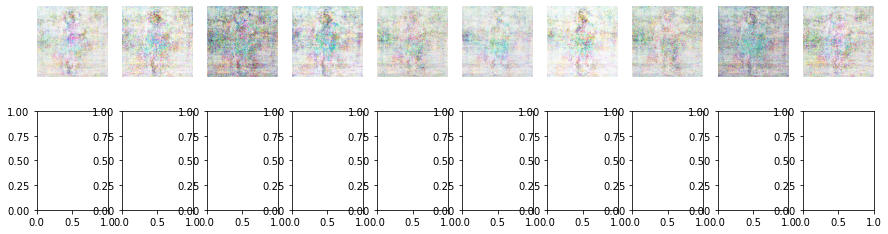

1/1 [==============================] - 0s 32ms/step
8001/10000 [D loss: 1159559.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8002/10000 [D loss: 1206482.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8003/10000 [D loss: 1166337.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8004/10000 [D loss: 1154492.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8005/10000 [D loss: 1109730.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8006/10000 [D loss: 1025865.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8007/10000 [D loss: 1122101.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
8008/10000 [D loss: 1164877.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
8009/10000 [D

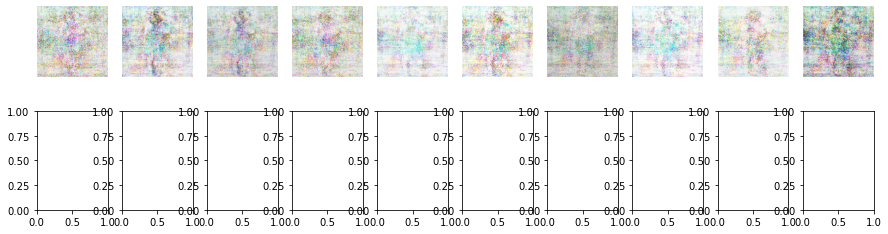

1/1 [==============================] - 0s 32ms/step
8051/10000 [D loss: 412232.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8052/10000 [D loss: 409579.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 51ms/step
8053/10000 [D loss: 368373.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8054/10000 [D loss: 343544.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8055/10000 [D loss: 332035.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8056/10000 [D loss: 300181.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8057/10000 [D loss: 291132.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8058/10000 [D loss: 276405.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
8059

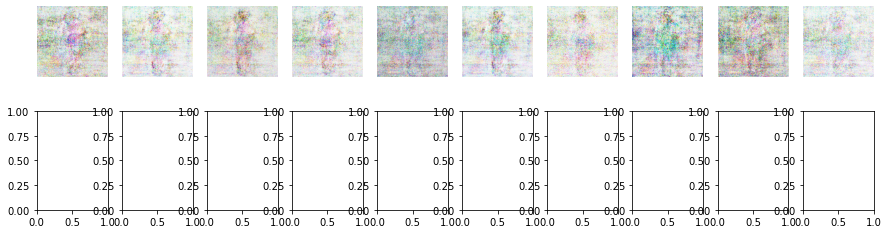

1/1 [==============================] - 0s 36ms/step
8101/10000 [D loss: 652595.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8102/10000 [D loss: 617821.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8103/10000 [D loss: 579951.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8104/10000 [D loss: 660260.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8105/10000 [D loss: 570138.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8106/10000 [D loss: 575781.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8107/10000 [D loss: 550327.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8108/10000 [D loss: 550983.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8109/10000 [D loss: 52

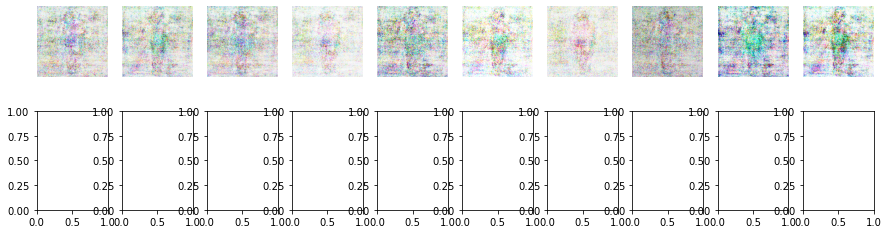

1/1 [==============================] - 0s 33ms/step
8151/10000 [D loss: 834340.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8152/10000 [D loss: 872317.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8153/10000 [D loss: 893799.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8154/10000 [D loss: 982811.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8155/10000 [D loss: 845031.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8156/10000 [D loss: 884987.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
8157/10000 [D loss: 823863.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8158/10000 [D loss: 809522.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8159/10000 

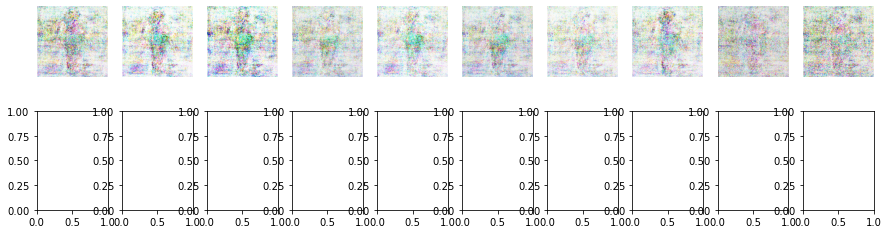

1/1 [==============================] - 0s 32ms/step
8201/10000 [D loss: 223397.046875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8202/10000 [D loss: 212092.265625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8203/10000 [D loss: 176104.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8204/10000 [D loss: 159954.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8205/10000 [D loss: 138824.421875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8206/10000 [D loss: 150098.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8207/10000 [D loss: 116586.2734375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8208/10000 [D loss: 118437.390625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/

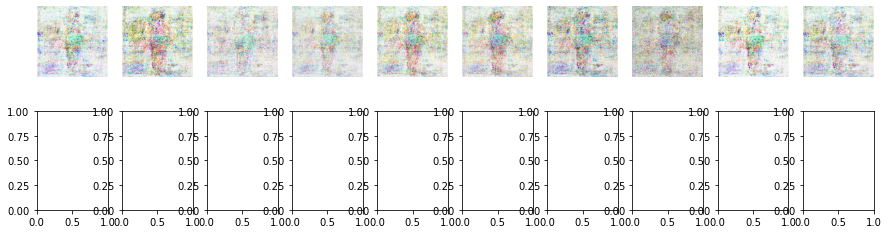

1/1 [==============================] - 0s 33ms/step
8251/10000 [D loss: 1453664.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8252/10000 [D loss: 1410830.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8253/10000 [D loss: 1339206.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8254/10000 [D loss: 1291969.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8255/10000 [D loss: 1302072.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8256/10000 [D loss: 1257715.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8257/10000 [D loss: 1287393.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8258/10000 [D loss: 1247422.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
8259/10000 [D

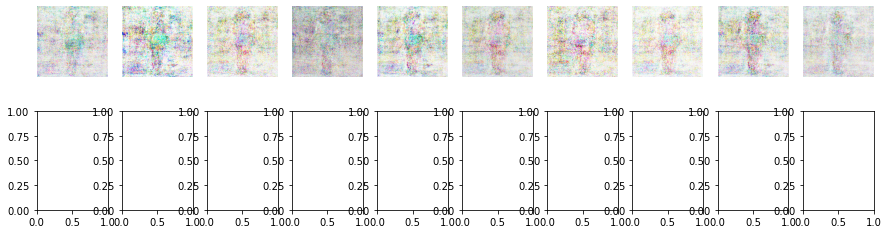

1/1 [==============================] - 0s 31ms/step
8301/10000 [D loss: 576100.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8302/10000 [D loss: 583156.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
8303/10000 [D loss: 551614.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8304/10000 [D loss: 574821.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8305/10000 [D loss: 530531.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8306/10000 [D loss: 526366.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8307/10000 [D loss: 528216.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
8308/10000 [D loss: 523391.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8309/10000 [D lo

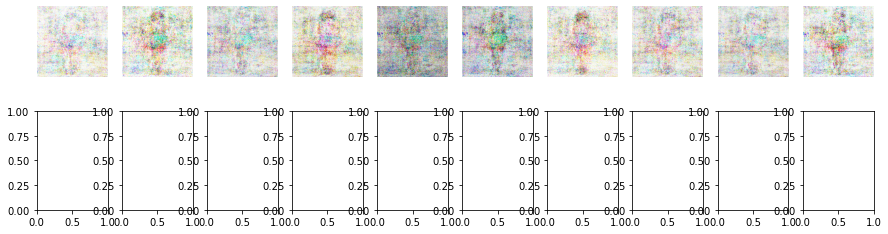

1/1 [==============================] - 0s 41ms/step
8351/10000 [D loss: 2136776.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8352/10000 [D loss: 2088788.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8353/10000 [D loss: 2045303.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8354/10000 [D loss: 2031499.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8355/10000 [D loss: 1988357.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8356/10000 [D loss: 1975068.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8357/10000 [D loss: 1968586.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
8358/10000 [D loss: 1909001.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
8359/10000 

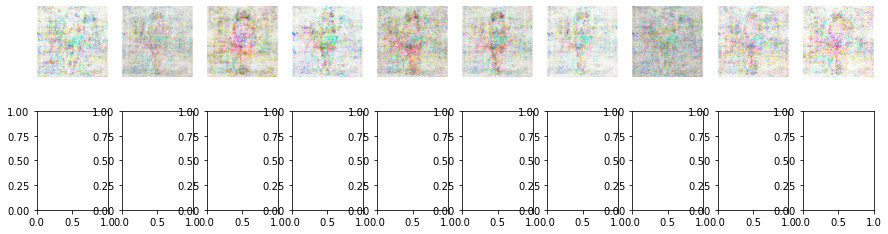

1/1 [==============================] - 0s 31ms/step
8401/10000 [D loss: 1252177.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8402/10000 [D loss: 1258553.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
8403/10000 [D loss: 1200984.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8404/10000 [D loss: 1197497.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8405/10000 [D loss: 1221655.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8406/10000 [D loss: 1167066.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8407/10000 [D loss: 1216605.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
8408/10000 [D loss: 1108157.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8409/10000

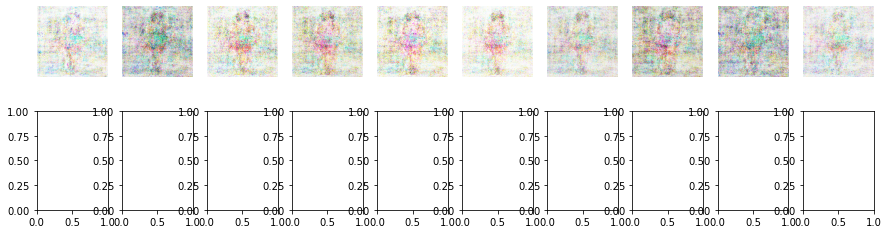

1/1 [==============================] - 0s 33ms/step
8451/10000 [D loss: 492586.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 70ms/step
8452/10000 [D loss: 468343.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8453/10000 [D loss: 449371.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8454/10000 [D loss: 425857.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8455/10000 [D loss: 396858.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8456/10000 [D loss: 395926.34375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 52ms/step
8457/10000 [D loss: 356909.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8458/10000 [D loss: 389731.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8459/

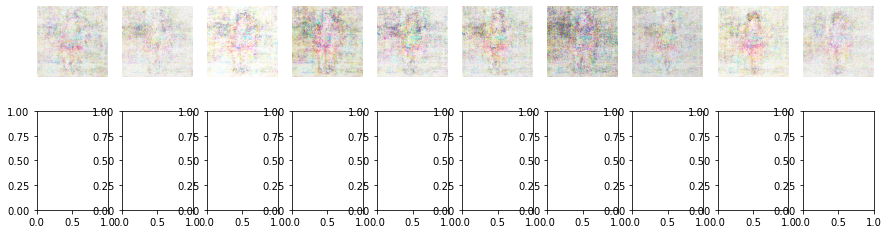

1/1 [==============================] - 0s 32ms/step
8501/10000 [D loss: 1437932.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
8502/10000 [D loss: 1310219.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8503/10000 [D loss: 1354875.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8504/10000 [D loss: 1345950.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8505/10000 [D loss: 1312126.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8506/10000 [D loss: 1327996.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8507/10000 [D loss: 1331523.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8508/10000 [D loss: 1346084.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
8509/10000 [D l

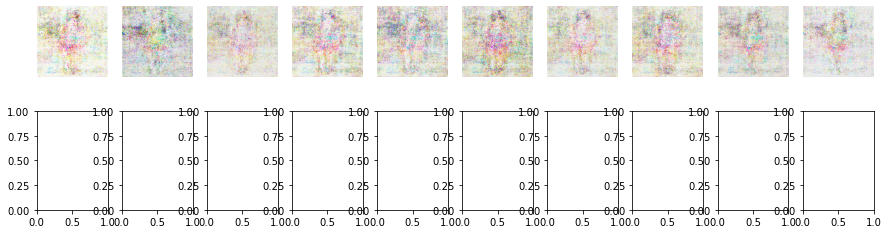

1/1 [==============================] - 0s 32ms/step
8551/10000 [D loss: 617259.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
8552/10000 [D loss: 581540.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
8553/10000 [D loss: 539181.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8554/10000 [D loss: 545084.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8555/10000 [D loss: 500558.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8556/10000 [D loss: 504054.40625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8557/10000 [D loss: 472452.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8558/10000 [D loss: 456285.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8559/1000

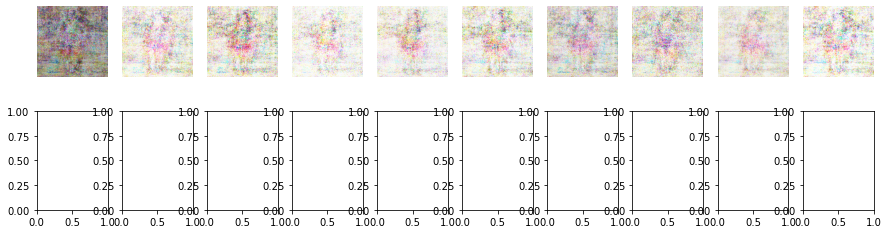

1/1 [==============================] - 0s 36ms/step
8601/10000 [D loss: 602103.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
8602/10000 [D loss: 601516.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8603/10000 [D loss: 596945.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8604/10000 [D loss: 529579.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8605/10000 [D loss: 572144.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8606/10000 [D loss: 534424.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8607/10000 [D loss: 510109.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
8608/10000 [D loss: 496256.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8609/100

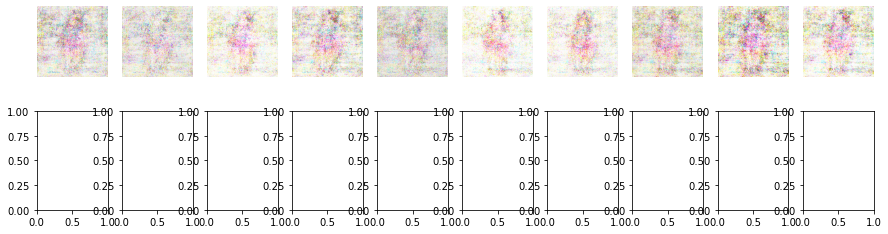

1/1 [==============================] - 0s 35ms/step
8651/10000 [D loss: 2171995.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8652/10000 [D loss: 1962211.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8653/10000 [D loss: 1941677.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8654/10000 [D loss: 2106873.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8655/10000 [D loss: 1971315.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8656/10000 [D loss: 1910090.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8657/10000 [D loss: 1888911.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8658/10000 [D loss: 2015061.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8659/10000 [D 

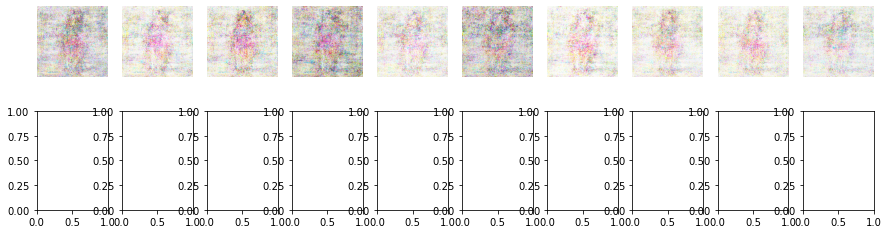

1/1 [==============================] - 0s 34ms/step
8701/10000 [D loss: 1128547.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8702/10000 [D loss: 1154923.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 48ms/step
8703/10000 [D loss: 1145147.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8704/10000 [D loss: 1010933.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8705/10000 [D loss: 1062747.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8706/10000 [D loss: 1076036.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8707/10000 [D loss: 992619.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8708/10000 [D loss: 970469.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
8709/10000 [D

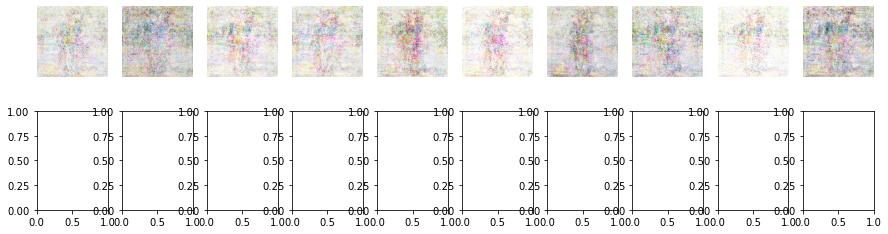

1/1 [==============================] - 0s 33ms/step
8751/10000 [D loss: 741151.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 50ms/step
8752/10000 [D loss: 771487.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8753/10000 [D loss: 685155.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
8754/10000 [D loss: 704686.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8755/10000 [D loss: 687437.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8756/10000 [D loss: 672613.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8757/10000 [D loss: 679362.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8758/10000 [D loss: 642966.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8759/10000 [D l

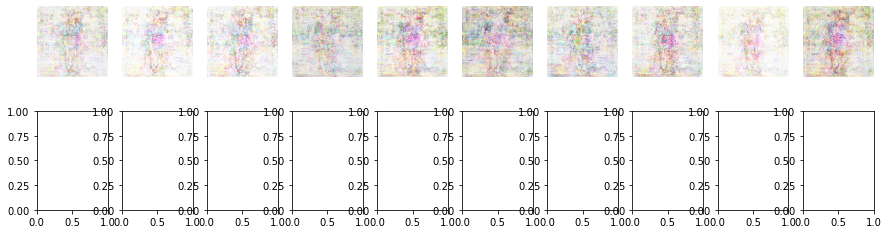

1/1 [==============================] - 0s 33ms/step
8801/10000 [D loss: 2829787.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8802/10000 [D loss: 2803552.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8803/10000 [D loss: 2829561.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8804/10000 [D loss: 2735002.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8805/10000 [D loss: 2659398.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8806/10000 [D loss: 2706172.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8807/10000 [D loss: 2670536.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8808/10000 [D loss: 2348616.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8809/10000 [D loss:

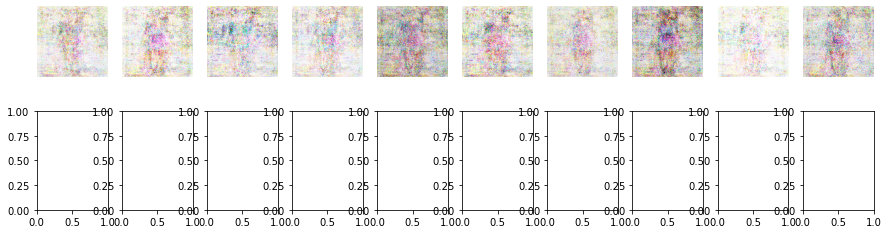

1/1 [==============================] - 0s 33ms/step
8851/10000 [D loss: 1987730.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8852/10000 [D loss: 1781714.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8853/10000 [D loss: 1793470.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
8854/10000 [D loss: 1859474.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8855/10000 [D loss: 1771880.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8856/10000 [D loss: 1730192.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8857/10000 [D loss: 1737626.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8858/10000 [D loss: 1771104.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8859/10000

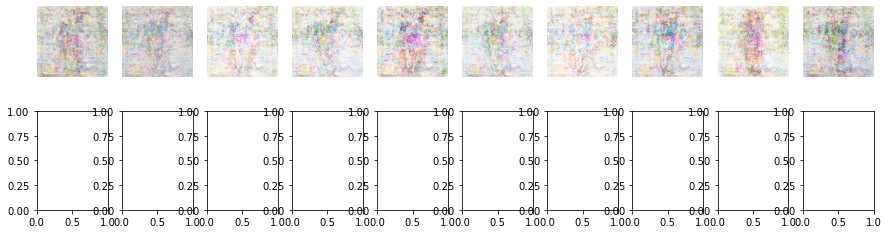

1/1 [==============================] - 0s 35ms/step
8901/10000 [D loss: 557912.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
8902/10000 [D loss: 552676.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
8903/10000 [D loss: 509118.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
8904/10000 [D loss: 446236.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
8905/10000 [D loss: 393871.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8906/10000 [D loss: 401333.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8907/10000 [D loss: 350988.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
8908/10000 [D loss: 314186.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
8909/10000 [

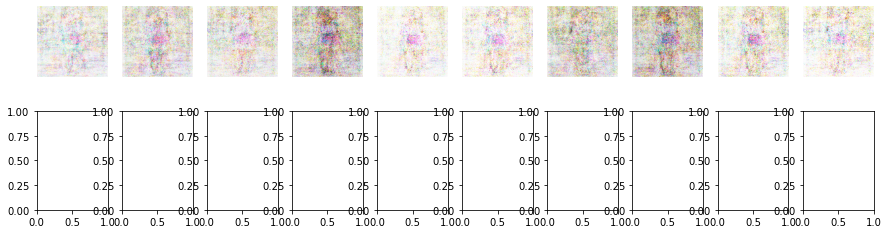

1/1 [==============================] - 0s 34ms/step
8951/10000 [D loss: 1238547.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
8952/10000 [D loss: 1157264.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8953/10000 [D loss: 1185732.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8954/10000 [D loss: 1200364.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8955/10000 [D loss: 1203837.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
8956/10000 [D loss: 1218731.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8957/10000 [D loss: 1186324.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
8958/10000 [D loss: 1120942.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
8959/10000 [D

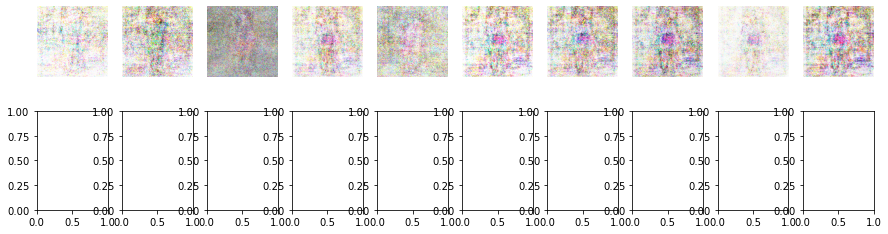

1/1 [==============================] - 0s 34ms/step
9001/10000 [D loss: 323375.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9002/10000 [D loss: 334444.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9003/10000 [D loss: 309028.28125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9004/10000 [D loss: 282237.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
9005/10000 [D loss: 274346.90625 | D accuracy: 50.0] [G loss: 23497.98046875]
1/1 [==============================] - 0s 43ms/step
9006/10000 [D loss: 260173.546875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9007/10000 [D loss: 188817.171875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9008/10000 [D loss: 207555.09375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0

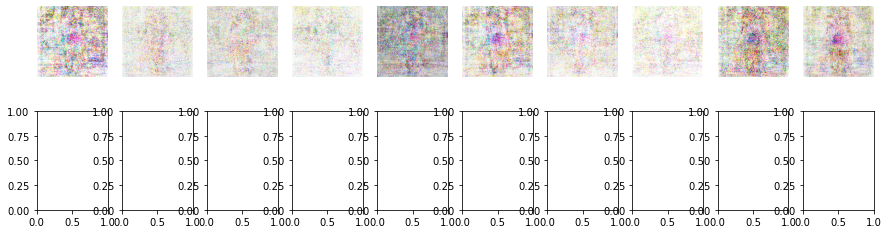

1/1 [==============================] - 0s 31ms/step
9051/10000 [D loss: 401114.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9052/10000 [D loss: 303197.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
9053/10000 [D loss: 385508.46875 | D accuracy: 50.0] [G loss: 1837.518310546875]
1/1 [==============================] - 0s 34ms/step
9054/10000 [D loss: 347839.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9055/10000 [D loss: 336496.90625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9056/10000 [D loss: 333260.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9057/10000 [D loss: 261729.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9058/10000 [D loss: 216601.328125 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 40m

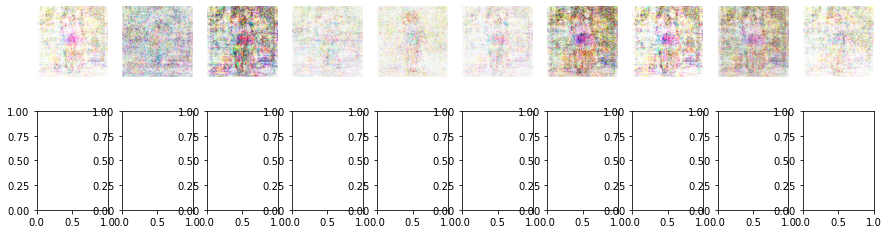

1/1 [==============================] - 0s 33ms/step
9101/10000 [D loss: 210437.71875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9102/10000 [D loss: 182025.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9103/10000 [D loss: 191776.78125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9104/10000 [D loss: 169042.578125 | D accuracy: 50.0] [G loss: 7312.49169921875]
1/1 [==============================] - 0s 36ms/step
9105/10000 [D loss: 150955.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9106/10000 [D loss: 130737.4296875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9107/10000 [D loss: 103440.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
9108/10000 [D loss: 113563.65625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================]

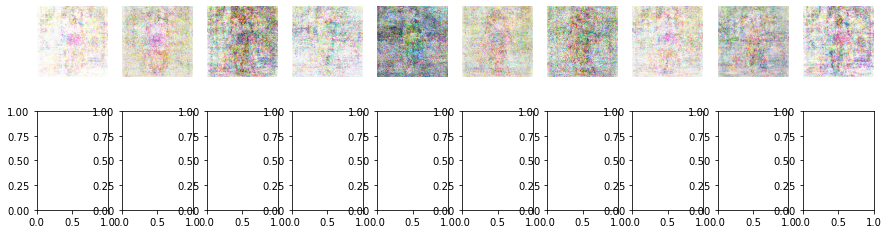

1/1 [==============================] - 0s 70ms/step
9151/10000 [D loss: 97937.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9152/10000 [D loss: 71795.59375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
9153/10000 [D loss: 60557.3984375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9154/10000 [D loss: 39377.140625 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9155/10000 [D loss: 35049.0859375 | D accuracy: 53.125] [G loss: 2948.916748046875]
1/1 [==============================] - 0s 39ms/step
9156/10000 [D loss: 13143.861328125 | D accuracy: 65.625] [G loss: 10773.0234375]
1/1 [==============================] - 0s 33ms/step
9157/10000 [D loss: 4653.09716796875 | D accuracy: 78.125] [G loss: 22318.66796875]
1/1 [==============================] - 0s 38ms/step
9158/10000 [D loss: 1624.449951171875 | D accuracy: 93.75] [G loss

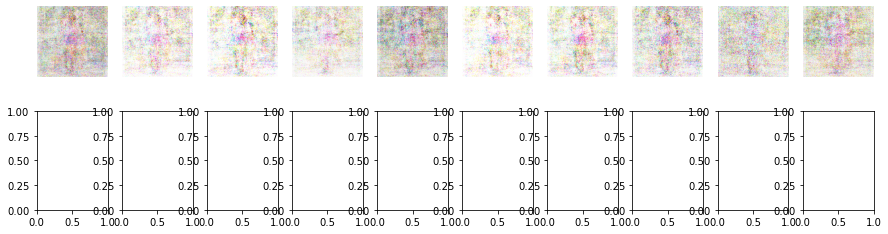

1/1 [==============================] - 0s 34ms/step
9201/10000 [D loss: 179741.078125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9202/10000 [D loss: 155122.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9203/10000 [D loss: 142521.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
9204/10000 [D loss: 112351.8515625 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9205/10000 [D loss: 96741.859375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9206/10000 [D loss: 68487.671875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9207/10000 [D loss: 58432.09375 | D accuracy: 50.0] [G loss: 78.8034439086914]
1/1 [==============================] - 0s 36ms/step
9208/10000 [D loss: 35371.68359375 | D accuracy: 53.125] [G loss: 515.8667602539062]
1/1 [===========

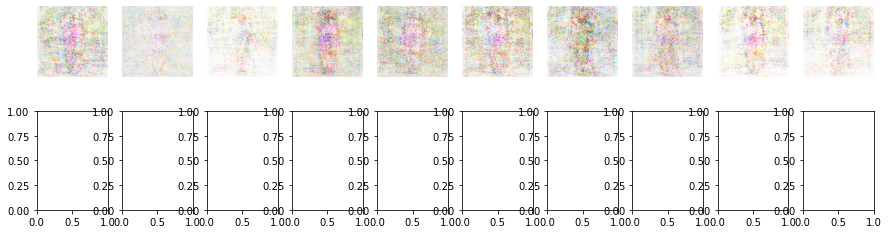

1/1 [==============================] - 0s 34ms/step
9251/10000 [D loss: 1105142.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9252/10000 [D loss: 1104659.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9253/10000 [D loss: 1177601.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9254/10000 [D loss: 1083305.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9255/10000 [D loss: 1099639.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9256/10000 [D loss: 1093140.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9257/10000 [D loss: 1032494.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9258/10000 [D loss: 969973.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9259/10000 [D 

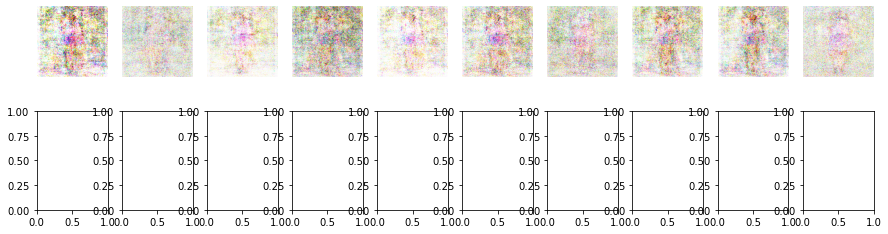

1/1 [==============================] - 0s 33ms/step
9301/10000 [D loss: 56546.3515625 | D accuracy: 50.0] [G loss: 1086.9949951171875]
1/1 [==============================] - 0s 38ms/step
9302/10000 [D loss: 49150.02734375 | D accuracy: 56.25] [G loss: 3289.9365234375]
1/1 [==============================] - 0s 41ms/step
9303/10000 [D loss: 24672.32421875 | D accuracy: 62.5] [G loss: 13618.294921875]
1/1 [==============================] - 0s 37ms/step
9304/10000 [D loss: 28640.650390625 | D accuracy: 59.375] [G loss: 28494.14453125]
1/1 [==============================] - 0s 42ms/step
9305/10000 [D loss: 4390.68359375 | D accuracy: 84.375] [G loss: 42243.640625]
1/1 [==============================] - 0s 40ms/step
9306/10000 [D loss: 1881.8062744140625 | D accuracy: 87.5] [G loss: 54404.13671875]
1/1 [==============================] - 0s 43ms/step
9307/10000 [D loss: 315532.8515625 | D accuracy: 43.75] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9308/10000 [D loss: 37

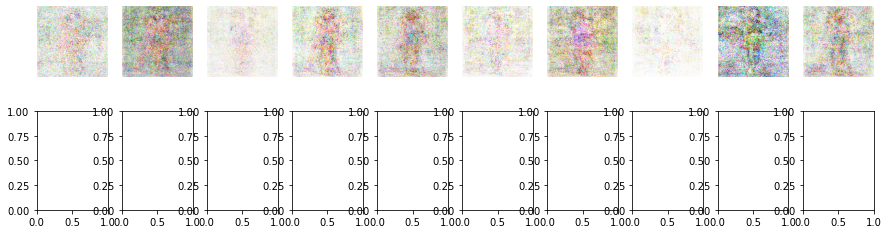

1/1 [==============================] - 0s 37ms/step
9351/10000 [D loss: 746118.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9352/10000 [D loss: 659185.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9353/10000 [D loss: 698537.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9354/10000 [D loss: 690219.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9355/10000 [D loss: 669353.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9356/10000 [D loss: 609144.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
9357/10000 [D loss: 661156.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9358/10000 [D loss: 679208.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
9359/10000 [D 

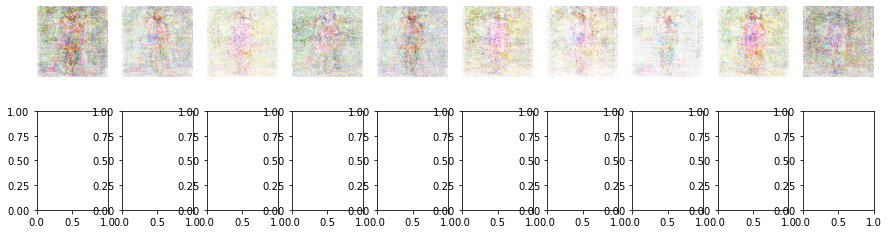

1/1 [==============================] - 0s 31ms/step
9401/10000 [D loss: 3011452.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9402/10000 [D loss: 2928149.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 64ms/step
9403/10000 [D loss: 3059452.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9404/10000 [D loss: 3082540.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9405/10000 [D loss: 2809345.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9406/10000 [D loss: 2999997.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9407/10000 [D loss: 3010911.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9408/10000 [D loss: 2919618.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9409/10000 [D loss

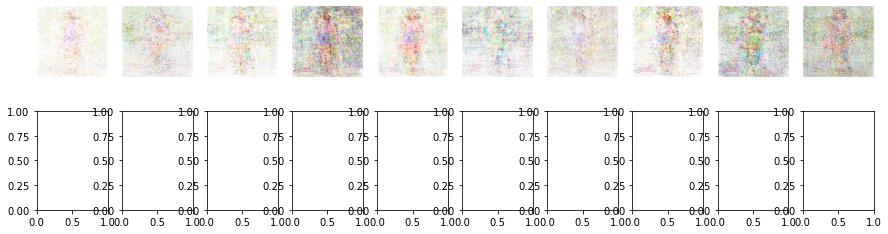

1/1 [==============================] - 0s 33ms/step
9451/10000 [D loss: 2172267.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9452/10000 [D loss: 1886724.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
9453/10000 [D loss: 1938344.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9454/10000 [D loss: 1944326.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 44ms/step
9455/10000 [D loss: 1863032.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9456/10000 [D loss: 1909821.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 31ms/step
9457/10000 [D loss: 1801629.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
9458/10000 [D loss: 1797052.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9459/10000 [D 

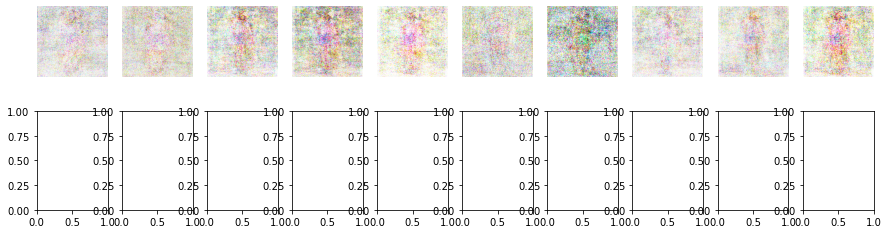

1/1 [==============================] - 0s 34ms/step
9501/10000 [D loss: 11286.2568359375 | D accuracy: 78.125] [G loss: 90035.859375]
1/1 [==============================] - 0s 41ms/step
9502/10000 [D loss: 683145.21875 | D accuracy: 37.5] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
9503/10000 [D loss: 731947.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9504/10000 [D loss: 870282.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9505/10000 [D loss: 765405.3125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 52ms/step
9506/10000 [D loss: 823203.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9507/10000 [D loss: 741897.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9508/10000 [D loss: 752429.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38m

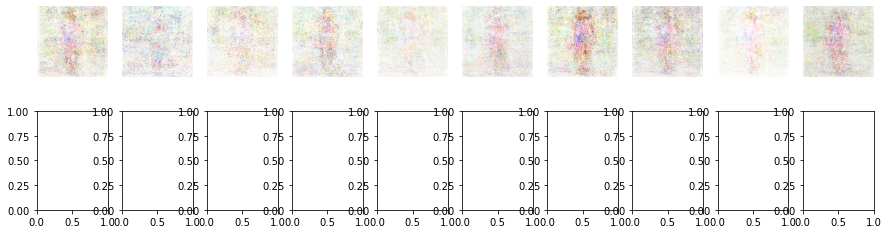

1/1 [==============================] - 0s 35ms/step
9551/10000 [D loss: 516324.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 54ms/step
9552/10000 [D loss: 458133.46875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 65ms/step
9553/10000 [D loss: 430086.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9554/10000 [D loss: 380930.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9555/10000 [D loss: 369754.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
9556/10000 [D loss: 355918.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9557/10000 [D loss: 302795.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9558/10000 [D loss: 300550.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9559/1

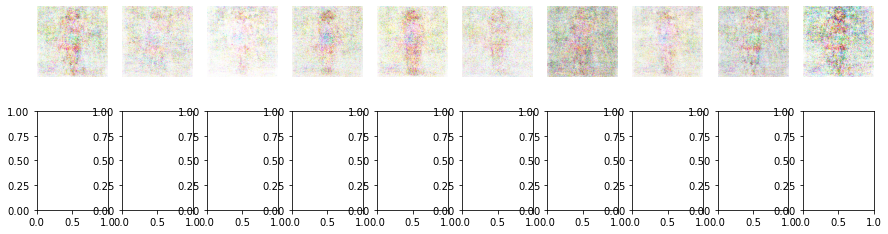

1/1 [==============================] - 0s 37ms/step
9601/10000 [D loss: 798943.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9602/10000 [D loss: 742852.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
9603/10000 [D loss: 697696.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9604/10000 [D loss: 632417.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9605/10000 [D loss: 635854.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 47ms/step
9606/10000 [D loss: 603173.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9607/10000 [D loss: 586908.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9608/10000 [D loss: 602250.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 32ms/step
9609/10000 [D loss: 57

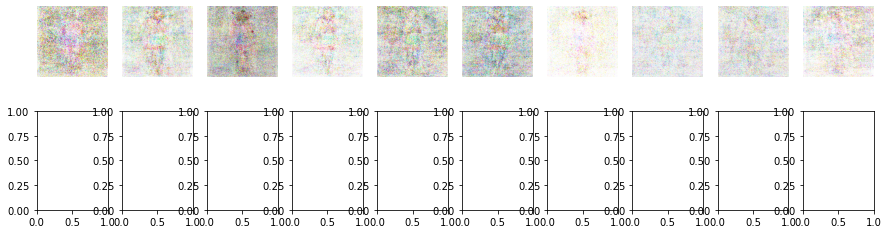

1/1 [==============================] - 0s 35ms/step
9651/10000 [D loss: 501688.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9652/10000 [D loss: 424883.375 | D accuracy: 53.125] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9653/10000 [D loss: 448589.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9654/10000 [D loss: 418792.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 46ms/step
9655/10000 [D loss: 381786.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9656/10000 [D loss: 352456.03125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9657/10000 [D loss: 305736.84375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9658/10000 [D loss: 279882.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
96

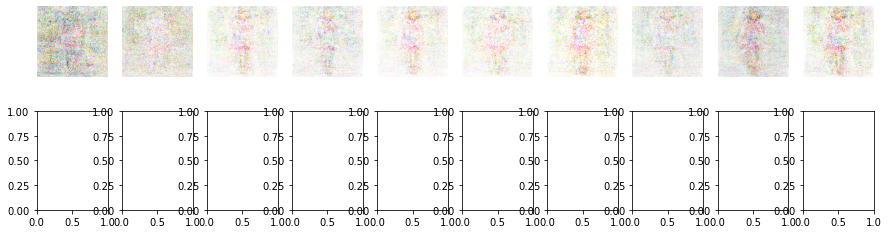

1/1 [==============================] - 0s 45ms/step
9701/10000 [D loss: 2390057.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9702/10000 [D loss: 2426247.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9703/10000 [D loss: 2430220.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9704/10000 [D loss: 2322406.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9705/10000 [D loss: 2190859.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
9706/10000 [D loss: 2397307.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
9707/10000 [D loss: 2353223.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
9708/10000 [D loss: 2102767.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 42ms/step
9709/10000 [D los

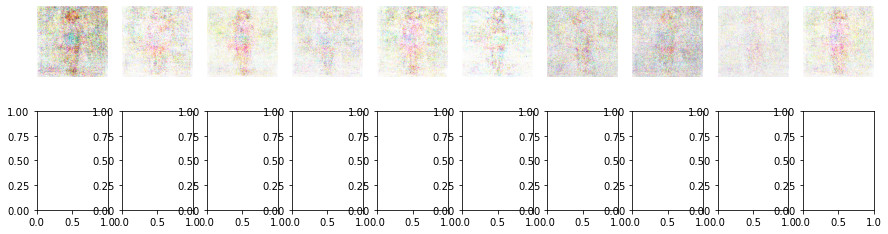

1/1 [==============================] - 0s 40ms/step
9751/10000 [D loss: 183975.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9752/10000 [D loss: 92535.9453125 | D accuracy: 50.0] [G loss: 847.31640625]
1/1 [==============================] - 0s 46ms/step
9753/10000 [D loss: 31987.802734375 | D accuracy: 56.25] [G loss: 36894.6328125]
1/1 [==============================] - 0s 39ms/step
9754/10000 [D loss: 527443.65625 | D accuracy: 40.625] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9755/10000 [D loss: 596403.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9756/10000 [D loss: 704359.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9757/10000 [D loss: 618627.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9758/10000 [D loss: 633064.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================

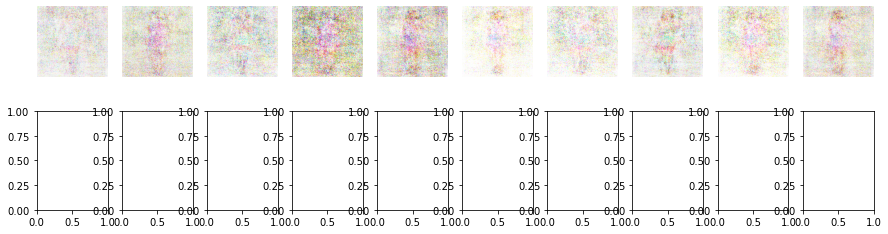

1/1 [==============================] - 0s 33ms/step
9801/10000 [D loss: 1008389.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9802/10000 [D loss: 994122.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9803/10000 [D loss: 1018678.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9804/10000 [D loss: 976674.0625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9805/10000 [D loss: 851318.4375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 52ms/step
9806/10000 [D loss: 947474.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9807/10000 [D loss: 837753.5625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9808/10000 [D loss: 832385.375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 48ms/step
9809/10

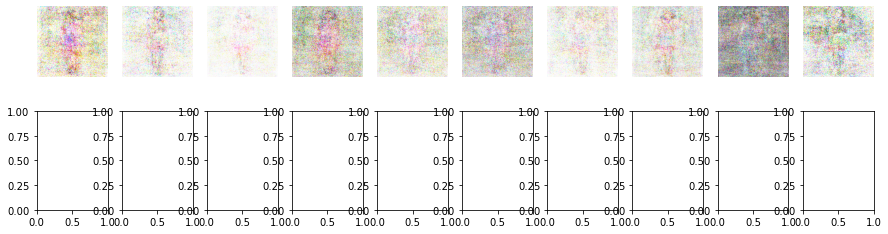

1/1 [==============================] - 0s 33ms/step
9851/10000 [D loss: 2591176.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 45ms/step
9852/10000 [D loss: 2642373.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9853/10000 [D loss: 2330804.25 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9854/10000 [D loss: 2682093.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9855/10000 [D loss: 2563878.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 43ms/step
9856/10000 [D loss: 2494684.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9857/10000 [D loss: 2462566.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9858/10000 [D loss: 2501907.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9859/10000 [D los

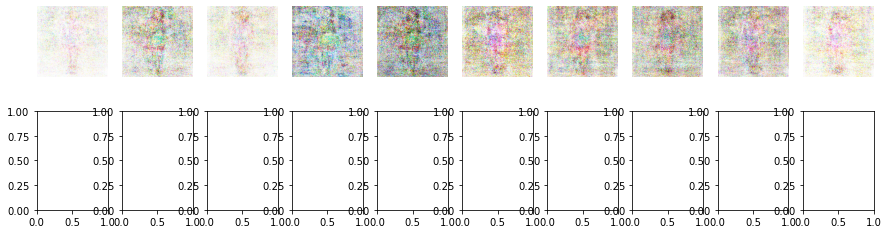

1/1 [==============================] - 0s 35ms/step
9901/10000 [D loss: 982443.125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9902/10000 [D loss: 1116340.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9903/10000 [D loss: 1029900.6875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 41ms/step
9904/10000 [D loss: 987129.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9905/10000 [D loss: 887741.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 39ms/step
9906/10000 [D loss: 853133.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 38ms/step
9907/10000 [D loss: 834896.875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9908/10000 [D loss: 812630.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
9909/10000 [D 

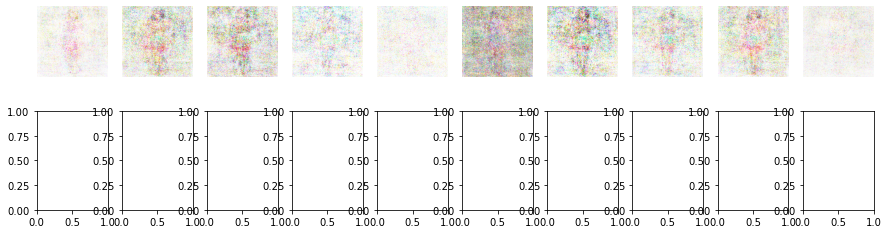

1/1 [==============================] - 0s 33ms/step
9951/10000 [D loss: 427474.9375 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 35ms/step
9952/10000 [D loss: 424226.75 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 33ms/step
9953/10000 [D loss: 391635.625 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9954/10000 [D loss: 343029.0 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 48ms/step
9955/10000 [D loss: 273429.5 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 37ms/step
9956/10000 [D loss: 271547.1875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 34ms/step
9957/10000 [D loss: 253439.96875 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 40ms/step
9958/10000 [D loss: 224064.8125 | D accuracy: 50.0] [G loss: 0.0]
1/1 [==============================] - 0s 36ms/step
9959/10000 [

In [48]:
latent_dim = 100
img_shape = (224, 224, 3)
save_interval = 50  # Save generated images every 50 epochs

# Build and compile the discriminator
discriminator = build_discriminator(img_shape)
discriminator.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5), metrics=['accuracy'])

# Build and compile the generator
generator = build_gan(latent_dim, img_shape)

# Build and compile the GAN model
gan_model = build_gan_model(generator, discriminator)

train_gan(generator, discriminator, gan_model, X_train, epochs=10000, batch_size=32, latent_dim=100)



#### GAN model Observations: 

Epochs 80-89:

Discriminator loss fluctuates, but there's a general trend of improvement.
Discriminator accuracy shows variability but generally improves.
Generator loss fluctuates, and there's some variability.

Epochs 90-99:

Discriminator loss continues to improve.
Discriminator accuracy remains somewhat stable.
Generator loss shows variability.

Epochs 1000-1200:
Here D loss being high shows that the discriminator is able to discriminate between fake and real
G loss being low shows that is is fooling discriminator

Epochs 9k - 10k: 
The generator loss remains at 0 which suggests that the generator has collapsed and is not effectively learning to produce diverse and realistic data. also known as mode collapse

### Result Summary : 

In the initial stages of object detection, a simple model was implemented, followed by an attempt to improve performance through data augmentation. The simple model demonstrated suboptimal results, prompting further exploration. Subsequently, data augmentation techniques were applied to enhance the model's ability to detect objects, aiming to address limitations observed in the initial implementation. However, challenges persisted, leading to the decision to explore other object detection models. YOLOv8 was then introduced to potentially overcome the limitations of the earlier attempts. The adoption of YOLOv8 marked a pivotal shift in the approach, as more advanced architectures were leveraged to address the complexities of object detection.

Additionally, a GAN was employed to generate synthetic images for further training. Despite an extensive training duration of 12,000 epochs, the model continued to show signs of improvement visually, indicating the potential of GANs for image synthesis though the G loss shows a mode collapse , which means that the generator has failed to produce real images explaining that the model still continue to train the data and build images though it may not be new. This iterative learning process demonstrated the adaptability of GANs to learn and generate images effectively over an extended training period.

In parallel, a recommendation model utilizing ResNet-50 was explored to diversify the learning tasks on the dataset. The intention was to assess the dataset's suitability for recommendation purposes beyond its primary goal of object detection. The success of the recommendation model, as evidenced by visually relevant suggestions, highlighted the versatility of the dataset and suggested potential applications beyond its original intent.

In summary, the initial trials involved simple object detection models, data augmentation strategies, GANs for image synthesis, and recommendation models, each contributing insights into the dataset's characteristics. While object detection posed challenges that led to the exploration of advanced models like YOLOv8, the GAN's continuous improvement indicated its ability to learn over prolonged training periods. The successful implementation of the recommendation model hinted at the dataset's adaptability for diverse machine learning tasks. These insights informed subsequent decisions in the development of the object detection model and underscored the multi-faceted nature of the dataset.